In [172]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from tqdm import tqdm

# Part 1.

## a. Plot the number of assets per date. Propose a criterion to accommodate a changing estimation universe.

In [83]:
data = pd.read_csv('./return_data/return_data.csv') # Get data
data

,ID,date,Total Return,Specific Risk,20-Day ADV,Growth,Volatility,Profitability,Dividend Yield,Value,Market Sensitivity,Medium-Term Momentum,Short-Term Momentum,Liquidity
0,11JMZFSN8,1998-01-02,-0.060465,62.171901,7467336,0.610272,1.483404,-3.348269,-1.044360,-0.796163,0.742236,1.132275,-1.366586,1.432084
1,11JS8VT41,1998-01-02,0.000000,37.705799,4636298,1.044603,0.719389,0.154666,-1.044360,-0.074093,-0.014233,1.132102,-0.475880,0.305234
2,11NSZA7T1,1998-01-02,-0.003540,38.329513,3920738,-0.110977,1.101480,-0.405215,-1.044360,-3.246199,-0.743466,-0.328041,-1.200089,0.640464
3,122JHRL77,1998-01-02,-0.011834,25.069789,65048,-0.156014,-0.531706,-0.169127,0.406568,1.168001,-0.377473,1.274657,-0.091079,-0.118637
4,12ULRB8M7,1998-01-02,0.012552,41.183064,1436133,0.923330,0.358930,-0.023051,-1.044360,0.564086,0.025626,-1.219872,-1.785396,-0.688678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18381599,ZYXYGJCY3,2019-12-31,-0.015758,166.303574,10124852,-2.046142,2.996333,-0.616305,-0.942538,0.954226,0.767205,3.420121,3.115326,2.622284
18381600,ZZ7THZB57,2019-12-31,0.018638,33.678975,10894864,1.800591,1.286118,-0.054965,-0.942538,-0.077686,-0.611773,2.079759,-0.467566,0.158633
18381601,ZZGLFY5L1,2019-12-31,0.004741,20.974952,23597443,1.093999,0.238477,-0.165137,-0.942538,0.052426,-0.065982,0.123699,0.186605,0.111517
18381602,ZZLRFTLR2,2019-12-31,0.004132,37.184045,2789139,-0.230301,0.786284,0.854458,4.389285,-1.649364,-0.619812,-0.420335,0.831355,-0.019192


In [84]:
data.isna().sum().sum()

0

In [3]:
dg = data.groupby('date') # Groupby date
for name, group in dg:
    print(name)
    print(group)

1998-01-02
             ID        date  Total Return  Specific Risk  20-Day ADV  \
0     11JMZFSN8  1998-01-02     -0.060465      62.171901     7467336   
1     11JS8VT41  1998-01-02      0.000000      37.705799     4636298   
2     11NSZA7T1  1998-01-02     -0.003540      38.329513     3920738   
3     122JHRL77  1998-01-02     -0.011834      25.069789       65048   
4     12ULRB8M7  1998-01-02      0.012552      41.183064     1436133   
...         ...         ...           ...            ...         ...   
3510  ZYFLZYN90  1998-01-02      0.004622      15.525494    31010079   
3511  ZZ7THZB57  1998-01-02     -0.025000      24.789560      288542   
3512  ZZBU8DRU6  1998-01-02      0.000000      34.852945     1621232   
3513  ZZMDRZP34  1998-01-02     -0.030120      43.878463     3088570   
3514  ZZVQRQKD8  1998-01-02      0.027778      51.068579      774346   

        Growth  Volatility  Profitability  Dividend Yield     Value  \
0     0.610272    1.483404      -3.348269       -1.04

              ID        date  Total Return  Specific Risk  20-Day ADV  \
94792  11JMZFSN8  1998-02-11     -0.002577      66.136422    10998150   
94793  11JS8VT41  1998-02-11      0.014815      36.655949     6086194   
94794  11NSZA7T1  1998-02-11     -0.010511      37.937487     5273129   
94795  122JHRL77  1998-02-11      0.032258      27.371916      200260   
94796  12ULRB8M7  1998-02-11     -0.020270      42.371317      967720   
...          ...         ...           ...            ...         ...   
98291  ZYFLZYN90  1998-02-11     -0.004695      14.148946    23680126   
98292  ZZ7THZB57  1998-02-11      0.042463      24.610473      565526   
98293  ZZBU8DRU6  1998-02-11     -0.073034      47.631890     2254612   
98294  ZZMDRZP34  1998-02-11     -0.043189      44.497231      936370   
98295  ZZVQRQKD8  1998-02-11     -0.012821      45.434976      502596   

         Growth  Volatility  Profitability  Dividend Yield     Value  \
94792  0.828014    1.629836      -3.405638       -1

               ID        date  Total Return  Specific Risk  20-Day ADV  \
189231  11JMZFSN8  1998-03-23      0.001923      65.300850     9176393   
189232  11JS8VT41  1998-03-23      0.020161      37.985879     7401627   
189233  11NSZA7T1  1998-03-23     -0.020531      36.056966     3561072   
189234  122JHRL77  1998-03-23      0.008503      24.703324       83116   
189235  12ULRB8M7  1998-03-23     -0.015823      38.060458      798810   
...           ...         ...           ...            ...         ...   
192740  ZYFLZYN90  1998-03-23     -0.010294      12.507297    21472347   
192741  ZZ7THZB57  1998-03-23     -0.012048      21.967580      310625   
192742  ZZBU8DRU6  1998-03-23     -0.054545      45.788435     1706603   
192743  ZZMDRZP34  1998-03-23      0.090909      46.804367     1572698   
192744  ZZVQRQKD8  1998-03-23     -0.021505      44.267484     1255842   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
189231  0.593007    1.463082      -3.4

               ID        date  Total Return  Specific Risk  20-Day ADV  \
266317  11JMZFSN8  1998-04-23      0.076453      66.805774    10650612   
266318  11JS8VT41  1998-04-23     -0.015444      37.398081     4708160   
266319  11NSZA7T1  1998-04-23     -0.013699      33.093728     3706974   
266320  122JHRL77  1998-04-23     -0.030000      23.652268       66079   
266321  12ULRB8M7  1998-04-23      0.028846      41.299526      601912   
...           ...         ...           ...            ...         ...   
269811  ZYFLZYN90  1998-04-23     -0.025352      12.895435    28576099   
269812  ZZ7THZB57  1998-04-23     -0.015873      20.268652      453348   
269813  ZZBU8DRU6  1998-04-23     -0.038703      45.738437     1693145   
269814  ZZMDRZP34  1998-04-23     -0.011765      44.964085     1169531   
269815  ZZVQRQKD8  1998-04-23      0.004739      40.894275     1694708   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
266317  0.604736    1.005935      -3.4

               ID        date  Total Return  Specific Risk  20-Day ADV  \
465227  11JMZFSN8  1998-07-15     -0.007576      64.293839     7820970   
465228  11JS8VT41  1998-07-15     -0.018692      35.645448     8439958   
465229  11NSZA7T1  1998-07-15      0.026570      27.786474     2511977   
465230  122JHRL77  1998-07-15      0.013825      24.192666     1295926   
465231  12ULRB8M7  1998-07-15     -0.030189      44.898693     1144384   
...           ...         ...           ...            ...         ...   
468692  ZZ7JZ4A75  1998-07-15     -0.019737      28.410072      614368   
468693  ZZ7THZB57  1998-07-15      0.001876      21.602327      394154   
468694  ZZBU8DRU6  1998-07-15      0.000000      34.531407    13667189   
468695  ZZMDRZP34  1998-07-15      0.051643      39.580761     4254281   
468696  ZZVQRQKD8  1998-07-15      0.008621      44.828637     1905861   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
465227  0.687955    2.217116      -3.5

               ID        date  Total Return  Specific Risk  20-Day ADV  \
600491  11JMZFSN8  1998-09-09     -0.102041      65.665307     4081469   
600492  11JS8VT41  1998-09-09     -0.067029      41.973346     6923010   
600493  11NSZA7T1  1998-09-09     -0.089623      32.872070     3837730   
600494  122JHRL77  1998-09-09     -0.014737      25.008167      251770   
600495  12ULRB8M7  1998-09-09     -0.138614      48.793579      896672   
...           ...         ...           ...            ...         ...   
603958  ZYFLZYN90  1998-09-09     -0.013199      13.958703    40998898   
603959  ZZ7JZ4A75  1998-09-09      0.025346      34.351051      750564   
603960  ZZ7THZB57  1998-09-09      0.014286      25.397754      972869   
603961  ZZMDRZP34  1998-09-09     -0.070513      49.643119     5681652   
603962  ZZVQRQKD8  1998-09-09     -0.044944      47.754639      898599   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
600491  0.874188    1.050564      -3.4

               ID        date  Total Return  Specific Risk  20-Day ADV  \
701362  11JMZFSN8  1998-10-20      0.068182      67.677603     1784677   
701363  11JS8VT41  1998-10-20      0.015203      49.427373     4987788   
701364  11NSZA7T1  1998-10-20      0.063670      60.146059     7283638   
701365  122JHRL77  1998-10-20      0.080899      34.837872      278618   
701366  12ULRB8M7  1998-10-20      0.035714      63.812969      870051   
...           ...         ...           ...            ...         ...   
704846  ZYFLZYN90  1998-10-20     -0.006993      20.127356    54150794   
704847  ZZ7JZ4A75  1998-10-20      0.029545      37.611151      448589   
704848  ZZ7THZB57  1998-10-20      0.018605      30.988104      712672   
704849  ZZMDRZP34  1998-10-20     -0.045977      49.600561     4494094   
704850  ZZVQRQKD8  1998-10-20      0.036145      51.882142      662993   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
701362  0.871754    1.362481      -3.4

               ID        date  Total Return  Specific Risk  20-Day ADV  \
809964  11JMZFSN8  1998-12-03     -0.018868      75.406692     3460718   
809965  11JS8VT41  1998-12-03     -0.013636      49.184315     7626630   
809966  11NSZA7T1  1998-12-03     -0.009868      61.178272     2765774   
809967  122JHRL77  1998-12-03     -0.021401      33.614459       81910   
809968  12ULRB8M7  1998-12-03     -0.011364      56.976294     1026159   
...           ...         ...           ...            ...         ...   
813469  ZYFLZYN90  1998-12-03     -0.017668      20.652734    35454686   
813470  ZZ7JZ4A75  1998-12-03      0.009311      37.219223      387242   
813471  ZZ7THZB57  1998-12-03     -0.007828      33.380179      342203   
813472  ZZMDRZP34  1998-12-03     -0.053435      46.135779     4880517   
813473  ZZVQRQKD8  1998-12-03      0.005076      48.579626      814724   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
809964  0.651318    1.039334      -3.4

               ID        date  Total Return  Specific Risk  20-Day ADV  \
919233  11JMZFSN8  1999-01-20     -0.048673      81.835745     2918917   
919234  11JS8VT41  1999-01-20     -0.008529      50.565392    10240475   
919235  11NSZA7T1  1999-01-20     -0.025000      62.200285     2469997   
919236  122JHRL77  1999-01-20     -0.004545      31.826356       20605   
919237  12ULRB8M7  1999-01-20      0.043062      55.734770      603004   
...           ...         ...           ...            ...         ...   
922765  ZYFLZYN90  1999-01-20     -0.012213      20.456574    32253578   
922766  ZZ7JZ4A75  1999-01-20      0.008065      34.225564      499510   
922767  ZZ7THZB57  1999-01-20      0.001942      29.600893      374528   
922768  ZZMDRZP34  1999-01-20     -0.086331      45.134601     3930186   
922769  ZZVQRQKD8  1999-01-20      0.025862      45.167515      979366   

          Growth  Volatility  Profitability  Dividend Yield     Value  \
919233  0.582105    1.005267      -3.3

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1025255  11JMZFSN8  1999-03-04 -4.761905e-03      73.982074     1640094   
1025256  11JS8VT41  1999-03-04  1.351351e-02      48.516502     4476191   
1025257  11NSZA7T1  1999-03-04  2.025532e-08      56.352080     1682238   
1025258  122JHRL77  1999-03-04 -2.785515e-03      30.390824       36049   
1025259  12ULRB8M7  1999-03-04  0.000000e+00      53.284809      300897   
...            ...         ...           ...            ...         ...   
1028780  ZYFLZYN90  1999-03-04  3.747245e-02      20.270855    33248166   
1028781  ZZ7JZ4A75  1999-03-04  2.192982e-03      31.995407      428196   
1028782  ZZ7THZB57  1999-03-04 -8.528785e-03      26.573328      227160   
1028783  ZZMDRZP34  1999-03-04  7.547170e-02      40.924005     2851565   
1028784  ZZVQRQKD8  1999-03-04 -1.310044e-02      41.821878     1833141   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1025255  0.618103    1.43

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1120379  11D7GQAK9  1999-04-13      0.003676      35.375595     2655023   
1120380  11JMZFSN8  1999-04-13     -0.015707      66.186721     1748255   
1120381  11JS8VT41  1999-04-13      0.118384      53.202484     4741425   
1120382  11NSZA7T1  1999-04-13      0.005168      90.195993    17171510   
1120383  122JHRL77  1999-04-13      0.090047      38.037572       84163   
...            ...         ...           ...            ...         ...   
1123883  ZYFLZYN90  1999-04-13     -0.007273      18.793966    32061651   
1123884  ZZ7JZ4A75  1999-04-13     -0.023256      28.693578      415262   
1123885  ZZ7THZB57  1999-04-13      0.000000      29.079868      467661   
1123886  ZZMDRZP34  1999-04-13      0.029586      45.767456     4098225   
1123887  ZZVQRQKD8  1999-04-13      0.309091      56.997736     2316634   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1120379  0.047267   -0.57

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1253901  11D7GQAK9  1999-06-07     -0.004425      43.128226     3179627   
1253902  11JMZFSN8  1999-06-07      0.029940      63.350615     2144241   
1253903  11JS8VT41  1999-06-07      0.015909      46.605491     2852851   
1253904  11NSZA7T1  1999-06-07      0.147982      88.509724     9818235   
1253905  122JHRL77  1999-06-07      0.042593      36.437694      156781   
...            ...         ...           ...            ...         ...   
1257418  ZYFLZYN90  1999-06-07      0.011561      17.181906    30840181   
1257419  ZZ7JZ4A75  1999-06-07     -0.002008      26.515633      676456   
1257420  ZZ7THZB57  1999-06-07     -0.004098      28.957678      363912   
1257421  ZZMDRZP34  1999-06-07      0.079208      62.548807     5000264   
1257422  ZZVQRQKD8  1999-06-07      0.000000      54.665323     6338245   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1253901  0.049538    0.37

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1383513  11D7GQAK9  1999-07-29     -0.030702      43.215773      394193   
1383514  11JS8VT41  1999-07-29     -0.035052      42.313872     5597438   
1383515  11NSZA7T1  1999-07-29     -0.030120      80.199516     6386111   
1383516  122JHRL77  1999-07-29      0.011673      31.424888       39088   
1383517  126DYQZF6  1999-07-29     -0.005254     110.769726    26270882   
...            ...         ...           ...            ...         ...   
1386999  ZYFLZYN90  1999-07-29     -0.007770      15.503080    28613764   
1387000  ZZ7JZ4A75  1999-07-29      0.011111      30.188625     1264121   
1387001  ZZ7THZB57  1999-07-29     -0.010204      26.738965      221643   
1387002  ZZMDRZP34  1999-07-29      0.038462      57.875929     6044560   
1387003  ZZVQRQKD8  1999-07-29      0.050746      55.359770     4317345   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1383513  0.049056    0.87

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1477673  11D7GQAK9  1999-09-07      0.041860      41.962042      306600   
1477674  11JS8VT41  1999-09-07     -0.040816      41.042112     5041458   
1477675  11NSZA7T1  1999-09-07      0.009317      77.697434     3185213   
1477676  122JHRL77  1999-09-07     -0.008333      31.362330       94912   
1477677  126DYQZF6  1999-09-07     -0.062069     103.460031     4028012   
...            ...         ...           ...            ...         ...   
1481166  ZYFLZYN90  1999-09-07     -0.016858      14.443049    31523895   
1481167  ZZ7JZ4A75  1999-09-07      0.040590      28.880267      730938   
1481168  ZZ7THZB57  1999-09-07      0.006726      24.756928      203770   
1481169  ZZMDRZP34  1999-09-07      0.072000      51.336091     4393660   
1481170  ZZVQRQKD8  1999-09-07      0.086420      53.136823     1322988   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1477673  0.051110    0.57

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1569038  11D7GQAK9  1999-10-13     -0.023148      40.113314      525818   
1569039  11JS8VT41  1999-10-13      0.000000      38.890644     3138062   
1569040  11NSZA7T1  1999-10-13     -0.046784     112.851053    12189608   
1569041  122JHRL77  1999-10-13      0.000000      28.573866       32751   
1569042  126DYQZF6  1999-10-13      0.124088      98.866516     4826840   
...            ...         ...           ...            ...         ...   
1572542  ZYFLZYN90  1999-10-13     -0.016166      13.214833    31596390   
1572543  ZZ7JZ4A75  1999-10-13      0.009191      25.396051      761792   
1572544  ZZ7THZB57  1999-10-13     -0.022167      25.942459      244112   
1572545  ZZMDRZP34  1999-10-13      0.004386      47.930801     7547746   
1572546  ZZVQRQKD8  1999-10-13     -0.005714      45.909626      849495   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1569038  0.020662   -0.07

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1657060  11D7GQAK9  1999-11-17     -0.063830      58.113593     1342010   
1657061  11JS8VT41  1999-11-17      0.005391      36.239046     2957693   
1657062  11NSZA7T1  1999-11-17     -0.012270     101.278935     2778819   
1657063  122JHRL77  1999-11-17      0.008097      28.414768       83948   
1657064  126DYQZF6  1999-11-17     -0.094488     115.958770     9558089   
...            ...         ...           ...            ...         ...   
1660583  ZYFLZYN90  1999-11-17     -0.002978      13.993776    43546047   
1660584  ZZ7JZ4A75  1999-11-17      0.003040      27.757954     2666867   
1660585  ZZ7THZB57  1999-11-17      0.025000      26.167567      413071   
1660586  ZZMDRZP34  1999-11-17      0.041237      44.885661     6945589   
1660587  ZZVQRQKD8  1999-11-17      0.028302      48.208409     1992507   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1657060  0.007729    1.09

1999-12-31
                ID        date  Total Return  Specific Risk  20-Day ADV  \
1763211  11D7GQAK9  1999-12-31     -0.017699      57.182079      968439   
1763212  11JS8VT41  1999-12-31      0.005236      37.518234     3352255   
1763213  11NSZA7T1  1999-12-31     -0.023077      87.900456     2323257   
1763214  122JHRL77  1999-12-31     -0.007042      33.220990       77328   
1763215  126DYQZF6  1999-12-31      0.068303     110.935532     7736343   
...            ...         ...           ...            ...         ...   
1766780  ZYFLZYN90  1999-12-31      0.002765      14.742222    31902130   
1766781  ZZ7JZ4A75  1999-12-31     -0.012950      29.240582     2523342   
1766782  ZZ7THZB57  1999-12-31      0.008043      25.366347      468196   
1766783  ZZMDRZP34  1999-12-31      0.049708      42.361706     8348203   
1766784  ZZVQRQKD8  1999-12-31      0.094862      56.450118     1955027   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1763211 -0.110

                ID        date  Total Return  Specific Risk  20-Day ADV  \
1859997  11D7GQAK9  2000-02-09      0.000000      61.850500      173102   
1859998  11JS8VT41  2000-02-09     -0.027586      40.425319     3670589   
1859999  11NSZA7T1  2000-02-09     -0.008197      83.898436     1217887   
1860000  122JHRL77  2000-02-09     -0.045872      32.163648       51276   
1860001  126DYQZF6  2000-02-09     -0.016750     115.116423    16682292   
...            ...         ...           ...            ...         ...   
1863586  ZYFLZYN90  2000-02-09     -0.033469      14.171295    27316070   
1863587  ZZ7JZ4A75  2000-02-09     -0.016369      31.559965     3164548   
1863588  ZZ7THZB57  2000-02-09      0.008197      33.629654      418578   
1863589  ZZMDRZP34  2000-02-09     -0.043771      42.868547    10196399   
1863590  ZZVQRQKD8  2000-02-09      0.008741      55.832673     1654610   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1859997 -0.093870    0.93

2000-03-29
                ID        date  Total Return  Specific Risk  20-Day ADV  \
1983019  11D7GQAK9  2000-03-29      0.009804      59.830187       91919   
1983020  11JS8VT41  2000-03-29      0.017606      41.176651     2984899   
1983021  11NSZA7T1  2000-03-29      0.028169      84.264251     1839550   
1983022  122JHRL77  2000-03-29      0.000000      34.551609       50283   
1983023  126DYQZF6  2000-03-29     -0.078125     107.510674    14390733   
...            ...         ...           ...            ...         ...   
1986649  ZYAARP6N5  2000-03-29     -0.012225      39.055561   263423725   
1986650  ZYFLZYN90  2000-03-29      0.000931      15.668773    34325268   
1986651  ZZ7JZ4A75  2000-03-29      0.002303      32.471072     2421569   
1986652  ZZMDRZP34  2000-03-29      0.060976      42.965285    11975317   
1986653  ZZVQRQKD8  2000-03-29      0.033557      59.588625     1190102   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
1983019 -0.490

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2109867  11D7GQAK9  2000-05-18     -0.031447      67.425975      282125   
2109868  11JS8VT41  2000-05-18     -0.020349      45.162299     2275254   
2109869  11NSZA7T1  2000-05-18     -0.016529      75.939293      525407   
2109870  122JHRL77  2000-05-18     -0.010256      34.592465       46298   
2109871  126DYQZF6  2000-05-18     -0.051402     110.573060     5418576   
...            ...         ...           ...            ...         ...   
2113480  ZYAARP6N5  2000-05-18     -0.020622      41.564350   217330601   
2113481  ZYFLZYN90  2000-05-18      0.024728      16.704782    28133752   
2113482  ZZ7JZ4A75  2000-05-18      0.014589      33.541821     3788519   
2113483  ZZMDRZP34  2000-05-18     -0.054217      41.143681     9629326   
2113484  ZZVQRQKD8  2000-05-18     -0.007143      66.269844     6543897   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2109867 -0.463681    0.42

2000-06-29
                ID        date  Total Return  Specific Risk  20-Day ADV  \
2214485  11D7GQAK9  2000-06-29      0.067901      60.589095      346387   
2214486  11JS8VT41  2000-06-29     -0.012821      46.475539     3711027   
2214487  11NSZA7T1  2000-06-29      0.052632      71.046676      511722   
2214488  122JHRL77  2000-06-29      0.000000      33.418635       47545   
2214489  126DYQZF6  2000-06-29     -0.056586     120.119822    12150408   
...            ...         ...           ...            ...         ...   
2218072  ZYAARP6N5  2000-06-29     -0.007737      50.781890   223459100   
2218073  ZYFLZYN90  2000-06-29     -0.017391      19.892095    58730904   
2218074  ZZ7JZ4A75  2000-06-29      0.067919      40.575496     3850023   
2218075  ZZMDRZP34  2000-06-29      0.040000      41.502916    12092875   
2218076  ZZVQRQKD8  2000-06-29     -0.036585      67.154252     3342856   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2214485 -0.495

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2307148  11D7GQAK9  2000-08-07      0.000000      59.233214      575711   
2307149  11JS8VT41  2000-08-07     -0.011013      41.960247     5153023   
2307150  11NSZA7T1  2000-08-07      0.021053      69.349152      453307   
2307151  122JHRL77  2000-08-07     -0.008475      37.073679       27084   
2307152  126DYQZF6  2000-08-07      0.015337     105.765223     5266842   
...            ...         ...           ...            ...         ...   
2310695  ZYAARP6N5  2000-08-07      0.033451      47.898199   187171185   
2310696  ZYFLZYN90  2000-08-07     -0.017782      18.916445    26713740   
2310697  ZZ7JZ4A75  2000-08-07      0.017462      42.132000     6910007   
2310698  ZZMDRZP34  2000-08-07      0.018686      43.053420    11037082   
2310699  ZZVQRQKD8  2000-08-07      0.018219      64.647417     2811360   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2307148 -0.530984    0.30

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2403487  11D7GQAK9  2000-09-14     -0.033333      54.535636      486787   
2403488  11JMZFSN8  2000-09-14      0.016949      71.102817     2371906   
2403489  11JS8VT41  2000-09-14     -0.010000      41.966858     3192862   
2403490  11NSZA7T1  2000-09-14      0.000000      64.803956      542738   
2403491  122JHRL77  2000-09-14      0.031674      37.830724       56431   
...            ...         ...           ...            ...         ...   
2407063  ZYAARP6N5  2000-09-14     -0.030945      43.800582   135229928   
2407064  ZYFLZYN90  2000-09-14     -0.013800      17.518508    24723116   
2407065  ZZ7JZ4A75  2000-09-14      0.041626      38.191591    18032391   
2407066  ZZMDRZP34  2000-09-14      0.010060      40.544929    13100228   
2407067  ZZVQRQKD8  2000-09-14      0.032362      60.810719     1049242   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2403487 -0.546290    0.95

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2524704  11D7GQAK9  2000-11-01     -0.007874      61.966867      142424   
2524705  11JMZFSN8  2000-11-01     -0.008772      62.236294     1275430   
2524706  11JS8VT41  2000-11-01      0.030501      40.773532     3591393   
2524707  11NSZA7T1  2000-11-01      0.032258      59.014057      324879   
2524708  122JHRL77  2000-11-01     -0.002924      38.397482      105729   
...            ...         ...           ...            ...         ...   
2528255  ZYAARP6N5  2000-11-01     -0.023891      40.821694   197333569   
2528256  ZYFLZYN90  2000-11-01      0.002315      16.478263    35536645   
2528257  ZZ7JZ4A75  2000-11-01     -0.028791      39.969889    19599717   
2528258  ZZMDRZP34  2000-11-01      0.049738      38.739252    11256929   
2528259  ZZVQRQKD8  2000-11-01      0.000000      68.062759     4903175   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2524704 -0.531149    0.87

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2634464  111111118  2000-12-15     -0.032787       8.593361      289222   
2634465  11D7GQAK9  2000-12-15      0.007752      66.154670       72490   
2634466  11JMZFSN8  2000-12-15      0.090909      66.891743     1727397   
2634467  11JS8VT41  2000-12-15      0.011838      40.046382     5414637   
2634468  11NSZA7T1  2000-12-15     -0.013008      89.141139      673236   
...            ...         ...           ...            ...         ...   
2638008  ZYAARP6N5  2000-12-15     -0.001789      43.120939   231005452   
2638009  ZYFLZYN90  2000-12-15     -0.011421      17.807716    35573142   
2638010  ZZ7JZ4A75  2000-12-15      0.003670      40.146863    12737095   
2638011  ZZMDRZP34  2000-12-15      0.016575      38.451744    10955765   
2638012  ZZVQRQKD8  2000-12-15     -0.009804      68.089469     4499980   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2634464 -1.684852   -0.39

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2748253  111111118  2001-02-02     -0.011301      24.023787    11987911   
2748254  11D7GQAK9  2001-02-02     -0.012483      68.635223      131647   
2748255  11JMZFSN8  2001-02-02     -0.068582      71.782639     2469825   
2748256  11JS8VT41  2001-02-02     -0.009431      40.897173     4631256   
2748257  11NSZA7T1  2001-02-02     -0.024390      88.031550      269220   
...            ...         ...           ...            ...         ...   
2751799  ZYFLZYN90  2001-02-02     -0.000149      20.829589    75285706   
2751800  ZYYC8UFC9  2001-02-02      0.000000      34.126789       27664   
2751801  ZZ7JZ4A75  2001-02-02     -0.029514      39.527159    13764785   
2751802  ZZMDRZP34  2001-02-02      0.015265      36.913471    10894130   
2751803  ZZVQRQKD8  2001-02-02     -0.062222      71.075917     9057518   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2748253 -1.471135   -0.56

                ID        date  Total Return  Specific Risk  20-Day ADV  \
2876550  111111118  2001-03-27      0.008185      35.088997    31836448   
2876551  11D7GQAK9  2001-03-27      0.137500      71.372807      146740   
2876552  11JMZFSN8  2001-03-27     -0.022472      65.373300     2466955   
2876553  11JS8VT41  2001-03-27      0.025824      45.755296    18162717   
2876554  11NSZA7T1  2001-03-27     -0.012245      80.290156      262037   
...            ...         ...           ...            ...         ...   
2880116  ZYFLZYN90  2001-03-27      0.022969      18.502298    56244801   
2880117  ZYYC8UFC9  2001-03-27      0.000000      29.589740       60023   
2880118  ZZ7JZ4A75  2001-03-27      0.030576      40.051274    16409966   
2880119  ZZMDRZP34  2001-03-27     -0.006849      31.205435    14644577   
2880120  ZZVQRQKD8  2001-03-27      0.233129      76.588108     7611116   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
2876550 -1.298272    0.62

2001-05-17
                ID        date  Total Return  Specific Risk  20-Day ADV  \
3004541  111111118  2001-05-17      0.036907      38.560296    48371584   
3004542  11D7GQAK9  2001-05-17      0.063830      70.855722      127265   
3004543  11JMZFSN8  2001-05-17      0.101299      64.057206     1396378   
3004544  11JS8VT41  2001-05-17      0.038298      44.864091     9077597   
3004545  11NSZA7T1  2001-05-17     -0.010853      76.236137      399610   
...            ...         ...           ...            ...         ...   
3008074  ZYYC8UFC9  2001-05-17      0.021277      31.028890       14925   
3008075  ZZ7JZ4A75  2001-05-17      0.027994      40.727557    12656703   
3008076  ZZ7THZB57  2001-05-17      0.016616      36.439371      266069   
3008077  ZZMDRZP34  2001-05-17      0.016014      28.025540    11348650   
3008078  ZZVQRQKD8  2001-05-17      0.007024      68.290946     9314880   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3004541 -1.270

                ID        date  Total Return  Specific Risk  20-Day ADV  \
3092330  111111118  2001-06-22     -0.076671      42.597518    42635833   
3092331  11D7GQAK9  2001-06-22     -0.082251      69.683660      598346   
3092332  11JMZFSN8  2001-06-22     -0.027027      59.562045      911773   
3092333  11JS8VT41  2001-06-22     -0.037895      39.759631     6973403   
3092334  11NSZA7T1  2001-06-22      0.058824      68.378873      195273   
...            ...         ...           ...            ...         ...   
3095823  ZYYC8UFC9  2001-06-22      0.004167      28.188724       19653   
3095824  ZZ7JZ4A75  2001-06-22     -0.035857      37.318965     9582683   
3095825  ZZ7THZB57  2001-06-22      0.000379      36.279797      211388   
3095826  ZZMDRZP34  2001-06-22     -0.033254      27.264687    10482472   
3095827  ZZVQRQKD8  2001-06-22      0.006711      67.718022    17176717   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3092330 -1.252811    1.00

                ID        date  Total Return  Specific Risk  20-Day ADV  \
3196934  111111118  2001-08-06     -0.019857      45.666964    23402708   
3196935  11D7GQAK9  2001-08-06      0.039604      70.814103      212078   
3196936  11JS8VT41  2001-08-06     -0.010369      37.189023    10963539   
3196937  11NSZA7T1  2001-08-06     -0.034483      64.732916      540104   
3196938  122JHRL77  2001-08-06      0.000000      31.785777        2301   
...            ...         ...           ...            ...         ...   
3200405  ZYYC8UFC9  2001-08-06      0.000000      24.323443       33404   
3200406  ZZ7JZ4A75  2001-08-06     -0.027629      40.841437    13490736   
3200407  ZZ7THZB57  2001-08-06     -0.032882      34.298754      197714   
3200408  ZZMDRZP34  2001-08-06     -0.020833      27.444363     4645965   
3200409  ZZVQRQKD8  2001-08-06     -0.013659      58.732593     5984397   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3196934 -1.226416    1.21

                ID        date  Total Return  Specific Risk  20-Day ADV  \
3322220  111111118  2001-10-02      0.004103      43.529507    14200674   
3322221  11D7GQAK9  2001-10-02      0.012500      64.686072      126924   
3322222  11JS8VT41  2001-10-02      0.007184      32.617778    12141534   
3322223  11NSZA7T1  2001-10-02      0.029703      69.621075      526020   
3322224  122JHRL77  2001-10-02     -0.031579      53.096109       18438   
...            ...         ...           ...            ...         ...   
3325699  ZYYC8UFC9  2001-10-02      0.004115      25.126400       40656   
3325700  ZZ7JZ4A75  2001-10-02     -0.006953      38.760607    10989374   
3325701  ZZ7THZB57  2001-10-02     -0.007407      36.789760      339029   
3325702  ZZMDRZP34  2001-10-02      0.000000      23.670710     2973739   
3325703  ZZVQRQKD8  2001-10-02      0.001965      53.752308     5295502   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3322220 -1.188951    0.74

                ID        date  Total Return  Specific Risk  20-Day ADV  \
3423339  111111118  2001-11-12      0.041773      46.522651    14423901   
3423340  11D7GQAK9  2001-11-12     -0.013699      65.008160      111573   
3423341  11JS8VT41  2001-11-12      0.011489      30.541164    10868660   
3423342  11NSZA7T1  2001-11-12     -0.011532      67.232324      190744   
3423343  122JHRL77  2001-11-12      0.000000      48.151805       14952   
...            ...         ...           ...            ...         ...   
3426826  ZYYC8UFC9  2001-11-12      0.000000      24.081203       25501   
3426827  ZZ7JZ4A75  2001-11-12     -0.025974      39.957901     9441929   
3426828  ZZ7THZB57  2001-11-12     -0.022857      39.151926      295762   
3426829  ZZMDRZP34  2001-11-12      0.000000      19.790392           0   
3426830  ZZVQRQKD8  2001-11-12      0.035276      50.953416     3657900   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3423339 -1.154348    0.40

2001-12-28
                ID        date  Total Return  Specific Risk  20-Day ADV  \
3535198  111111118  2001-12-28      0.031085      43.606266    14943130   
3535199  11D7GQAK9  2001-12-28     -0.025316      63.756169      356810   
3535200  11JS8VT41  2001-12-28     -0.006181      31.499204    25053295   
3535201  11NSZA7T1  2001-12-28      0.012442      59.309706      313930   
3535202  122JHRL77  2001-12-28      0.026820      52.729668       26630   
...            ...         ...           ...            ...         ...   
3538700  ZYYC8UFC9  2001-12-28      0.000000      21.524982       46900   
3538701  ZZ7JZ4A75  2001-12-28      0.015716      41.759395    12383373   
3538702  ZZ7THZB57  2001-12-28      0.019293      36.787823      277251   
3538703  ZZMDRZP34  2001-12-28      0.000000      16.352064           0   
3538704  ZZVQRQKD8  2001-12-28      0.030169      46.460488     5074858   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3535198 -1.126

                ID        date  Total Return  Specific Risk  20-Day ADV  \
3650680  111111118  2002-02-15      0.009687      42.123231    14325834   
3650681  11D7GQAK9  2002-02-15     -0.023077      66.437862      149817   
3650682  11JS8VT41  2002-02-15      0.017551      37.640139    17535526   
3650683  11NSZA7T1  2002-02-15     -0.025510      65.101809      257872   
3650684  122JHRL77  2002-02-15      0.023810      47.902038        5670   
...            ...         ...           ...            ...         ...   
3654181  ZYAARP6N5  2002-02-15     -0.009262      20.920555   167904904   
3654182  ZYYC8UFC9  2002-02-15      0.000000      20.378625       52564   
3654183  ZZ7JZ4A75  2002-02-15     -0.009884      37.152085    10499477   
3654184  ZZ7THZB57  2002-02-15      0.039783      34.664634      526723   
3654185  ZZVQRQKD8  2002-02-15      0.013944      41.437980     7215693   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3650680 -1.392887    0.30

                ID        date  Total Return  Specific Risk  20-Day ADV  \
3814689  111111118  2002-04-25     -0.037443      36.227696     9451257   
3814690  11D7GQAK9  2002-04-25      0.103448      66.392105      826067   
3814691  11JS8VT41  2002-04-25     -0.005682      37.890493    20683894   
3814692  11NSZA7T1  2002-04-25     -0.009862      66.843834      244423   
3814693  122JHRL77  2002-04-25     -0.023324      42.324917       15154   
...            ...         ...           ...            ...         ...   
3818171  ZYAARP6N5  2002-04-25      0.019036      21.903559   168288361   
3818172  ZYYC8UFC9  2002-04-25      0.013120      27.947673       26727   
3818173  ZZ7JZ4A75  2002-04-25      0.006252      33.499011    27821572   
3818174  ZZ7THZB57  2002-04-25      0.002332      31.589698      517948   
3818175  ZZVQRQKD8  2002-04-25      0.014650      35.683562     6386222   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3814689 -1.117311    0.28

2002-07-08
                ID        date  Total Return  Specific Risk  20-Day ADV  \
3988914  111111118  2002-07-08     -0.001901      31.241889    13812858   
3988915  11D7GQAK9  2002-07-08      0.001642      59.422580      836748   
3988916  11JS8VT41  2002-07-08      0.001174      36.599053    14872422   
3988917  11NSZA7T1  2002-07-08     -0.029412      59.562255      189746   
3988918  122JHRL77  2002-07-08      0.017544      39.402811        8864   
...            ...         ...           ...            ...         ...   
3992398  ZYAARP6N5  2002-07-08     -0.019084      18.895009   147057116   
3992399  ZYYC8UFC9  2002-07-08     -0.042244      27.677088      118225   
3992400  ZZ7JZ4A75  2002-07-08      0.022329      30.717605    33926488   
3992401  ZZ7THZB57  2002-07-08     -0.004552      29.216277      358034   
3992402  ZZVQRQKD8  2002-07-08     -0.010456      29.550598     3945092   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
3988914 -0.982

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4097118  111111118  2002-08-20     -0.021822      29.435106    17089945   
4097119  11D7GQAK9  2002-08-20     -0.035294      56.911579       95788   
4097120  11JS8VT41  2002-08-20      0.049800      38.126615     7643272   
4097121  11NSZA7T1  2002-08-20     -0.024096      59.825202      164764   
4097122  122JHRL77  2002-08-20      0.004115      42.810143        9273   
...            ...         ...           ...            ...         ...   
4100595  ZYAARP6N5  2002-08-20     -0.020758      19.528873   170286047   
4100596  ZYYC8UFC9  2002-08-20      0.000000      26.303030       63268   
4100597  ZZ7JZ4A75  2002-08-20     -0.013899      30.706930    23319615   
4100598  ZZ7THZB57  2002-08-20     -0.016640      33.292943      567108   
4100599  ZZVQRQKD8  2002-08-20     -0.017870      32.365857     7015194   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4097118 -0.991071   -0.25

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4194433  111111118  2002-09-30     -0.032079      32.448930    13035672   
4194434  11D7GQAK9  2002-09-30     -0.038806      54.914524       84198   
4194435  11JS8VT41  2002-09-30      0.026144      36.772762     8568518   
4194436  11NSZA7T1  2002-09-30     -0.099398      63.366388       94942   
4194437  122JHRL77  2002-09-30     -0.048735      35.635528       10451   
...            ...         ...           ...            ...         ...   
4197890  ZYAARP6N5  2002-09-30     -0.045696      20.135370   148154361   
4197891  ZYYC8UFC9  2002-09-30      0.009360      23.589066       37962   
4197892  ZZ7JZ4A75  2002-09-30     -0.038584      34.363395    30790784   
4197893  ZZ7THZB57  2002-09-30      0.010781      32.204956      477924   
4197894  ZZVQRQKD8  2002-09-30     -0.006364      30.487878     6201292   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4194433 -1.007111   -0.09

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4347288  111111118  2002-12-02      0.008023      33.489856    13396126   
4347289  11D7GQAK9  2002-12-02     -0.002809      50.353332       47341   
4347290  11JS8VT41  2002-12-02     -0.007911      36.934342     8182722   
4347291  11NSZA7T1  2002-12-02     -0.002525      93.301875      187244   
4347292  122JHRL77  2002-12-02     -0.030303      34.807043        4675   
...            ...         ...           ...            ...         ...   
4350763  ZYXYGJCY3  2002-12-02     -0.010701      48.063637     7099724   
4350764  ZYYC8UFC9  2002-12-02     -0.000657      22.110240       26228   
4350765  ZZ7JZ4A75  2002-12-02      0.038976      45.043634    13567212   
4350766  ZZ7THZB57  2002-12-02      0.003875      32.344609      177308   
4350767  ZZVQRQKD8  2002-12-02      0.010459      27.172952     4620793   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4347288 -0.977326    0.66

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4448402  111111118  2003-01-14      0.021139      29.384256    13554405   
4448403  11D7GQAK9  2003-01-14      0.023256      44.700364       81786   
4448404  11JS8VT41  2003-01-14      0.001010      33.132266     7248011   
4448405  11NSZA7T1  2003-01-14     -0.084011      85.400133      128315   
4448406  122JHRL77  2003-01-14     -0.029586      34.877561        3973   
...            ...         ...           ...            ...         ...   
4451879  ZYXYGJCY3  2003-01-14     -0.023835      49.862543     5202970   
4451880  ZYYC8UFC9  2003-01-14      0.014673      20.965614       71769   
4451881  ZZ7JZ4A75  2003-01-14     -0.029412      40.842495    11453498   
4451882  ZZ7THZB57  2003-01-14      0.006762      29.390165      214894   
4451883  ZZVQRQKD8  2003-01-14     -0.003431      25.291514     7083338   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4448402 -0.975950    0.88

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4597854  111111118  2003-03-18     -0.011273      29.445596    18282307   
4597855  11D7GQAK9  2003-03-18     -0.011252      37.943368       94595   
4597856  11JS8VT41  2003-03-18      0.010579      29.802598     8796460   
4597857  11NSZA7T1  2003-03-18      0.000000      78.756118       67612   
4597858  122JHRL77  2003-03-18      0.030769      39.189853        6112   
...            ...         ...           ...            ...         ...   
4601328  ZYXYGJCY3  2003-03-18      0.047520      41.883604     3258737   
4601329  ZYYC8UFC9  2003-03-18     -0.002869      31.307802      159550   
4601330  ZZ7JZ4A75  2003-03-18      0.011410      37.159097    10194058   
4601331  ZZ7THZB57  2003-03-18     -0.011703      25.872712      242158   
4601332  ZZVQRQKD8  2003-03-18      0.014637      21.848464     5330053   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4597854 -0.786756    0.69

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4712324  111111118  2003-05-05     -0.022933      26.959208    27658265   
4712325  11D7GQAK9  2003-05-05     -0.005917      40.152492       96155   
4712326  11JS8VT41  2003-05-05     -0.003052      26.593222     9556647   
4712327  11NSZA7T1  2003-05-05      0.116208      72.432779       79272   
4712328  122JHRL77  2003-05-05      0.042105      39.241776        4617   
...            ...         ...           ...            ...         ...   
4715787  ZYXYGJCY3  2003-05-05      0.001395      38.917923     2578646   
4715788  ZYYC8UFC9  2003-05-05      0.011429      29.845072      180023   
4715789  ZZ7JZ4A75  2003-05-05      0.028620      36.764302    11510939   
4715790  ZZ7THZB57  2003-05-05      0.002103      23.519799      182877   
4715791  ZZVQRQKD8  2003-05-05     -0.007731      19.782856     4620809   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4712324 -0.744460    0.39

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4816483  111111118  2003-06-17     -0.001140      25.025444    22862078   
4816484  11D7GQAK9  2003-06-17     -0.002004      35.958977       57934   
4816485  11JS8VT41  2003-06-17      0.004713      23.737951    10015968   
4816486  11NSZA7T1  2003-06-17      0.027211      66.431424      154946   
4816487  122JHRL77  2003-06-17      0.000000      38.976866        9524   
...            ...         ...           ...            ...         ...   
4819960  ZYXYGJCY3  2003-06-17      0.025729      41.340155     7339047   
4819961  ZYYC8UFC9  2003-06-17     -0.010139      26.773427      177314   
4819962  ZZ7JZ4A75  2003-06-17      0.015481      35.604215    14119005   
4819963  ZZ7THZB57  2003-06-17      0.005217      24.326971      250566   
4819964  ZZVQRQKD8  2003-06-17      0.022405      21.713716     8372032   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4816483 -0.754752    0.24

                ID        date  Total Return  Specific Risk  20-Day ADV  \
4931419  111111118  2003-08-04      0.007863      23.945019    19695599   
4931420  11D7GQAK9  2003-08-04     -0.022321      33.043613      141157   
4931421  11JS8VT41  2003-08-04     -0.024390      25.017666    10208848   
4931422  11NSZA7T1  2003-08-04     -0.058824      57.843665      153239   
4931423  122JHRL77  2003-08-04     -0.017857      38.956447       13719   
...            ...         ...           ...            ...         ...   
4934892  ZYXYGJCY3  2003-08-04     -0.001923      36.771653     4066279   
4934893  ZYYC8UFC9  2003-08-04     -0.015773      25.922345      119992   
4934894  ZZ7JZ4A75  2003-08-04      0.001053      31.468094    10568691   
4934895  ZZ7THZB57  2003-08-04     -0.021806      23.786791      213350   
4934896  ZZVQRQKD8  2003-08-04     -0.001429      20.535682    10229659   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
4931419 -0.776593    0.22

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5053199  111111118  2003-09-23      0.009732      21.775907    18539446   
5053200  11D7GQAK9  2003-09-23      0.006579      30.915149      143889   
5053201  11JS8VT41  2003-09-23      0.006646      22.467277    10860651   
5053202  11NSZA7T1  2003-09-23     -0.017123      49.823157      264275   
5053203  122JHRL77  2003-09-23      0.025641      38.532754        8977   
...            ...         ...           ...            ...         ...   
5056670  ZYXYGJCY3  2003-09-23     -0.018814      32.945478     5619437   
5056671  ZYYC8UFC9  2003-09-23     -0.012698      25.384074       90415   
5056672  ZZ7JZ4A75  2003-09-23      0.013636      29.343527    11108559   
5056673  ZZ7THZB57  2003-09-23     -0.007181      22.286213      414655   
5056674  ZZVQRQKD8  2003-09-23      0.016699      21.888576     5552838   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5053199 -0.794209    0.67

2003-11-10
                ID        date  Total Return  Specific Risk  20-Day ADV  \
5171753  111111118  2003-11-10      0.005135      22.915270    27293030   
5171754  11D7GQAK9  2003-11-10     -0.030928      30.827631      229896   
5171755  11JS8VT41  2003-11-10      0.009212      25.062043     9557826   
5171756  11NSZA7T1  2003-11-10     -0.061475      47.120280      153830   
5171757  122JHRL77  2003-11-10     -0.003067      36.360763        4773   
...            ...         ...           ...            ...         ...   
5175253  ZYXYGJCY3  2003-11-10     -0.013840      30.313440     9765232   
5175254  ZYYC8UFC9  2003-11-10      0.034593      24.060730      189641   
5175255  ZZ7JZ4A75  2003-11-10     -0.032018      29.479789    13779178   
5175256  ZZ7THZB57  2003-11-10      0.001161      19.832627      334982   
5175257  ZZVQRQKD8  2003-11-10     -0.004869      30.983445    18650900   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5171753 -0.781

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5248902  111111118  2003-12-11      0.014587      21.751436    19859390   
5248903  11D7GQAK9  2003-12-11      0.002212      34.257778      194470   
5248904  11JS8VT41  2003-12-11      0.000899      27.554859    16209854   
5248905  11NSZA7T1  2003-12-11      0.034632      49.405880      272455   
5248906  122JHRL77  2003-12-11      0.000000      34.649680        8512   
...            ...         ...           ...            ...         ...   
5252410  ZYXYGJCY3  2003-12-11      0.010230      28.629546     8711958   
5252411  ZYYC8UFC9  2003-12-11      0.007185      22.224033      100629   
5252412  ZZ7JZ4A75  2003-12-11      0.044341      26.881798     9085475   
5252413  ZZ7THZB57  2003-12-11      0.019506      20.046526      485497   
5252414  ZZVQRQKD8  2003-12-11      0.041955      28.879745     5172564   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5248902 -0.803607    0.57

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5378875  111111118  2004-02-05      0.091957      23.094624    23899472   
5378876  114MY4DA4  2004-02-05     -0.002632      23.626133     2199166   
5378877  11D7GQAK9  2004-02-05      0.034653      34.457857      367731   
5378878  11JS8VT41  2004-02-05     -0.008732      26.574325    22096586   
5378879  11NSZA7T1  2004-02-05     -0.032895      62.223479      613870   
...            ...         ...           ...            ...         ...   
5382386  ZYXYGJCY3  2004-02-05      0.053208      27.899505     8295719   
5382387  ZYYC8UFC9  2004-02-05      0.013659      20.439782      134250   
5382388  ZZ7JZ4A75  2004-02-05     -0.011216      25.510005    16170687   
5382389  ZZ7THZB57  2004-02-05      0.003107      18.064238      294967   
5382390  ZZVQRQKD8  2004-02-05      0.010136      26.409704     6362646   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5378875 -0.996750    0.21

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5519201  111111118  2004-04-02     -0.013684      20.131336    23219261   
5519202  114MY4DA4  2004-04-02     -0.001717      21.463260     1062996   
5519203  11D7GQAK9  2004-04-02      0.033708      44.085390      270602   
5519204  11JS8VT41  2004-04-02     -0.004751      23.320690    14841247   
5519205  11NSZA7T1  2004-04-02      0.092593      63.038571     4302254   
...            ...         ...           ...            ...         ...   
5522694  ZYXYGJCY3  2004-04-02      0.005935      25.931828     7574571   
5522695  ZYYC8UFC9  2004-04-02     -0.002099      23.883744      175219   
5522696  ZZ7JZ4A75  2004-04-02      0.001347      21.832154    14689876   
5522697  ZZ7THZB57  2004-04-02      0.001017      26.208114      890919   
5522698  ZZVQRQKD8  2004-04-02      0.014964      24.097406     5516876   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5519201 -0.418374    0.29

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5630977  111111118  2004-05-19      0.012000      18.171247    20661987   
5630978  114MY4DA4  2004-05-19     -0.013825      23.215547     1985148   
5630979  11D7GQAK9  2004-05-19      0.012500      50.894820      207098   
5630980  11JS8VT41  2004-05-19     -0.006106      22.533509    16902011   
5630981  11NSZA7T1  2004-05-19     -0.016502      59.947681     6561034   
...            ...         ...           ...            ...         ...   
5634460  ZYXYGJCY3  2004-05-19      0.002747      24.230418    10866062   
5634461  ZYYC8UFC9  2004-05-19     -0.043909      24.128006       86416   
5634462  ZZ7JZ4A75  2004-05-19     -0.015665      20.178642    13034418   
5634463  ZZ7THZB57  2004-05-19     -0.010841      29.163149      758654   
5634464  ZZVQRQKD8  2004-05-19     -0.015849      30.100059     8963023   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5630977 -0.431693   -0.14

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5749359  111111118  2004-07-09      0.004578      18.179307    40559573   
5749360  114MY4DA4  2004-07-09      0.006979      22.043860     3366724   
5749361  11D7GQAK9  2004-07-09      0.073973      57.156880      354992   
5749362  11JS8VT41  2004-07-09      0.004780      21.307006    23530311   
5749363  11NSZA7T1  2004-07-09     -0.007273      54.445995     4579556   
...            ...         ...           ...            ...         ...   
5752827  ZYXYGJCY3  2004-07-09      0.017175      26.259605    12397337   
5752828  ZYYC8UFC9  2004-07-09      0.004317      28.898737      149587   
5752829  ZZ7JZ4A75  2004-07-09     -0.005066      19.721325    13367345   
5752830  ZZ7THZB57  2004-07-09     -0.009961      25.630486      682889   
5752831  ZZVQRQKD8  2004-07-09      0.013453      28.486771     8865295   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5749359 -0.459403   -0.24

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5853500  111111118  2004-08-20      0.009471      17.803452    31256117   
5853501  114MY4DA4  2004-08-20      0.019905      23.590782     1459422   
5853502  11D7GQAK9  2004-08-20      0.025000      56.994404       90704   
5853503  11JS8VT41  2004-08-20      0.016928      23.703409    23045480   
5853504  11NSZA7T1  2004-08-20      0.050000      53.597785     2806234   
...            ...         ...           ...            ...         ...   
5856968  ZYXYGJCY3  2004-08-20      0.001555      33.052819    10115517   
5856969  ZYYC8UFC9  2004-08-20      0.006944      31.018370       86652   
5856970  ZZ7JZ4A75  2004-08-20      0.013989      19.579765     9849359   
5856971  ZZ7THZB57  2004-08-20      0.001372      23.351934      597486   
5856972  ZZVQRQKD8  2004-08-20      0.032234      28.758918     7162966   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5853500 -0.491102   -0.20

                ID        date  Total Return  Specific Risk  20-Day ADV  \
5950568  111111118  2004-09-30      0.000674      16.425277    23275520   
5950569  114MY4DA4  2004-09-30      0.010638      22.258165      804064   
5950570  11D7GQAK9  2004-09-30     -0.024590      50.631520       45147   
5950571  11JS8VT41  2004-09-30      0.012556      23.585154    15433379   
5950572  11NSZA7T1  2004-09-30     -0.019455      47.513877     2050791   
...            ...         ...           ...            ...         ...   
5954027  ZYXYGJCY3  2004-09-30      0.012127      30.684244     6649195   
5954028  ZYYC8UFC9  2004-09-30     -0.008384      29.795878      501926   
5954029  ZZ7JZ4A75  2004-09-30      0.011256      17.311653    11573505   
5954030  ZZ7THZB57  2004-09-30      0.001250      21.146852      467388   
5954031  ZZVQRQKD8  2004-09-30      0.003389      25.916843     4807200   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
5950568 -0.497879   -0.34

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6047256  111111118  2004-11-09      0.006267      16.433056    25160071   
6047257  114MY4DA4  2004-11-09     -0.002822      22.626621     1706619   
6047258  11D7GQAK9  2004-11-09      0.029703      62.954837       78606   
6047259  11JS8VT41  2004-11-09     -0.003103      22.264057    13091799   
6047260  11NSZA7T1  2004-11-09     -0.004202      42.614230     1601504   
...            ...         ...           ...            ...         ...   
6050698  ZYXYGJCY3  2004-11-09      0.030158      28.532432     5527661   
6050699  ZYYC8UFC9  2004-11-09     -0.002193      26.411073      124615   
6050700  ZZ7JZ4A75  2004-11-09     -0.000324      21.644764    24261622   
6050701  ZZ7THZB57  2004-11-09      0.004551      22.069026      529969   
6050702  ZZVQRQKD8  2004-11-09     -0.011588      28.524068    11314719   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6047256 -0.511791   -0.30

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6150764  111111118  2004-12-22      0.000375      20.908199    33412699   
6150765  114MY4DA4  2004-12-22     -0.002667      21.130159     1388496   
6150766  11D7GQAK9  2004-12-22     -0.016827      55.430684      284866   
6150767  11JS8VT41  2004-12-22     -0.004110      22.237314    16335466   
6150768  11NSZA7T1  2004-12-22      0.013274      42.501112     1608218   
...            ...         ...           ...            ...         ...   
6154219  ZYXYGJCY3  2004-12-22      0.017442      27.662339    13127861   
6154220  ZYYC8UFC9  2004-12-22      0.018507      26.527602      694912   
6154221  ZZ7JZ4A75  2004-12-22     -0.004566      20.758329    11658533   
6154222  ZZ7THZB57  2004-12-22     -0.010072      20.841328      669662   
6154223  ZZVQRQKD8  2004-12-22      0.015285      25.837046     4993275   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6150764 -0.545501    0.00

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6247589  111111118  2005-02-02      0.031334      18.847033    20810511   
6247590  114MY4DA4  2005-02-02      0.003650      20.994267     3279553   
6247591  11D7GQAK9  2005-02-02      0.020284      53.025384      249731   
6247592  11JS8VT41  2005-02-02      0.020252      20.540351    16605802   
6247593  11NSZA7T1  2005-02-02      0.016878      35.778156     1325308   
...            ...         ...           ...            ...         ...   
6251048  ZYXYGJCY3  2005-02-02     -0.000992      24.824990     6454747   
6251049  ZYYC8UFC9  2005-02-02      0.022735      40.641925     4932424   
6251050  ZZ7JZ4A75  2005-02-02      0.016356      21.016173    13312120   
6251051  ZZ7THZB57  2005-02-02     -0.016225      20.650027      489345   
6251052  ZZVQRQKD8  2005-02-02     -0.010729      26.166258    10835626   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6247589 -0.589434    0.23

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6375800  111111118  2005-03-29     -0.028794      21.370776    52327560   
6375801  114MY4DA4  2005-03-29      0.019886      21.389106     1931397   
6375802  11D7GQAK9  2005-03-29     -0.008000      58.610597      401916   
6375803  11JS8VT41  2005-03-29     -0.016938      21.102008    21938971   
6375804  11NSZA7T1  2005-03-29      0.022642      42.759248     4638168   
...            ...         ...           ...            ...         ...   
6379260  ZYYC8UFC9  2005-03-29     -0.001999      39.110747     4576596   
6379261  ZZ7JZ4A75  2005-03-29     -0.005609      19.223668    11437071   
6379262  ZZ7THZB57  2005-03-29      0.000795      20.686933      452790   
6379263  ZZV6PYHJ8  2005-03-29      0.000000      38.850842      124965   
6379264  ZZVQRQKD8  2005-03-29      0.000984      24.157136     7833775   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6375800 -0.328781    0.17

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6479376  111111118  2005-05-10     -0.002401      22.558917    48838296   
6479377  114MY4DA4  2005-05-10      0.012963      22.617148     1668498   
6479378  11D7GQAK9  2005-05-10      0.030043      52.657861       82549   
6479379  11JS8VT41  2005-05-10     -0.010265      19.245274    16279574   
6479380  11NSZA7T1  2005-05-10     -0.020619      48.491796     4915719   
...            ...         ...           ...            ...         ...   
6482817  ZYYC8UFC9  2005-05-10      0.032136      37.475225     1828934   
6482818  ZZ7JZ4A75  2005-05-10     -0.017009      19.495313    11989774   
6482819  ZZ7THZB57  2005-05-10      0.000000      18.518204      470198   
6482820  ZZV6PYHJ8  2005-05-10     -0.007707      31.446990      102626   
6482821  ZZVQRQKD8  2005-05-10     -0.010646      21.664869     9271349   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6479376 -0.343986   -0.33

2005-06-24
                ID        date  Total Return  Specific Risk  20-Day ADV  \
6589430  111111118  2005-06-24     -0.015387      19.717386    34353519   
6589431  114MY4DA4  2005-06-24      0.000965      22.010783     1199109   
6589432  11D7GQAK9  2005-06-24     -0.011429      55.073106      211017   
6589433  11JS8VT41  2005-06-24     -0.012604      20.651188    34956769   
6589434  11NSZA7T1  2005-06-24      0.023256      42.848715     1927748   
...            ...         ...           ...            ...         ...   
6592866  ZYYC8UFC9  2005-06-24     -0.014066      32.943610     1426753   
6592867  ZZ7JZ4A75  2005-06-24     -0.004280      16.871059     6954365   
6592868  ZZ7THZB57  2005-06-24     -0.018972      19.650214      571934   
6592869  ZZV6PYHJ8  2005-06-24     -0.020755      27.806492        8664   
6592870  ZZVQRQKD8  2005-06-24     -0.021761      19.833654     5556981   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6589430 -0.311

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6678682  111111118  2005-08-02      0.019562      19.087773    37414707   
6678683  114MY4DA4  2005-08-02      0.005819      20.643128     1079147   
6678684  11D7GQAK9  2005-08-02      0.000000      50.318946       32333   
6678685  11JS8VT41  2005-08-02      0.009882      19.371306    20242407   
6678686  11NSZA7T1  2005-08-02     -0.015267      41.401237     3411515   
...            ...         ...           ...            ...         ...   
6682108  ZZ7JZ4A75  2005-08-02      0.000379      16.682390     9127510   
6682109  ZZ7THZB57  2005-08-02      0.011505      21.233061      730925   
6682110  ZZGLFY5L1  2005-08-02      0.025655      38.867589     1178856   
6682111  ZZV6PYHJ8  2005-08-02     -0.001923      25.711741       16741   
6682112  ZZVQRQKD8  2005-08-02     -0.002851      19.599209    11163986   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6678682 -0.369970   -0.21

2005-09-13
                ID        date  Total Return  Specific Risk  20-Day ADV  \
6777972  111111118  2005-09-13     -0.008088      21.178676    42321083   
6777973  114MY4DA4  2005-09-13     -0.024583      22.262615      728432   
6777974  11D7GQAK9  2005-09-13      0.011364      75.258070       48934   
6777975  11JS8VT41  2005-09-13     -0.013167      18.532688    15994019   
6777976  11NSZA7T1  2005-09-13     -0.016216      40.417676     1766815   
...            ...         ...           ...            ...         ...   
6781397  ZZ7JZ4A75  2005-09-13     -0.019007      15.034818     6180718   
6781398  ZZ7THZB57  2005-09-13     -0.004690      23.870552      940333   
6781399  ZZGLFY5L1  2005-09-13      0.001114      34.835936      752692   
6781400  ZZV6PYHJ8  2005-09-13      0.000000      22.889271       78901   
6781401  ZZVQRQKD8  2005-09-13     -0.004417      21.726128    10829113   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6777972 -0.504

                ID        date  Total Return  Specific Risk  20-Day ADV  \
6904877  111111118  2005-11-03     -0.028163      19.932751    46058572   
6904878  114MY4DA4  2005-11-03     -0.010427      21.548175     1773034   
6904879  11D7GQAK9  2005-11-03      0.066667     159.119833       54989   
6904880  11JS8VT41  2005-11-03      0.002677      17.533585    16105000   
6904881  11NSZA7T1  2005-11-03     -0.076655      40.104014     1512085   
...            ...         ...           ...            ...         ...   
6908300  ZZ7JZ4A75  2005-11-03     -0.006576      14.962860     9657546   
6908301  ZZ7THZB57  2005-11-03     -0.012396      23.571381      716776   
6908302  ZZGLFY5L1  2005-11-03      0.000000      33.434756      543850   
6908303  ZZV6PYHJ8  2005-11-03      0.000000      19.958596       17288   
6908304  ZZVQRQKD8  2005-11-03      0.011338      26.062284    15095496   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
6904877 -0.557879   -0.34

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7011185  111111118  2005-12-19     -0.014641      18.466734    47916394   
7011186  114MY4DA4  2005-12-19     -0.012785      20.198748     2512020   
7011187  11JS8VT41  2005-12-19     -0.010560      16.559763    17636138   
7011188  11NSZA7T1  2005-12-19     -0.032258      43.780290     1580769   
7011189  11SK6UMK3  2005-12-19     -0.044944      23.337060     1096584   
...            ...         ...           ...            ...         ...   
7014611  ZZ7JZ4A75  2005-12-19     -0.022263      13.302124     7869523   
7014612  ZZ7THZB57  2005-12-19     -0.022180      25.275211      853190   
7014613  ZZGLFY5L1  2005-12-19     -0.011097      31.054001      466102   
7014614  ZZV6PYHJ8  2005-12-19     -0.012915      18.582102        7168   
7014615  ZZVQRQKD8  2005-12-19     -0.005358      23.265613     9075930   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7011185 -0.436591    0.04

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7117366  111111118  2006-02-03      0.009399      16.332803    85239462   
7117367  114MY4DA4  2006-02-03     -0.012605      20.073953     2105870   
7117368  11JS8VT41  2006-02-03     -0.010004      18.158763    24322931   
7117369  11NSZA7T1  2006-02-03      0.014245      42.137464     1851330   
7117370  11SK6UMK3  2006-02-03     -0.005505      21.128709      495470   
...            ...         ...           ...            ...         ...   
7120774  ZZ7JZ4A75  2006-02-03      0.004189      15.108311    10181370   
7120775  ZZ7THZB57  2006-02-03      0.002475      25.945819      871301   
7120776  ZZGLFY5L1  2006-02-03      0.012250      33.360400      535949   
7120777  ZZV6PYHJ8  2006-02-03      0.007273      16.513084       75194   
7120778  ZZVQRQKD8  2006-02-03     -0.001552      21.674009     8443058   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7117366 -0.646734   -0.20

2006-03-21
                ID        date  Total Return  Specific Risk  20-Day ADV  \
7223183  111111118  2006-03-21     -0.010728      20.040538   129381208   
7223184  114MY4DA4  2006-03-21     -0.003984      21.385071     6801852   
7223185  11JS8VT41  2006-03-21     -0.005923      17.204272    16874693   
7223186  11NSZA7T1  2006-03-21      0.022951      41.335748     2238324   
7223187  11SK6UMK3  2006-03-21     -0.025455      18.322079      325089   
...            ...         ...           ...            ...         ...   
7226588  ZZ7JZ4A75  2006-03-21     -0.017664      13.809917     8103313   
7226589  ZZ7THZB57  2006-03-21     -0.016827      23.105855      906935   
7226590  ZZGLFY5L1  2006-03-21     -0.040867      33.594998      436052   
7226591  ZZV6PYHJ8  2006-03-21     -0.012132      16.514106       56056   
7226592  ZZVQRQKD8  2006-03-21      0.032857      21.006486     7509452   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7223183 -0.241

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7328730  111111118  2006-05-04      0.001499      19.214888    81742704   
7328731  114MY4DA4  2006-05-04      0.015504      19.898126     3523245   
7328732  11JS8VT41  2006-05-04      0.004049      17.705212    20082389   
7328733  11NSZA7T1  2006-05-04      0.021021      40.574013     3085915   
7328734  11SK6UMK3  2006-05-04      0.007833      17.306837      444373   
...            ...         ...           ...            ...         ...   
7332133  ZZ7JZ4A75  2006-05-04      0.018786      12.428652     6017833   
7332134  ZZ7THZB57  2006-05-04     -0.007205      21.420787     1990405   
7332135  ZZGLFY5L1  2006-05-04     -0.002762      31.903736      221465   
7332136  ZZV6PYHJ8  2006-05-04      0.000000      16.258431      111286   
7332137  ZZVQRQKD8  2006-05-04      0.001272      20.137718     8707469   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7328730 -0.249465    0.48

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7431181  111111118  2006-06-16     -0.014777      20.388295    96165795   
7431182  114MY4DA4  2006-06-16      0.006993      18.941305     4430704   
7431183  11JS8VT41  2006-06-16      0.019548      17.285181    17810858   
7431184  11NSZA7T1  2006-06-16      0.029851      61.480635     8922946   
7431185  11SK6UMK3  2006-06-16      0.001350      31.179896     3373481   
...            ...         ...           ...            ...         ...   
7434602  ZZ7JZ4A75  2006-06-16     -0.004187      14.169099    13990368   
7434603  ZZ7THZB57  2006-06-16      0.000508      22.110005     1345185   
7434604  ZZGLFY5L1  2006-06-16     -0.002525      30.028971      846328   
7434605  ZZV6PYHJ8  2006-06-16      0.000000      16.284667      113461   
7434606  ZZVQRQKD8  2006-06-16     -0.025517      19.607650    10736292   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7431181 -0.199051    0.46

2006-08-01
                ID        date  Total Return  Specific Risk  20-Day ADV  \
7537653  111111118  2006-08-01     -0.016965      18.789618    82207243   
7537654  114MY4DA4  2006-08-01     -0.002247      18.778862     5439423   
7537655  11D7GQAK9  2006-08-01      0.000000     167.660204         850   
7537656  11JS8VT41  2006-08-01      0.001757      16.628241    15836595   
7537657  11NSZA7T1  2006-08-01      0.000000      70.692115     2710749   
...            ...         ...           ...            ...         ...   
7541076  ZZ7JZ4A75  2006-08-01     -0.045391      14.504967     7911077   
7541077  ZZ7THZB57  2006-08-01     -0.006612      22.042434     1545355   
7541078  ZZGLFY5L1  2006-08-01      0.002365      34.379881     3575498   
7541079  ZZV6PYHJ8  2006-08-01      0.000000      16.640552      408102   
7541080  ZZVQRQKD8  2006-08-01     -0.016730      18.145187    12632680   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7537653 -0.118

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7643684  111111118  2006-09-14     -0.025777      17.745317    64699362   
7643685  114MY4DA4  2006-09-14     -0.004871      17.597115     4203968   
7643686  11D7GQAK9  2006-09-14     -0.735294     168.100217        1900   
7643687  11JS8VT41  2006-09-14     -0.003062      15.230959    15283675   
7643688  11NSZA7T1  2006-09-14      0.058394      75.756452     2140718   
...            ...         ...           ...            ...         ...   
7647086  ZZ7JZ4A75  2006-09-14     -0.020665      13.250347     5623209   
7647087  ZZ7THZB57  2006-09-14     -0.009779      21.158062     1046293   
7647088  ZZGLFY5L1  2006-09-14     -0.018789      35.009800     2302096   
7647089  ZZV6PYHJ8  2006-09-14      0.001783      15.529800      574737   
7647090  ZZVQRQKD8  2006-09-14      0.004210      17.056130     7979974   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7643684 -0.111173   -0.09

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7756194  111111118  2006-10-31     -0.012217      15.983166    88719216   
7756195  114MY4DA4  2006-10-31     -0.005755      20.347667     5923030   
7756196  11D7GQAK9  2006-10-31      0.005747     134.767015       34137   
7756197  11JS8VT41  2006-10-31      0.008252      15.584646    19896131   
7756198  11NSZA7T1  2006-10-31      0.000000      72.660214     1843073   
...            ...         ...           ...            ...         ...   
7759595  ZZ7JZ4A75  2006-10-31     -0.031226      15.112701    10587898   
7759596  ZZ7THZB57  2006-10-31     -0.001517      20.215252     1335681   
7759597  ZZGLFY5L1  2006-10-31     -0.028414      33.269788     1794865   
7759598  ZZV6PYHJ8  2006-10-31      0.001757      15.681812      207132   
7759599  ZZVQRQKD8  2006-10-31     -0.007246      16.595118     7106016   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7756194 -0.131696   -0.16

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7878562  111111118  2006-12-21     -0.004786      15.071604    64660550   
7878563  114MY4DA4  2006-12-21      0.001426      19.366485     5273752   
7878564  11D7GQAK9  2006-12-21     -0.017341     112.814011         515   
7878565  11JS8VT41  2006-12-21      0.006711      15.769755    27855582   
7878566  11NSZA7T1  2006-12-21      0.016260      66.738539     2789778   
...            ...         ...           ...            ...         ...   
7881958  ZZ7JZ4A75  2006-12-21      0.000000      12.880973     7603829   
7881959  ZZ7THZB57  2006-12-21      0.033043      19.937898     1427977   
7881960  ZZGLFY5L1  2006-12-21     -0.043553      33.778682     3267169   
7881961  ZZV6PYHJ8  2006-12-21      0.000000      14.421010      563091   
7881962  ZZVQRQKD8  2006-12-21      0.008505      15.644840    11496273   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7878562 -0.193408   -0.49

                ID        date  Total Return  Specific Risk  20-Day ADV  \
7997109  111111118  2007-02-14      0.007905      14.944783    81714714   
7997110  114MY4DA4  2007-02-14      0.012537      18.580468     9659859   
7997111  11D7GQAK9  2007-02-14      0.000000      90.295921        2907   
7997112  11JS8VT41  2007-02-14      0.007538      15.812959    38421319   
7997113  11NSZA7T1  2007-02-14     -0.006993      61.826369     2721545   
...            ...         ...           ...            ...         ...   
8000490  ZZ7JZ4A75  2007-02-14     -0.004065      13.733192    10608355   
8000491  ZZ7THZB57  2007-02-14     -0.009081      19.676422     1886609   
8000492  ZZGLFY5L1  2007-02-14     -0.005614      32.878316     2616628   
8000493  ZZV6PYHJ8  2007-02-14      0.005831      25.840803      857742   
8000494  ZZVQRQKD8  2007-02-14      0.005960      15.185107     9211312   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
7997109 -0.146071   -0.25

2007-04-03
                ID        date  Total Return  Specific Risk  20-Day ADV  \
8108709  111111118  2007-04-03      0.019100      15.558261    83863526   
8108710  114MY4DA4  2007-04-03      0.008835      17.042276     7757758   
8108711  11D7GQAK9  2007-04-03      0.000000     105.139393         959   
8108712  11JS8VT41  2007-04-03      0.005207      16.244316    23618776   
8108713  11NSZA7T1  2007-04-03      0.028846      54.474688     2224452   
...            ...         ...           ...            ...         ...   
8112088  ZZ7THZB57  2007-04-03      0.009863      20.822916     1824306   
8112089  ZZGLFY5L1  2007-04-03     -0.018834      37.572871     9681134   
8112090  ZZLRFTLR2  2007-04-03      0.007393      28.359981    17786213   
8112091  ZZV6PYHJ8  2007-04-03      0.037313      24.312263      231013   
8112092  ZZVQRQKD8  2007-04-03      0.017055      14.672840    10981576   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8108709 -0.137

                ID        date  Total Return  Specific Risk  20-Day ADV  \
8230664  111111118  2007-05-24     -0.018921      14.596222   121047989   
8230665  114MY4DA4  2007-05-24      0.001565      17.309571    28422048   
8230666  11D7GQAK9  2007-05-24      0.000000     112.495748         341   
8230667  11JS8VT41  2007-05-24      0.024359      15.535970    28878507   
8230668  11NSZA7T1  2007-05-24     -0.007874      48.388907     2644057   
...            ...         ...           ...            ...         ...   
8234044  ZZ7THZB57  2007-05-24      0.001176      19.314762     2145140   
8234045  ZZGLFY5L1  2007-05-24      0.000000      38.946789    13332038   
8234046  ZZLRFTLR2  2007-05-24     -0.012645      24.173951     7457436   
8234047  ZZV6PYHJ8  2007-05-24     -0.004444      30.027065     2120736   
8234048  ZZVQRQKD8  2007-05-24     -0.004118      15.200254     9596119   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8230664 -0.069202   -0.19

2007-07-09
                ID        date  Total Return  Specific Risk  20-Day ADV  \
8332054  111111118  2007-07-09      0.014606      16.033575   114189905   
8332055  114MY4DA4  2007-07-09      0.003132      17.272690    15973902   
8332056  11D7GQAK9  2007-07-09      0.000000     131.646614         616   
8332057  11JS8VT41  2007-07-09      0.003620      15.499054    32862206   
8332058  11NSZA7T1  2007-07-09     -0.021898      42.275491     2228239   
...            ...         ...           ...            ...         ...   
8335424  ZZ7THZB57  2007-07-09     -0.001630      21.234796     1869573   
8335425  ZZGLFY5L1  2007-07-09      0.000000      34.953852     8105013   
8335426  ZZLRFTLR2  2007-07-09      0.000698      21.245680     8320216   
8335427  ZZV6PYHJ8  2007-07-09     -0.008811      34.558209     3810504   
8335428  ZZVQRQKD8  2007-07-09     -0.000759      14.967912    10716038   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8332054 -0.078

                ID        date  Total Return  Specific Risk  20-Day ADV  \
8450176  111111118  2007-08-27      0.011979      18.600252   230394140   
8450177  11D7GQAK9  2007-08-27      0.000000     124.865384         694   
8450178  11JS8VT41  2007-08-27     -0.016667      28.907766    55731264   
8450179  11NSZA7T1  2007-08-27     -0.033333      42.818695     1919421   
8450180  122JHRL77  2007-08-27      0.000000     118.569065        2024   
...            ...         ...           ...            ...         ...   
8453547  ZZ7THZB57  2007-08-27     -0.016818      40.221206     3274777   
8453548  ZZGLFY5L1  2007-08-27     -0.019173      44.270024    10665619   
8453549  ZZLRFTLR2  2007-08-27     -0.013365      32.466990    10784415   
8453550  ZZV6PYHJ8  2007-08-27      0.011043      43.583841     5508889   
8453551  ZZVQRQKD8  2007-08-27      0.000000      22.917796    74202541   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8450176  0.149754    0.46

                ID        date  Total Return  Specific Risk  20-Day ADV  \
8608531  111111118  2007-11-01     -0.035443      18.627731   265153085   
8608532  11D7GQAK9  2007-11-01      0.000000      74.440501           0   
8608533  11JS8VT41  2007-11-01     -0.019533      30.505415    39814229   
8608534  11NSZA7T1  2007-11-01     -0.043478      37.132205      834436   
8608535  122JHRL77  2007-11-01      0.000000     129.202387          25   
...            ...         ...           ...            ...         ...   
8611884  ZYXYGJCY3  2007-11-01     -0.076226      30.842472     6902607   
8611885  ZZ7THZB57  2007-11-01     -0.058409      39.007387     2163080   
8611886  ZZGLFY5L1  2007-11-01      0.001741      38.775701     4044662   
8611887  ZZLRFTLR2  2007-11-01     -0.018945      38.699037     4889157   
8611888  ZZV6PYHJ8  2007-11-01     -0.032402      37.928372     1142226   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8608531  0.135430    0.31

                ID        date  Total Return  Specific Risk  20-Day ADV  \
8723198  111111118  2007-12-20      0.025622      20.012970   206737109   
8723199  11D7GQAK9  2007-12-20      0.000000      56.751617         277   
8723200  11JS8VT41  2007-12-20     -0.000682      27.914145    32003258   
8723201  11NSZA7T1  2007-12-20      0.033058      44.030765     1548323   
8723202  122JHRL77  2007-12-20      0.000000     160.598772         428   
...            ...         ...           ...            ...         ...   
8726593  ZYXYGJCY3  2007-12-20     -0.012346      30.699880     6515141   
8726594  ZZ7THZB57  2007-12-20     -0.037500      38.267009     2028943   
8726595  ZZGLFY5L1  2007-12-20      0.065437      37.156670     4263259   
8726596  ZZLRFTLR2  2007-12-20     -0.002063      45.631091     6596637   
8726597  ZZV6PYHJ8  2007-12-20      0.020045      35.934797     1486210   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8723198  0.213222    0.61

                ID        date  Total Return  Specific Risk  20-Day ADV  \
8845768  111111118  2008-02-13      0.045490      21.277202   293482808   
8845769  11D7GQAK9  2008-02-13      0.000000     123.071806         286   
8845770  11JS8VT41  2008-02-13     -0.005977      28.131616    34838756   
8845771  11NSZA7T1  2008-02-13      0.047170      41.166869     1077398   
8845772  122JHRL77  2008-02-13      0.000000     160.659146          75   
...            ...         ...           ...            ...         ...   
8849176  ZYXYGJCY3  2008-02-13      0.033988      41.087809     7244624   
8849177  ZZ7THZB57  2008-02-13      0.046390      53.257609     6636497   
8849178  ZZGLFY5L1  2008-02-13      0.017613      33.285168     3145052   
8849179  ZZLRFTLR2  2008-02-13      0.011069      53.654447     5809067   
8849180  ZZV6PYHJ8  2008-02-13      0.060606      41.063271     1401690   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8845768  0.253557   -0.07

                ID        date  Total Return  Specific Risk  20-Day ADV  \
8951476  111111118  2008-03-31      0.005771      25.678132   300651292   
8951477  11D7GQAK9  2008-03-31      0.000000      68.295353          42   
8951478  11JS8VT41  2008-03-31     -0.007704      29.302747    44677926   
8951479  11NSZA7T1  2008-03-31     -0.039216      44.225193     1046457   
8951480  122JHRL77  2008-03-31     -0.473684     151.734168          47   
...            ...         ...           ...            ...         ...   
8954888  ZYXYGJCY3  2008-03-31      0.020794      46.464848    11597158   
8954889  ZZ7THZB57  2008-03-31      0.010901      53.995328    11354653   
8954890  ZZGLFY5L1  2008-03-31     -0.012926      39.405463     4000252   
8954891  ZZLRFTLR2  2008-03-31      0.008524      49.974355     7603737   
8954892  ZZV6PYHJ8  2008-03-31      0.019724      41.636221     1415039   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
8951476  0.378908    0.37

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9050473  111111118  2008-05-09     -0.017025      23.111625   230860401   
9050474  11D7GQAK9  2008-05-09      0.000000      63.793130           0   
9050475  11JS8VT41  2008-05-09     -0.019168      29.297625    41918731   
9050476  11NSZA7T1  2008-05-09      0.081395      47.339158      665517   
9050477  122JHRL77  2008-05-09      0.000000     167.653676          56   
...            ...         ...           ...            ...         ...   
9053881  ZYXYGJCY3  2008-05-09      0.007424      47.471983     5114139   
9053882  ZZ7THZB57  2008-05-09      0.038655      48.012891     3821910   
9053883  ZZGLFY5L1  2008-05-09      0.007378      45.299247     4571911   
9053884  ZZLRFTLR2  2008-05-09     -0.013990      47.609717     6425618   
9053885  ZZV6PYHJ8  2008-05-09     -0.014572      42.391114     1087293   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9050473  0.387543    0.12

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9183874  111111118  2008-07-07     -0.025845      24.296045   287399602   
9183875  11D7GQAK9  2008-07-07      0.000000      65.619024         135   
9183876  11JS8VT41  2008-07-07      0.047393      44.124332    88945378   
9183877  11NSZA7T1  2008-07-07     -0.024691      44.567590     1216613   
9183878  122JHRL77  2008-07-07      0.000000     154.620035          61   
...            ...         ...           ...            ...         ...   
9187292  ZYXYGJCY3  2008-07-07      0.024263      41.822172     4657322   
9187293  ZZ7THZB57  2008-07-07     -0.020336      41.081832     1734848   
9187294  ZZGLFY5L1  2008-07-07     -0.043066      46.388123     5843346   
9187295  ZZLRFTLR2  2008-07-07      0.003543      54.978362     8480674   
9187296  ZZV6PYHJ8  2008-07-07      0.008319      42.750643     2150577   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9183874  0.446455    0.15

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9293121  111111118  2008-08-20      0.035753      25.182509   302351923   
9293122  11D7GQAK9  2008-08-20      0.000000      60.731722           0   
9293123  11JS8VT41  2008-08-20      0.018090      45.918255    61267067   
9293124  11NSZA7T1  2008-08-20      0.048387      68.904741     1473854   
9293125  122JHRL77  2008-08-20      0.000000     148.374021          15   
...            ...         ...           ...            ...         ...   
9296517  ZYXYGJCY3  2008-08-20     -0.010674      43.022441     5128188   
9296518  ZZ7THZB57  2008-08-20     -0.018913      38.870391     2423287   
9296519  ZZGLFY5L1  2008-08-20     -0.005126      54.952933    11203784   
9296520  ZZLRFTLR2  2008-08-20     -0.010952      51.671269     4636692   
9296521  ZZV6PYHJ8  2008-08-20     -0.008054      43.706840     1132196   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9293121  0.613035    0.64

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9388124  111111118  2008-09-30      0.143268      25.531784   265437466   
9388125  11D7GQAK9  2008-09-30      0.000000     105.196242          77   
9388126  11JS8VT41  2008-09-30      0.105850      52.512659    60509765   
9388127  11NSZA7T1  2008-09-30      0.076087      65.897262     3640681   
9388128  122JHRL77  2008-09-30      0.000000     125.885752           5   
...            ...         ...           ...            ...         ...   
9391505  ZYXYGJCY3  2008-09-30     -0.029830      41.484975     8210150   
9391506  ZZ7THZB57  2008-09-30      0.006474      42.963399     2748622   
9391507  ZZGLFY5L1  2008-09-30     -0.011797      49.963356     6827036   
9391508  ZZLRFTLR2  2008-09-30      0.067633      54.334905     4807903   
9391509  ZZV6PYHJ8  2008-09-30      0.053422      44.381574     1636132   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9388124  0.642264    0.97

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9534226  111111118  2008-12-01     -0.086298      36.319311   234559088   
9534227  11D7GQAK9  2008-12-01      0.000000     102.787183          40   
9534228  11JS8VT41  2008-12-01     -0.064611      82.669933    18511342   
9534229  11NSZA7T1  2008-12-01     -0.082228      82.132843     1838099   
9534230  122JHRL77  2008-12-01      0.000000     122.509703          43   
...            ...         ...           ...            ...         ...   
9537628  ZYXYGJCY3  2008-12-01     -0.233564      71.250080     2335308   
9537629  ZZ7THZB57  2008-12-01     -0.152579      55.216847     1326649   
9537630  ZZGLFY5L1  2008-12-01     -0.008388      63.499219     9914235   
9537631  ZZLRFTLR2  2008-12-01     -0.138821      80.876472     2582168   
9537632  ZZV6PYHJ8  2008-12-01      0.029851      75.474894     1240292   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9534226  0.705911    0.77

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9680874  111111118  2009-02-03      0.010444      32.218565   185843672   
9680875  11D7GQAK9  2009-02-03     -0.500000     132.128973           6   
9680876  11JS8VT41  2009-02-03     -0.007679      86.571623    26912989   
9680877  11NSZA7T1  2009-02-03     -0.092527      76.889397      775201   
9680878  11WQ6Q2Q3  2009-02-03      0.005894      58.663663      261976   
...            ...         ...           ...            ...         ...   
9684262  ZYXYGJCY3  2009-02-03     -0.001370      73.186628     2957612   
9684263  ZZ7THZB57  2009-02-03      0.046815      58.142839     1202818   
9684264  ZZGLFY5L1  2009-02-03      0.043382      61.628237    13449518   
9684265  ZZLRFTLR2  2009-02-03      0.044762      75.011564     2775888   
9684266  ZZV6PYHJ8  2009-02-03      0.050595      79.558872      494062   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9680874  0.758244   -0.14

                ID        date  Total Return  Specific Risk  20-Day ADV  \
9857441  111111118  2009-04-20     -0.062895      32.801100   143510056   
9857442  11D7GQAK9  2009-04-20      0.000000     153.741801           0   
9857443  11JS8VT41  2009-04-20     -0.080264      84.939588    22934601   
9857444  11NSZA7T1  2009-04-20      0.040712     126.153704     1601735   
9857445  11WQ6Q2Q3  2009-04-20     -0.053753      46.299403      166232   
...            ...         ...           ...            ...         ...   
9860827  ZYXYGJCY3  2009-04-20     -0.078032      63.200377     4021163   
9860828  ZZ7THZB57  2009-04-20     -0.063570      54.041848     1788749   
9860829  ZZGLFY5L1  2009-04-20     -0.034107      62.311702     8862594   
9860830  ZZLRFTLR2  2009-04-20     -0.040027      67.544323     5076575   
9860831  ZZV6PYHJ8  2009-04-20     -0.063830      83.563126      612281   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9857441  0.821840   -0.08

2009-06-05
                ID        date  Total Return  Specific Risk  20-Day ADV  \
9969701  111111118  2009-06-05      0.023805      33.554178   200345568   
9969702  11D7GQAK9  2009-06-05      0.000000     200.000000           3   
9969703  11JS8VT41  2009-06-05     -0.034622      85.372539    30142721   
9969704  11NSZA7T1  2009-06-05     -0.017375     125.532008     1973454   
9969705  11WQ6Q2Q3  2009-06-05      0.001951      41.585289      212066   
...            ...         ...           ...            ...         ...   
9973099  ZYXYGJCY3  2009-06-05     -0.063550      56.069531     3520426   
9973100  ZZ7THZB57  2009-06-05     -0.031738      52.102152     1371737   
9973101  ZZGLFY5L1  2009-06-05     -0.022541      58.564008     8334073   
9973102  ZZLRFTLR2  2009-06-05      0.015195      64.699122     5218444   
9973103  ZZV6PYHJ8  2009-06-05      0.054545      74.316133     1798555   

           Growth  Volatility  Profitability  Dividend Yield     Value  \
9969701  0.798

2009-07-17
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10068068  111111118  2009-07-17     -0.004435      30.017547   130002421   
10068069  11D7GQAK9  2009-07-17      0.000000     200.000000           5   
10068070  11JS8VT41  2009-07-17     -0.057488      76.157441    40775058   
10068071  11NSZA7T1  2009-07-17      0.011928     108.787552     1830668   
10068072  11WQ6Q2Q3  2009-07-17     -0.024372      55.414283      857274   
...             ...         ...           ...            ...         ...   
10071442  ZYXYGJCY3  2009-07-17      0.000000      50.841027     2833455   
10071443  ZZ7THZB57  2009-07-17     -0.001787      54.845056     1087838   
10071444  ZZGLFY5L1  2009-07-17      0.004486      51.997152     5549651   
10071445  ZZLRFTLR2  2009-07-17      0.008505      56.816643     4325361   
10071446  ZZV6PYHJ8  2009-07-17     -0.035644      65.573901     1360386   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10215493  111111118  2009-09-18      0.002683      25.442354   129194221   
10215494  11D7GQAK9  2009-09-18      0.000000     153.911496           2   
10215495  11JS8VT41  2009-09-18      0.013129      65.077337    46939540   
10215496  11NSZA7T1  2009-09-18      0.010526      89.361714     1228774   
10215497  11WQ6Q2Q3  2009-09-18     -0.006978      44.868964      224940   
...             ...         ...           ...            ...         ...   
10218823  ZYXYGJCY3  2009-09-18     -0.003046      45.492195     3027871   
10218824  ZZ7THZB57  2009-09-18     -0.014344      50.607652      720916   
10218825  ZZGLFY5L1  2009-09-18     -0.016245      49.088660    10280245   
10218826  ZZLRFTLR2  2009-09-18      0.019608      46.462062     2868974   
10218827  ZZV6PYHJ8  2009-09-18     -0.004225      58.374738     2733038   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10215493  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10309127  111111118  2009-10-28     -0.039816      23.014029   177116193   
10309128  11JS8VT41  2009-10-28     -0.012696      56.537050    44214960   
10309129  11NSZA7T1  2009-10-28     -0.028716      80.592793     1287880   
10309130  11WQ6Q2Q3  2009-10-28     -0.038141      40.428661      165009   
10309131  12FQYFVR9  2009-10-28     -0.096154      71.426870     5330095   
...             ...         ...           ...            ...         ...   
10312476  ZYXYGJCY3  2009-10-28     -0.048154      41.691978     2212532   
10312477  ZZ7THZB57  2009-10-28     -0.021448      48.668382      456143   
10312478  ZZGLFY5L1  2009-10-28     -0.033175      40.995972     5501630   
10312479  ZZLRFTLR2  2009-10-28     -0.033816      41.612865     3269517   
10312480  ZZV6PYHJ8  2009-10-28     -0.033816      51.551739     1899396   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10309127  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10399599  111111118  2009-12-07     -0.009396      22.280993   195217763   
10399600  11JS8VT41  2009-12-07     -0.006761      49.840277    38967196   
10399601  11NSZA7T1  2009-12-07     -0.018116     108.107522    13947676   
10399602  11WQ6Q2Q3  2009-12-07      0.004746      36.193443      194153   
10399603  12FQYFVR9  2009-12-07      0.019355      61.748859     3443806   
...             ...         ...           ...            ...         ...   
10402950  ZYXYGJCY3  2009-12-07      0.005828      41.567517     3189458   
10402951  ZZ7THZB57  2009-12-07      0.042765      45.547717      359740   
10402952  ZZGLFY5L1  2009-12-07      0.013612      37.886551     3460133   
10402953  ZZLRFTLR2  2009-12-07     -0.018662      37.499724     2413877   
10402954  ZZV6PYHJ8  2009-12-07     -0.024590      44.120203     2338725   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10399599  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10479136  111111118  2010-01-12     -0.017207      23.528189   156143717   
10479137  11JS8VT41  2010-01-12      0.000000      44.622132    26975176   
10479138  11NSZA7T1  2010-01-12     -0.014767      92.275119     4267036   
10479139  11WQ6Q2Q3  2010-01-12     -0.009868      33.827984      102227   
10479140  12FQYFVR9  2010-01-12     -0.066667      58.766397     6894844   
...             ...         ...           ...            ...         ...   
10482325  ZYXYGJCY3  2010-01-12     -0.004886      41.018922     2805342   
10482326  ZZ7THZB57  2010-01-12     -0.007771      46.266163      611127   
10482327  ZZGLFY5L1  2010-01-12     -0.006856      34.108636     4412461   
10482328  ZZLRFTLR2  2010-01-12     -0.024246      36.392286     2517319   
10482329  ZZV6PYHJ8  2010-01-12     -0.013139      40.392859     1738277   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10479136  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10565395  111111118  2010-02-22      0.010013      21.720117   137638318   
10565396  11JS8VT41  2010-02-22     -0.001778      39.054090    22683799   
10565397  11NSZA7T1  2010-02-22     -0.023299      75.702947     2543726   
10565398  11WQ6Q2Q3  2010-02-22      0.014360      31.170492      149755   
10565399  12FQYFVR9  2010-02-22     -0.046875      57.216603     4607506   
...             ...         ...           ...            ...         ...   
10568582  ZYXYGJCY3  2010-02-22     -0.009503      39.168381     2831119   
10568583  ZZ7THZB57  2010-02-22     -0.051254      45.235489      293573   
10568584  ZZGLFY5L1  2010-02-22     -0.009317      30.745554     7019584   
10568585  ZZLRFTLR2  2010-02-22     -0.020012      35.136746     2172017   
10568586  ZZV6PYHJ8  2010-02-22     -0.005093      36.337486     1105414   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10565395  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10664094  111111118  2010-04-07     -0.012608      20.524329   103849027   
10664095  11JS8VT41  2010-04-07     -0.024824      35.420604    41228423   
10664096  11NSZA7T1  2010-04-07     -0.010464      58.853613     2497496   
10664097  11WQ6Q2Q3  2010-04-07     -0.015642      38.874171      644616   
10664098  12FQYFVR9  2010-04-07      0.035714      51.302885     4810580   
...             ...         ...           ...            ...         ...   
10667270  ZYXYGJCY3  2010-04-07      0.009548      33.684255     3287206   
10667271  ZZ7THZB57  2010-04-07     -0.004336      40.382458      295647   
10667272  ZZGLFY5L1  2010-04-07     -0.009892      29.126802     5841038   
10667273  ZZLRFTLR2  2010-04-07     -0.004264      32.866294     3357635   
10667274  ZZV6PYHJ8  2010-04-07     -0.023297      44.105494     2149400   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10664094  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10768964  111111118  2010-05-24     -0.017034      19.823493   217874314   
10768965  11JS8VT41  2010-05-24     -0.007059      31.835128    49062387   
10768966  11NSZA7T1  2010-05-24     -0.049895      45.689270     3410573   
10768967  11WQ6Q2Q3  2010-05-24     -0.002823      37.171528      513191   
10768968  12FQYFVR9  2010-05-24     -0.027921      46.480482     3787042   
...             ...         ...           ...            ...         ...   
10772140  ZYXYGJCY3  2010-05-24     -0.053559      32.656640     4664360   
10772141  ZZ7THZB57  2010-05-24     -0.052294      52.943309      584811   
10772142  ZZGLFY5L1  2010-05-24      0.017816      28.774047     9509894   
10772143  ZZLRFTLR2  2010-05-24     -0.022637      27.957617     3896837   
10772144  ZZV6PYHJ8  2010-05-24      0.005736      44.440322     2258394   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10768964  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10864197  111111118  2010-07-07      0.043233      18.565145    95588062   
10864198  11JS8VT41  2010-07-07     -0.017630      34.185648    46403582   
10864199  11NSZA7T1  2010-07-07      0.037838      40.523639     2628429   
10864200  11WQ6Q2Q3  2010-07-07      0.015824      34.507077     1333172   
10864201  12FQYFVR9  2010-07-07      0.000000      46.153297     1384693   
...             ...         ...           ...            ...         ...   
10867357  ZYXYGJCY3  2010-07-07     -0.005703      31.762509     2845870   
10867358  ZZ7THZB57  2010-07-07      0.064826      50.803744      827548   
10867359  ZZGLFY5L1  2010-07-07      0.039502      32.052528     6326780   
10867360  ZZLRFTLR2  2010-07-07      0.039067      26.802185     4579385   
10867361  ZZV6PYHJ8  2010-07-07      0.035889      44.760530     5781615   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10864197  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
10974513  111111118  2010-08-25     -0.001776      17.516761    83094993   
10974514  11JS8VT41  2010-08-25      0.013029      30.477196    29767593   
10974515  11NSZA7T1  2010-08-25      0.021978      35.518539     1245313   
10974516  11WQ6Q2Q3  2010-08-25      0.054348      35.516468      436145   
10974517  12FQYFVR9  2010-08-25      0.016129      42.142630     1089017   
...             ...         ...           ...            ...         ...   
10977659  ZYXYGJCY3  2010-08-25      0.042125      35.560588     2945331   
10977660  ZZ7THZB57  2010-08-25      0.041966      49.870361      509413   
10977661  ZZGLFY5L1  2010-08-25      0.010239      35.013575     4405976   
10977662  ZZLRFTLR2  2010-08-25      0.019485      24.630517     9056368   
10977663  ZZV6PYHJ8  2010-08-25      0.044492      41.761538     2826636   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
10974513  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11078613  111111118  2010-10-12     -0.009439      16.403569    97832376   
11078614  11JS8VT41  2010-10-12      0.030343      30.578359    39877767   
11078615  11NSZA7T1  2010-10-12      0.001523      31.669411     1178011   
11078616  11WQ6Q2Q3  2010-10-12      0.017070      36.306609      586855   
11078617  12FQYFVR9  2010-10-12      0.276389      64.720034     2270821   
...             ...         ...           ...            ...         ...   
11081762  ZYXYGJCY3  2010-10-12      0.019593      30.924350     3279162   
11081763  ZZ7THZB57  2010-10-12      0.029337      47.102267      864250   
11081764  ZZGLFY5L1  2010-10-12      0.012500      33.353088     4246356   
11081765  ZZLRFTLR2  2010-10-12      0.007210      22.237052     4457517   
11081766  ZZV6PYHJ8  2010-10-12     -0.006734      43.372402     3513268   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11078613  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11185842  111111118  2010-11-30     -0.002587      19.957560   167547186   
11185843  11JS8VT41  2010-11-30      0.004564      27.509385    26218431   
11185844  11NSZA7T1  2010-11-30     -0.009980      35.252677     1392039   
11185845  11WQ6Q2Q3  2010-11-30     -0.053553      36.108500      669969   
11185846  12FQYFVR9  2010-11-30     -0.008917      72.501710     1991482   
...             ...         ...           ...            ...         ...   
11188988  ZYXYGJCY3  2010-11-30      0.000000      27.841330     3294381   
11188989  ZZ7THZB57  2010-11-30     -0.027664      41.247195      312516   
11188990  ZZGLFY5L1  2010-11-30     -0.004142      29.970458     3719819   
11188991  ZZLRFTLR2  2010-11-30      0.013580      20.316112     4236344   
11188992  ZZV6PYHJ8  2010-11-30      0.044898      40.240590     5214695   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11185842  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11311614  111111118  2011-01-27     -0.030829      18.399425   157293872   
11311615  11JS8VT41  2011-01-27      0.013235      29.592113    43064401   
11311616  11NSZA7T1  2011-01-27      0.041965      32.658857     1207645   
11311617  11WQ6Q2Q3  2011-01-27      0.033004      32.083975      943574   
11311618  12FQYFVR9  2011-01-27     -0.044776      76.395687     1963316   
...             ...         ...           ...            ...         ...   
11314754  ZYXYGJCY3  2011-01-27      0.000000      24.871264     3724532   
11314755  ZZ7THZB57  2011-01-27      0.000937      47.514695      723742   
11314756  ZZGLFY5L1  2011-01-27     -0.002427      31.599157     4937629   
11314757  ZZLRFTLR2  2011-01-27     -0.013721      20.462373     3983843   
11314758  ZZV6PYHJ8  2011-01-27      0.016929      37.921997     4677277   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11311614  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11396612  111111118  2011-03-08      0.006773      17.124192   168284177   
11396613  11JS8VT41  2011-03-08      0.010346      27.730737    43912549   
11396614  11NSZA7T1  2011-03-08      0.004746      45.700282     4181249   
11396615  11WQ6Q2Q3  2011-03-08      0.013135      29.036907      589600   
11396616  12FQYFVR9  2011-03-08      0.000000      72.606655     1792110   
...             ...         ...           ...            ...         ...   
11399756  ZYXYGJCY3  2011-03-08      0.144548      32.193933     4963914   
11399757  ZZ7THZB57  2011-03-08      0.032884      44.759191      532256   
11399758  ZZGLFY5L1  2011-03-08      0.016661      33.750933     7201464   
11399759  ZZLRFTLR2  2011-03-08      0.007127      18.472613     5373812   
11399760  ZZV6PYHJ8  2011-03-08      0.002538      34.497504     4989454   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11396612  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11519536  111111118  2011-05-03      0.000882      15.715545   131392869   
11519537  11JS8VT41  2011-05-03     -0.021748      25.018044    48675927   
11519538  11NSZA7T1  2011-05-03     -0.010570      41.481160     1909513   
11519539  11WQ6Q2Q3  2011-05-03     -0.016635      28.606160      558716   
11519540  12TL9D449  2011-05-03     -0.039109      71.363071    29700971   
...             ...         ...           ...            ...         ...   
11522684  ZYXYGJCY3  2011-05-03      0.002104      30.655843     6142589   
11522685  ZZ7THZB57  2011-05-03     -0.028733      39.998931      512327   
11522686  ZZGLFY5L1  2011-05-03     -0.015795      29.762387     3138490   
11522687  ZZLRFTLR2  2011-05-03     -0.001155      19.693118     6386684   
11522688  ZZV6PYHJ8  2011-05-03     -0.006784      30.466203     2712797   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11519536  0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11629672  111111118  2011-06-22     -0.006065      17.221259   111523715   
11629673  11JS8VT41  2011-06-22     -0.007532      26.953015    61776916   
11629674  11NSZA7T1  2011-06-22     -0.005660      36.636939     1360013   
11629675  11WQ6Q2Q3  2011-06-22     -0.019035      33.601839      988624   
11629676  12TL9D449  2011-06-22     -0.008647      64.986611    27443386   
...             ...         ...           ...            ...         ...   
11632805  ZYXYGJCY3  2011-06-22     -0.019950      33.146833     9990099   
11632806  ZZ7THZB57  2011-06-22     -0.019555      36.292724      349709   
11632807  ZZGLFY5L1  2011-06-22     -0.019172      30.782299     4212049   
11632808  ZZLRFTLR2  2011-06-22     -0.029059      22.354162     4778654   
11632809  ZZV6PYHJ8  2011-06-22     -0.012750      29.676775     2728749   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11629672 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11720584  111111118  2011-08-03     -0.003139      15.445682   107396980   
11720585  11JS8VT41  2011-08-03      0.039066      23.950866    44221355   
11720586  11NSZA7T1  2011-08-03      0.005632      34.502476     2474729   
11720587  11WQ6Q2Q3  2011-08-03      0.029646      35.959508     2187222   
11720588  12TL9D449  2011-08-03      0.029088      59.541887    15840285   
...             ...         ...           ...            ...         ...   
11723715  ZYXYGJCY3  2011-08-03      0.046246      29.801910     6927115   
11723716  ZZ7THZB57  2011-08-03      0.029078      45.123559      572772   
11723717  ZZGLFY5L1  2011-08-03      0.057956      31.816196     4185024   
11723718  ZZLRFTLR2  2011-08-03      0.006978      21.208455     5558752   
11723719  ZZV6PYHJ8  2011-08-03     -0.065954      32.415022     3302332   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11720584 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11802254  111111118  2011-09-09     -0.039258      18.038821   126435071   
11802255  11JS8VT41  2011-09-09     -0.040454      26.862951    49492922   
11802256  11NSZA7T1  2011-09-09     -0.043304      30.570995     1212482   
11802257  11WQ6Q2Q3  2011-09-09     -0.047457      35.619804     1574287   
11802258  12TL9D449  2011-09-09     -0.050049      64.444457    16768214   
...             ...         ...           ...            ...         ...   
11805395  ZYXYGJCY3  2011-09-09     -0.033192      35.761250     7821998   
11805396  ZZ7THZB57  2011-09-09     -0.074074      50.588530      407375   
11805397  ZZGLFY5L1  2011-09-09     -0.056050      32.735369     3467977   
11805398  ZZLRFTLR2  2011-09-09     -0.046617      24.986403     5142113   
11805399  ZZV6PYHJ8  2011-09-09     -0.030172      32.674673     2541228   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11802254 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11903071  111111118  2011-10-25     -0.016396      19.054162   124876758   
11903072  11JS8VT41  2011-10-25     -0.019094      26.915809    56058108   
11903073  11NSZA7T1  2011-10-25     -0.000668      30.055898      986942   
11903074  11WQ6Q2Q3  2011-10-25     -0.047198      40.004413      989071   
11903075  12TL9D449  2011-10-25     -0.029043      62.860702    30920203   
...             ...         ...           ...            ...         ...   
11906210  ZYXYGJCY3  2011-10-25     -0.084756      34.075529     4995425   
11906211  ZZ7THZB57  2011-10-25     -0.045326      63.177132      283428   
11906212  ZZGLFY5L1  2011-10-25     -0.030983      32.930273     2493195   
11906213  ZZLRFTLR2  2011-10-25      0.001714      34.092791     8109459   
11906214  ZZV6PYHJ8  2011-10-25     -0.052738      36.212847     1688962   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11903071 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
11981638  111111118  2011-11-30      0.055214      18.270341   131120202   
11981639  11JS8VT41  2011-11-30      0.033333      24.941736    46669183   
11981640  11NSZA7T1  2011-11-30      0.037660      30.076499      895840   
11981641  11WQ6Q2Q3  2011-11-30      0.040432      39.385903      641060   
11981642  12TL9D449  2011-11-30      0.010951      56.966847    25049103   
...             ...         ...           ...            ...         ...   
11984770  ZYXYGJCY3  2011-11-30      0.087598      35.808859     4165958   
11984771  ZZ7THZB57  2011-11-30      0.116054      61.344079      177715   
11984772  ZZGLFY5L1  2011-11-30      0.088489      40.283352     2577015   
11984773  ZZLRFTLR2  2011-11-30      0.051613      37.373056     4983684   
11984774  ZZV6PYHJ8  2011-11-30      0.070796      39.760313     1990148   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
11981638 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12085233  111111118  2012-01-19      0.022387      16.258329    85939315   
12085234  11JS8VT41  2012-01-19     -0.014423      23.210404    49451624   
12085235  11NSZA7T1  2012-01-19      0.003292      27.702039      632368   
12085236  11WQ6Q2Q3  2012-01-19      0.005853      37.090309      422568   
12085237  12TL9D449  2012-01-19      0.055285      55.589174    22398531   
...             ...         ...           ...            ...         ...   
12088369  ZYAARP6N5  2012-01-19     -0.006727      15.045890   194173101   
12088370  ZYXYGJCY3  2012-01-19      0.022885      35.011777     3188580   
12088371  ZZGLFY5L1  2012-01-19      0.028634      38.571537     1881471   
12088372  ZZLRFTLR2  2012-01-19     -0.008160      34.958012     3043012   
12088373  ZZV6PYHJ8  2012-01-19     -0.007874      35.349435     1400844   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
12085233 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12160636  111111118  2012-02-23      0.060139      15.540652   100995086   
12160637  11JS8VT41  2012-02-23      0.001293      21.496139    46341677   
12160638  11NSZA7T1  2012-02-23      0.000635      26.197665      705901   
12160639  11WQ6Q2Q3  2012-02-23      0.012694      38.877960      506666   
12160640  12TL9D449  2012-02-23      0.005429      54.531113    19819794   
...             ...         ...           ...            ...         ...   
12163766  ZYAARP6N5  2012-02-23      0.005456      14.142327   168404956   
12163767  ZYXYGJCY3  2012-02-23      0.018084      32.311670     3293065   
12163768  ZZGLFY5L1  2012-02-23     -0.005131      41.803485     2832029   
12163769  ZZLRFTLR2  2012-02-23     -0.002730      35.052335     3959111   
12163770  ZZV6PYHJ8  2012-02-23      0.030942      40.059673     2138986   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
12160636 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12286382  111111118  2012-04-20      0.008804      13.561067    96645979   
12286383  11JS8VT41  2012-04-20      0.002439      19.241980    38354179   
12286384  11NSZA7T1  2012-04-20      0.019597      24.910773      714194   
12286385  11WQ6Q2Q3  2012-04-20      0.024313      34.748532      546091   
12286386  12TL9D449  2012-04-20      0.002953      46.694655    17545913   
...             ...         ...           ...            ...         ...   
12289530  ZYAARP6N5  2012-04-20      0.005626      12.546063   191325661   
12289531  ZYXYGJCY3  2012-04-20      0.019079      32.283795     3554673   
12289532  ZZGLFY5L1  2012-04-20      0.000000      40.060307     1581808   
12289533  ZZLRFTLR2  2012-04-20      0.036187      31.930955     3570978   
12289534  ZZV6PYHJ8  2012-04-20      0.005525      35.447160     3233292   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
12286382 -0.

2012-05-25
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12365261  111111118  2012-05-25     -0.006993      13.303779   116679181   
12365262  11JS8VT41  2012-05-25      0.024145      20.362722    36274715   
12365263  11NSZA7T1  2012-05-25      0.000000      23.826699      715513   
12365264  11WQ6Q2Q3  2012-05-25      0.004026      38.823398      608225   
12365265  12TL9D449  2012-05-25     -0.019495      56.352876    33147644   
...             ...         ...           ...            ...         ...   
12368412  ZYAARP6N5  2012-05-25      0.000000      13.042521   215123026   
12368413  ZYXYGJCY3  2012-05-25      0.012828      34.618941     6283752   
12368414  ZZGLFY5L1  2012-05-25     -0.005319      40.009784     1856063   
12368415  ZZLRFTLR2  2012-05-25      0.005797      31.344718     4576184   
12368416  ZZV6PYHJ8  2012-05-25      0.012289      34.808874     2496413   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

2012-07-16
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12472550  111111118  2012-07-16     -0.001270      14.211966    84866105   
12472551  11JS8VT41  2012-07-16     -0.037566      26.065225    64008097   
12472552  11NSZA7T1  2012-07-16     -0.004003      22.612795      770132   
12472553  11WQ6Q2Q3  2012-07-16      0.002522      36.667018      917883   
12472554  12TL9D449  2012-07-16     -0.035354      55.327475    13835591   
...             ...         ...           ...            ...         ...   
12475690  ZYAARP6N5  2012-07-16      0.003586      12.162033   189837878   
12475691  ZYXYGJCY3  2012-07-16      0.008043      30.722453     4532022   
12475692  ZZGLFY5L1  2012-07-16      0.005708      35.356986     2105910   
12475693  ZZLRFTLR2  2012-07-16     -0.004569      27.804638     4086352   
12475694  ZZV6PYHJ8  2012-07-16     -0.004115      31.570044     2302817   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

2012-09-06
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12588616  111111118  2012-09-06      0.023631      12.652917    64857693   
12588617  11JS8VT41  2012-09-06      0.024685      25.277208    47916470   
12588618  11NSZA7T1  2012-09-06      0.001542      24.797786      533490   
12588619  11WQ6Q2Q3  2012-09-06      0.027599      35.614920      467499   
12588620  12TL9D449  2012-09-06      0.007415      62.728053    24216176   
...             ...         ...           ...            ...         ...   
12591739  ZYAARP6N5  2012-09-06      0.017919      11.017696   121557894   
12591740  ZYXYGJCY3  2012-09-06      0.014111      26.132495     6874346   
12591741  ZZGLFY5L1  2012-09-06      0.027273      31.075343     1523235   
12591742  ZZLRFTLR2  2012-09-06     -0.007266      25.878998     2178545   
12591743  ZZV6PYHJ8  2012-09-06      0.011034      27.022417     1609330   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12688695  111111118  2012-10-22     -0.009272      12.529826    71154589   
12688696  11JS8VT41  2012-10-22      0.008370      22.170966    33060341   
12688697  11NSZA7T1  2012-10-22     -0.003432      29.356438      461506   
12688698  11WQ6Q2Q3  2012-10-22     -0.013274      30.999494      315138   
12688699  12TL9D449  2012-10-22     -0.032581      54.568432    18255088   
...             ...         ...           ...            ...         ...   
12691816  ZYAARP6N5  2012-10-22      0.002533      11.353316   291040446   
12691817  ZYXYGJCY3  2012-10-22      0.000000      25.768436     9614037   
12691818  ZZGLFY5L1  2012-10-22      0.015642      25.598765     1438635   
12691819  ZZLRFTLR2  2012-10-22     -0.005773      24.286512     3161901   
12691820  ZZV6PYHJ8  2012-10-22      0.027104      23.603409     2461506   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
12688695 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12795298  111111118  2012-12-12     -0.014393      15.056860    96053523   
12795299  11JS8VT41  2012-12-12     -0.008352      21.147166    48388847   
12795300  11NSZA7T1  2012-12-12     -0.011992      25.537067      468865   
12795301  11WQ6Q2Q3  2012-12-12     -0.006796      29.894604      437746   
12795302  12TL9D449  2012-12-12     -0.021581      56.380489    17501976   
...             ...         ...           ...            ...         ...   
12798428  ZYAARP6N5  2012-12-12     -0.005091      13.589320   390109213   
12798429  ZYXYGJCY3  2012-12-12     -0.040800      24.687073    10083568   
12798430  ZZGLFY5L1  2012-12-12     -0.013807      23.772582     1218848   
12798431  ZZLRFTLR2  2012-12-12     -0.008904      25.069147     3471698   
12798432  ZZV6PYHJ8  2012-12-12      0.019144      25.511977     3514057   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
12795298 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
12870382  111111118  2013-01-17      0.005578      14.135602    75401432   
12870383  11JS8VT41  2013-01-17      0.005702      19.783696    39187215   
12870384  11NSZA7T1  2013-01-17      0.013193      23.760127      556702   
12870385  11WQ6Q2Q3  2013-01-17     -0.001800      29.604702      348243   
12870386  12TL9D449  2013-01-17      0.018492      51.372983    11388356   
...             ...         ...           ...            ...         ...   
12873505  ZYAARP6N5  2013-01-17     -0.005614      13.009230   221719185   
12873506  ZYXYGJCY3  2013-01-17     -0.017589      29.092340    11178351   
12873507  ZZGLFY5L1  2013-01-17      0.021256      22.979353     1397756   
12873508  ZZLRFTLR2  2013-01-17     -0.002668      24.043806     2738764   
12873509  ZZV6PYHJ8  2013-01-17     -0.005219      23.472790     2952515   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
12870382 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13017320  111111118  2013-03-27     -0.003665      12.860003    94522597   
13017321  11JS8VT41  2013-03-27     -0.014275      27.239673    77536487   
13017322  11NSZA7T1  2013-03-27     -0.010213      29.819177     1113327   
13017323  11WQ6Q2Q3  2013-03-27     -0.021277      33.258608      298647   
13017324  12TL9D449  2013-03-27     -0.041252      66.833164    46337397   
...             ...         ...           ...            ...         ...   
13020446  ZYAARP6N5  2013-03-27      0.006323      11.507632   228744281   
13020447  ZYXYGJCY3  2013-03-27     -0.006144      26.174570    14722190   
13020448  ZZGLFY5L1  2013-03-27     -0.034577      26.437247     1234029   
13020449  ZZLRFTLR2  2013-03-27      0.000000      20.386723     2357739   
13020450  ZZV6PYHJ8  2013-03-27      0.004491      31.253276     9081772   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13017320 -0.

2013-05-09
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13111235  111111118  2013-05-09     -0.001942      14.647054   167363840   
13111236  11JS8VT41  2013-05-09     -0.010815      24.395762    45766593   
13111237  11NSZA7T1  2013-05-09     -0.010960      31.048617     1089610   
13111238  11WQ6Q2Q3  2013-05-09      0.003922      37.407444      433079   
13111239  12TL9D449  2013-05-09     -0.008912      57.215535    14597481   
...             ...         ...           ...            ...         ...   
13114369  ZYAARP6N5  2013-05-09     -0.004288      11.510994   183527766   
13114370  ZYXYGJCY3  2013-05-09     -0.006052      24.991989    12132185   
13114371  ZZGLFY5L1  2013-05-09     -0.005957      26.496624      950719   
13114372  ZZLRFTLR2  2013-05-09      0.002367      25.226946     4061688   
13114373  ZZV6PYHJ8  2013-05-09     -0.025940      35.854099     5447725   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13214987  111111118  2013-06-26     -0.004735      13.456093    95733487   
13214988  11JS8VT41  2013-06-26     -0.002438      24.844264   271753020   
13214989  11NSZA7T1  2013-06-26     -0.011550      34.216608     1212520   
13214990  11WQ6Q2Q3  2013-06-26     -0.038318      36.505606      371639   
13214991  12TL9D449  2013-06-26      0.011330      48.565290     8669972   
...             ...         ...           ...            ...         ...   
13218129  ZYAARP6N5  2013-06-26      0.008435      10.959613   211513373   
13218130  ZYXYGJCY3  2013-06-26     -0.000849      29.193978    13253397   
13218131  ZZGLFY5L1  2013-06-26      0.028931      26.404620      862930   
13218132  ZZLRFTLR2  2013-06-26     -0.006563      23.882795     4230012   
13218133  ZZV6PYHJ8  2013-06-26     -0.001255      31.765598     2931949   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13214987 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13303025  111111118  2013-08-06     -0.017241      13.795394    99717877   
13303026  11JS8VT41  2013-08-06     -0.000299      20.471303    90220100   
13303027  11NSZA7T1  2013-08-06     -0.020642      32.865982     1807965   
13303028  11WQ6Q2Q3  2013-08-06     -0.003799      33.296980      267955   
13303029  12TL9D449  2013-08-06      0.005601      42.177025    13193813   
...             ...         ...           ...            ...         ...   
13306166  ZYAARP6N5  2013-08-06     -0.004747      10.489573   167195714   
13306167  ZYXYGJCY3  2013-08-06     -0.033454      29.211000     9568680   
13306168  ZZGLFY5L1  2013-08-06     -0.022025      32.127622     1322092   
13306169  ZZLRFTLR2  2013-08-06     -0.007415      21.466800     3417428   
13306170  ZZV6PYHJ8  2013-08-06     -0.010139      30.669334     2917745   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13303025 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13400561  111111118  2013-09-19      0.022028      12.504681    77674579   
13400562  11JS8VT41  2013-09-19      0.002347      16.799165   106515454   
13400563  11NSZA7T1  2013-09-19     -0.004660      30.330852     1117688   
13400564  11VTZ6XP8  2013-09-19     -0.024691      45.080020     9238761   
13400565  11WQ6Q2Q3  2013-09-19     -0.015737      29.430276      255778   
...             ...         ...           ...            ...         ...   
13403699  ZYAARP6N5  2013-09-19      0.004042      11.625540   173404819   
13403700  ZYXYGJCY3  2013-09-19     -0.008387      29.458503     9479913   
13403701  ZZGLFY5L1  2013-09-19     -0.006953      33.799447     1212109   
13403702  ZZLRFTLR2  2013-09-19      0.006424      19.984108     4470375   
13403703  ZZV6PYHJ8  2013-09-19      0.005391      29.737068     2128911   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13400561 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13507451  111111118  2013-11-06      0.005905      12.235664   113939320   
13507452  11NSZA7T1  2013-11-06     -0.005544      33.109396     1980876   
13507453  11VTZ6XP8  2013-11-06     -0.083538      46.115649     5119973   
13507454  11WQ6Q2Q3  2013-11-06     -0.016112      31.596788      505983   
13507455  12TL9D449  2013-11-06      0.024226      44.833681    21494038   
...             ...         ...           ...            ...         ...   
13510596  ZYAARP6N5  2013-11-06      0.032798      11.490176   213137622   
13510597  ZYXYGJCY3  2013-11-06     -0.017184      27.604607     6357600   
13510598  ZZGLFY5L1  2013-11-06      0.004710      31.085345     1182203   
13510599  ZZLRFTLR2  2013-11-06     -0.001128      21.181790     9268827   
13510600  ZZV6PYHJ8  2013-11-06      0.010664      27.898990     3783549   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13507451 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13592638  111111118  2013-12-16      0.015376      12.013016    89292068   
13592639  11H7R6LR0  2013-12-16      0.027095      35.188670     1134595   
13592640  11NSZA7T1  2013-12-16      0.010040      30.270788     1539869   
13592641  11VTZ6XP8  2013-12-16      0.008612      46.890949     8169360   
13592642  11WQ6Q2Q3  2013-12-16      0.031614      28.014715      290489   
...             ...         ...           ...            ...         ...   
13595797  ZYAARP6N5  2013-12-16      0.000678      10.814227   231808594   
13595798  ZYXYGJCY3  2013-12-16      0.006660      25.760128     9564069   
13595799  ZZGLFY5L1  2013-12-16      0.017662      31.477278     1750213   
13595800  ZZLRFTLR2  2013-12-16      0.007467      19.195764     3870926   
13595801  ZZV6PYHJ8  2013-12-16      0.004619      24.761406     2308337   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13592638 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13671604  111111118  2014-01-23     -0.030604      12.100028   100033105   
13671605  11H7R6LR0  2014-01-23      0.015656      34.354977     1997438   
13671606  11NSZA7T1  2014-01-23     -0.006388      29.009850     1432401   
13671607  11VTZ6XP8  2014-01-23     -0.004261      54.116555    15810555   
13671608  11WQ6Q2Q3  2014-01-23      0.065260      44.788023     1068203   
...             ...         ...           ...            ...         ...   
13674758  ZYAARP6N5  2014-01-23     -0.008352      11.891154   255889006   
13674759  ZYXYGJCY3  2014-01-23     -0.003990      24.932877    10472756   
13674760  ZZGLFY5L1  2014-01-23      0.002108      27.748661     1020524   
13674761  ZZLRFTLR2  2014-01-23      0.003082      18.263596     4052010   
13674762  ZZV6PYHJ8  2014-01-23     -0.001153      23.704032     1818251   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13671604 -0.

2014-03-07
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13765947  111111118  2014-03-07     -0.005367      12.178054   134858972   
13765948  11H7R6LR0  2014-03-07      0.007109      38.605253     1612216   
13765949  11NSZA7T1  2014-03-07      0.072265      29.031175     1383523   
13765950  11VTZ6XP8  2014-03-07     -0.014749      57.622147    18452493   
13765951  11WQ6Q2Q3  2014-03-07     -0.011609      49.478108     1303643   
...             ...         ...           ...            ...         ...   
13769087  ZYAARP6N5  2014-03-07      0.002119      11.856532   271384590   
13769088  ZYXYGJCY3  2014-03-07      0.089445      37.436675    11480318   
13769089  ZZGLFY5L1  2014-03-07     -0.024967      27.239936     1390709   
13769090  ZZLRFTLR2  2014-03-07     -0.008558      26.900155    10693565   
13769091  ZZV6PYHJ8  2014-03-07     -0.006904      24.175207     2293356   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13885842  111111118  2014-05-01     -0.002114      11.419274    84040460   
13885843  11H7R6LR0  2014-05-01      0.002809      46.740809     2597340   
13885844  11NSZA7T1  2014-05-01     -0.004313      27.995145     2202626   
13885845  11VTZ6XP8  2014-05-01     -0.029661      52.863046    17078120   
13885846  11WQ6Q2Q3  2014-05-01     -0.025439      50.391775     1764303   
...             ...         ...           ...            ...         ...   
13889008  ZYAARP6N5  2014-05-01     -0.001037      10.931001   267713374   
13889009  ZYXYGJCY3  2014-05-01     -0.027112      39.239200     8802225   
13889010  ZZGLFY5L1  2014-05-01      0.001925      22.206245      970063   
13889011  ZZLRFTLR2  2014-05-01      0.005267      22.675855     7271448   
13889012  ZZV6PYHJ8  2014-05-01      0.009270      21.035511     2199535   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13885842 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
13981264  111111118  2014-06-13      0.002194      11.459446    85562725   
13981265  11H7R6LR0  2014-06-13     -0.014735      44.283355     3847500   
13981266  11NSZA7T1  2014-06-13      0.004939      25.549609     1582184   
13981267  11VTZ6XP8  2014-06-13     -0.012435      57.703889    16746613   
13981268  11WQ6Q2Q3  2014-06-13      0.022818      46.137371     1513423   
...             ...         ...           ...            ...         ...   
13984439  ZYAARP6N5  2014-06-13     -0.001213      10.596000   203681838   
13984440  ZYXYGJCY3  2014-06-13      0.001049      35.413257     4811636   
13984441  ZZGLFY5L1  2014-06-13     -0.004475      19.755506      690293   
13984442  ZZLRFTLR2  2014-06-13      0.000599      25.451171     5006278   
13984443  ZZV6PYHJ8  2014-06-13      0.005000      25.238652     1984199   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
13981264 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14086263  111111118  2014-07-31     -0.028918      10.541072    78200435   
14086264  11H7R6LR0  2014-07-31     -0.024276      40.409736     3389783   
14086265  11NSZA7T1  2014-07-31     -0.006838      23.768650     1551126   
14086266  11VTZ6XP8  2014-07-31     -0.075732      54.265668    10421712   
14086267  11WQ6Q2Q3  2014-07-31     -0.040121      42.284607     1431907   
...             ...         ...           ...            ...         ...   
14089441  ZYJ7H4W28  2014-07-31     -0.053850      21.782707     6165178   
14089442  ZYXYGJCY3  2014-07-31     -0.007162      31.208421     3266073   
14089443  ZZGLFY5L1  2014-07-31      0.053387      24.261422     1043105   
14089444  ZZLRFTLR2  2014-07-31     -0.020732      21.674398     3972631   
14089445  ZZV6PYHJ8  2014-07-31     -0.020353      22.951492     2019965   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14086263 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14188025  111111118  2014-09-16     -0.001434      10.913343    79863325   
14188026  11H7R6LR0  2014-09-16      0.008385      38.951784     4323140   
14188027  11NSZA7T1  2014-09-16      0.004313      22.635236     1325847   
14188028  11VTZ6XP8  2014-09-16      0.010876      47.686433     7742222   
14188029  11WQ6Q2Q3  2014-09-16      0.021768      40.371974      771540   
...             ...         ...           ...            ...         ...   
14191205  ZYJ7H4W28  2014-09-16      0.010025      27.289980    18448108   
14191206  ZYXYGJCY3  2014-09-16      0.026175      33.057356     7930967   
14191207  ZZGLFY5L1  2014-09-16     -0.001250      21.777339     1606809   
14191208  ZZLRFTLR2  2014-09-16      0.003582      22.829530     3363418   
14191209  ZZV6PYHJ8  2014-09-16      0.001439      22.776865     1646039   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14188025 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14283440  111111118  2014-10-28      0.021626      11.084282   115584831   
14283441  11H7R6LR0  2014-10-28      0.024075      39.000935     7857654   
14283442  11NSZA7T1  2014-10-28      0.027574      20.177318     1380315   
14283443  11VTZ6XP8  2014-10-28      0.016053      51.129745     9661543   
14283444  11WQ6Q2Q3  2014-10-28      0.042744      47.625791     1344610   
...             ...         ...           ...            ...         ...   
14286613  ZYJ7H4W28  2014-10-28      0.029897      29.459166     9956500   
14286614  ZYXYGJCY3  2014-10-28     -0.001793      30.568418     5334298   
14286615  ZZGLFY5L1  2014-10-28      0.012755      20.033397     1185742   
14286616  ZZLRFTLR2  2014-10-28      0.009198      22.765216     4991576   
14286617  ZZV6PYHJ8  2014-10-28      0.066879      24.756738     2376452   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14283440 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14429581  111111118  2015-01-05     -0.035096      12.877815   141867381   
14429582  11H7R6LR0  2015-01-05     -0.003305      33.542027     7753139   
14429583  11NSZA7T1  2015-01-05     -0.009757      19.686148     1343993   
14429584  11VTZ6XP8  2015-01-05     -0.001149      50.900849    17473541   
14429585  11WQ6Q2Q3  2015-01-05     -0.024110      58.467293     1431275   
...             ...         ...           ...            ...         ...   
14432749  ZYJ7H4W28  2015-01-05     -0.003387      29.023137    10555744   
14432750  ZYXYGJCY3  2015-01-05      0.002924      31.553659     7417700   
14432751  ZZGLFY5L1  2015-01-05     -0.003235      23.734863     2897124   
14432752  ZZLRFTLR2  2015-01-05      0.003595      24.674569     4030203   
14432753  ZZV6PYHJ8  2015-01-05     -0.029833      25.891257     2156930   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14429581 -0.

2015-02-13
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14518255  111111118  2015-02-13      0.025195      14.279410   116690825   
14518256  11H7R6LR0  2015-02-13      0.047183      31.540415     8253773   
14518257  11NSZA7T1  2015-02-13      0.003949      20.141465     1665033   
14518258  11VTZ6XP8  2015-02-13      0.027451      68.578935    46762472   
14518259  11WQ6Q2Q3  2015-02-13      0.035405      50.642244      948838   
...             ...         ...           ...            ...         ...   
14521405  ZYJ7H4W28  2015-02-13      0.010945      27.420310    48722510   
14521406  ZYXYGJCY3  2015-02-13      0.054676      31.644452     9874293   
14521407  ZZGLFY5L1  2015-02-13     -0.018393      22.656169     1600173   
14521408  ZZLRFTLR2  2015-02-13      0.019126      23.010231     4176895   
14521409  ZZV6PYHJ8  2015-02-13     -0.005249      24.177231     2099206   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14603436  111111118  2015-03-25     -0.013391      13.250221    79093871   
14603437  11H7R6LR0  2015-03-25     -0.051962      28.890759     7914025   
14603438  11NSZA7T1  2015-03-25     -0.004037      22.209473     2709816   
14603439  11VTZ6XP8  2015-03-25     -0.077293      66.410766    75069225   
14603440  11WQ6Q2Q3  2015-03-25     -0.059415      49.995903     1148969   
...             ...         ...           ...            ...         ...   
14606581  ZYJ7H4W28  2015-03-25     -0.001415      28.396026    31920328   
14606582  ZYXYGJCY3  2015-03-25     -0.007562      31.200784     9554304   
14606583  ZZGLFY5L1  2015-03-25     -0.028395      26.015670     2584215   
14606584  ZZLRFTLR2  2015-03-25     -0.013072      20.751781     5567129   
14606585  ZZV6PYHJ8  2015-03-25     -0.008197      32.038162     3431224   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14603436 -0.

2015-05-11
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14704221  111111118  2015-05-11      0.004358      12.788653    83975597   
14704222  11H7R6LR0  2015-05-11      0.006004      30.035095     8201315   
14704223  11NSZA7T1  2015-05-11     -0.005828      23.824728     2298318   
14704224  11VTZ6XP8  2015-05-11      0.004669      58.875588    51383398   
14704225  11WQ6Q2Q3  2015-05-11     -0.038021      46.943159      735555   
...             ...         ...           ...            ...         ...   
14707373  ZYJ7H4W28  2015-05-11      0.000000      26.406023    17689533   
14707374  ZYXYGJCY3  2015-05-11      0.009505      28.623161     6588446   
14707375  ZZGLFY5L1  2015-05-11      0.004088      31.817777     2401984   
14707376  ZZLRFTLR2  2015-05-11      0.007437      19.854198     3562313   
14707377  ZZV6PYHJ8  2015-05-11      0.019573      30.360288     1593599   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14808612  111111118  2015-06-26     -0.001829      12.127525    60512411   
14808613  11H7R6LR0  2015-06-26     -0.025617      27.828831    11730648   
14808614  11NSZA7T1  2015-06-26     -0.009079      20.777437     1459562   
14808615  11VTZ6XP8  2015-06-26     -0.018300      52.983951    55953316   
14808616  11WQ6Q2Q3  2015-06-26     -0.001156      61.558783     3027736   
...             ...         ...           ...            ...         ...   
14811767  ZYJ7H4W28  2015-06-26      0.011991      24.690733    53833007   
14811768  ZYXYGJCY3  2015-06-26      0.003840      30.835426     9714349   
14811769  ZZGLFY5L1  2015-06-26      0.018873      31.414303     4162230   
14811770  ZZLRFTLR2  2015-06-26      0.000000      20.684904     4437367   
14811771  ZZV6PYHJ8  2015-06-26      0.009967      27.133128     1363286   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14808612 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
14897304  111111118  2015-08-06      0.017789      14.331810    93101024   
14897305  11H7R6LR0  2015-08-06     -0.037891      27.387813    10678547   
14897306  11NSZA7T1  2015-08-06      0.001878      19.715428     2210798   
14897307  11VTZ6XP8  2015-08-06     -0.045990      53.721495    93313984   
14897308  11WQ6Q2Q3  2015-08-06     -0.010503      66.759022     4800148   
...             ...         ...           ...            ...         ...   
14900476  ZYJ7H4W28  2015-08-06     -0.009602      24.433682    33929407   
14900477  ZYXYGJCY3  2015-08-06     -0.002334      27.188617     7733656   
14900478  ZZGLFY5L1  2015-08-06      0.091462      36.925472     4144230   
14900479  ZZLRFTLR2  2015-08-06     -0.007199      19.017471     3278177   
14900480  ZZV6PYHJ8  2015-08-06     -0.008375      36.395019     1966803   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
14897304 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15033688  111111118  2015-10-07      0.015807      12.587600    73083933   
15033689  11H7R6LR0  2015-10-07      0.023243      30.697719     9624452   
15033690  11NSZA7T1  2015-10-07     -0.006527      20.555394     1235066   
15033691  11VTZ6XP8  2015-10-07      0.084969      58.400394    90539677   
15033692  11WQ6Q2Q3  2015-10-07      0.045229      60.947890     3830910   
...             ...         ...           ...            ...         ...   
15036854  ZYJ7H4W28  2015-10-07     -0.014863      21.116084    25525960   
15036855  ZYXYGJCY3  2015-10-07      0.021063      39.276024     7324141   
15036856  ZZGLFY5L1  2015-10-07      0.000921      38.846693     8874256   
15036857  ZZLRFTLR2  2015-10-07     -0.003589      18.699038     4575590   
15036858  ZZV6PYHJ8  2015-10-07     -0.012346      32.547353     1315159   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15033688 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15125623  111111118  2015-11-17     -0.017140      12.229451    83789789   
15125624  11H7R6LR0  2015-11-17      0.004683      40.344373     9568301   
15125625  11NSZA7T1  2015-11-17     -0.045455      22.061770     1564470   
15125626  11VTZ6XP8  2015-11-17      0.008300      61.257003    75271344   
15125627  11WQ6Q2Q3  2015-11-17     -0.014493      73.975373     4604887   
...             ...         ...           ...            ...         ...   
15128785  ZYJ7H4W28  2015-11-17     -0.015441      23.345098    69293210   
15128786  ZYXYGJCY3  2015-11-17     -0.044372      40.479381     7120080   
15128787  ZZGLFY5L1  2015-11-17     -0.004620      36.347724     7332873   
15128788  ZZLRFTLR2  2015-11-17      0.000664      20.181746     4574493   
15128789  ZZV6PYHJ8  2015-11-17     -0.007463      37.769315     1308196   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15125623 -0.

2015-12-31
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15220864  111111118  2015-12-31     -0.011513      12.058752    75798695   
15220865  11H7R6LR0  2015-12-31      0.004802      42.582850     7774347   
15220866  11NSZA7T1  2015-12-31     -0.006778      20.538178     1332078   
15220867  11VTZ6XP8  2015-12-31     -0.042857      54.899527    53490758   
15220868  11WQ6Q2Q3  2015-12-31     -0.035403      74.290392     2557206   
...             ...         ...           ...            ...         ...   
15224036  ZYJ7H4W28  2015-12-31     -0.010340      20.856052    47733617   
15224037  ZYXYGJCY3  2015-12-31     -0.018319      49.824780     9090949   
15224038  ZZGLFY5L1  2015-12-31     -0.021814      31.633449     6445097   
15224039  ZZLRFTLR2  2015-12-31     -0.004436      20.091091     3326426   
15224040  ZZV6PYHJ8  2015-12-31     -0.012469      40.554556     1089365   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

2016-02-18
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15322381  111111118  2016-02-18      0.000646      13.508142    79754007   
15322382  11H7R6LR0  2016-02-18      0.166139      58.545285    12383439   
15322383  11NSZA7T1  2016-02-18     -0.036048      30.323810     1604187   
15322384  11VTZ6XP8  2016-02-18     -0.042698      71.992154    73115637   
15322385  11WQ6Q2Q3  2016-02-18     -0.052307      80.096547     2767548   
...             ...         ...           ...            ...         ...   
15325544  ZYJ7H4W28  2016-02-18      0.001027      22.975649    54687503   
15325545  ZYXYGJCY3  2016-02-18      0.021248      47.196249     3274356   
15325546  ZZGLFY5L1  2016-02-18     -0.030048      29.451469     3847875   
15325547  ZZLRFTLR2  2016-02-18     -0.018819      20.553717     4340288   
15325548  ZZV6PYHJ8  2016-02-18     -0.033426      39.807468      717013   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15439278  111111118  2016-04-12      0.026853      13.821086    76039826   
15439279  11H7R6LR0  2016-04-12      0.026713      57.059308    10133846   
15439280  11NSZA7T1  2016-04-12      0.005795      31.463455     2864493   
15439281  11VTZ6XP8  2016-04-12     -0.005426      62.761814    57277811   
15439282  11WQ6Q2Q3  2016-04-12      0.017645      73.177505     2620663   
...             ...         ...           ...            ...         ...   
15442423  ZYJ7H4W28  2016-04-12     -0.006858      26.808356    57048463   
15442424  ZYXYGJCY3  2016-04-12      0.074344      53.404061     3927524   
15442425  ZZGLFY5L1  2016-04-12      0.018135      25.367848     4741755   
15442426  ZZLRFTLR2  2016-04-12     -0.008475      21.660508     3132064   
15442427  ZZV6PYHJ8  2016-04-12      0.051220      42.353351      917023   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15439278 -0.

2016-05-20
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15527551  111111118  2016-05-20      0.011948      16.010650    72698442   
15527552  11H7R6LR0  2016-05-20      0.017375      53.725658     9814966   
15527553  11NSZA7T1  2016-05-20      0.007480      28.452401     1741725   
15527554  11VTZ6XP8  2016-05-20      0.057294      65.533991    63586865   
15527555  11WQ6Q2Q3  2016-05-20      0.060630      65.006218     1584571   
...             ...         ...           ...            ...         ...   
15530704  ZYJ7H4W28  2016-05-20      0.000826      25.614818    74174147   
15530705  ZYXYGJCY3  2016-05-20      0.108647      53.468752     4380885   
15530706  ZZGLFY5L1  2016-05-20      0.008409      25.285455     4650507   
15530707  ZZLRFTLR2  2016-05-20      0.008791      21.309097     3222715   
15530708  ZZV6PYHJ8  2016-05-20      0.035461      41.179994      622955   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15625378  111111118  2016-07-06      0.014968      14.666764    64905304   
15625379  11H7R6LR0  2016-07-06      0.000000      55.179951    42678607   
15625380  11NSZA7T1  2016-07-06     -0.010510      28.494890     1792311   
15625381  11VTZ6XP8  2016-07-06      0.028605      59.518117    48079904   
15625382  11WQ6Q2Q3  2016-07-06     -0.022196      56.734406     2056324   
...             ...         ...           ...            ...         ...   
15628515  ZYJ7H4W28  2016-07-06     -0.004862      23.463729    54065839   
15628516  ZYXYGJCY3  2016-07-06      0.010288      49.420445     2196752   
15628517  ZZGLFY5L1  2016-07-06      0.030089      22.203218     4717225   
15628518  ZZLRFTLR2  2016-07-06      0.002609      21.570285     3770123   
15628519  ZZV6PYHJ8  2016-07-06     -0.016355      38.466608      583040   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15625378 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15719553  111111118  2016-08-17      0.004452      14.193501    58716309   
15719554  11NSZA7T1  2016-08-17     -0.002556      28.139229     1534266   
15719555  11VTZ6XP8  2016-08-17      0.023793      53.564030    40876543   
15719556  11WQ6Q2Q3  2016-08-17      0.027362      52.351863     3892419   
15719557  12T27N284  2016-08-17     -0.027778      64.240831     2690726   
...             ...         ...           ...            ...         ...   
15722681  ZYJ7H4W28  2016-08-17     -0.013885      23.105422    70737197   
15722682  ZYXYGJCY3  2016-08-17     -0.043406      45.403684     1940304   
15722683  ZZGLFY5L1  2016-08-17     -0.015666      23.113413     4192520   
15722684  ZZLRFTLR2  2016-08-17      0.001972      21.489900     3847725   
15722685  ZZV6PYHJ8  2016-08-17     -0.018229      42.324324      870098   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15719553 -0.

2016-09-27
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15807183  111111118  2016-09-27      0.002239      12.935893    49990491   
15807184  11NSZA7T1  2016-09-27      0.021467      24.372715     1856130   
15807185  11VTZ6XP8  2016-09-27      0.009562      47.220383    34467446   
15807186  11WQ6Q2Q3  2016-09-27      0.013755      46.802161     2391317   
15807187  12T27N284  2016-09-27      0.051143      58.698069     2887206   
...             ...         ...           ...            ...         ...   
15810304  ZYJ7H4W28  2016-09-27      0.017638      22.284567    39532494   
15810305  ZYXYGJCY3  2016-09-27      0.001825      42.715634     1755431   
15810306  ZZGLFY5L1  2016-09-27      0.004775      21.419472     5783148   
15810307  ZZLRFTLR2  2016-09-27      0.015131      19.418472     2779837   
15810308  ZZV6PYHJ8  2016-09-27      0.011268      38.119153      523703   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15894607  111111118  2016-11-04     -0.134968      15.476015    87804458   
15894608  11NSZA7T1  2016-11-04     -0.077882      24.106299     1990122   
15894609  11VTZ6XP8  2016-11-04      0.035904      41.828679    26860467   
15894610  11WQ6Q2Q3  2016-11-04      0.010135      40.449848     1639439   
15894611  12T27N284  2016-11-04      0.338733      66.836606     3473079   
...             ...         ...           ...            ...         ...   
15897731  ZYJ7H4W28  2016-11-04     -0.009945      21.812167    61364712   
15897732  ZYXYGJCY3  2016-11-04     -0.073171      42.120597     1579589   
15897733  ZZGLFY5L1  2016-11-04      0.040031      30.432577     4977946   
15897734  ZZLRFTLR2  2016-11-04     -0.012472      17.236510     2150277   
15897735  ZZV6PYHJ8  2016-11-04     -0.024000      38.487393      979204   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15894607 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
15994806  111111118  2016-12-21      0.005570      16.457727    98909739   
15994807  11NSZA7T1  2016-12-21     -0.003497      23.437201     2224952   
15994808  11VTZ6XP8  2016-12-21     -0.040044      39.876548    35158381   
15994809  11WQ6Q2Q3  2016-12-21     -0.030249      41.442388     1421973   
15994810  12T27N284  2016-12-21     -0.027479      56.260509     1823663   
...             ...         ...           ...            ...         ...   
15997932  ZYJ7H4W28  2016-12-21     -0.011440      21.033692    33455367   
15997933  ZYXYGJCY3  2016-12-21     -0.005618      55.268725     3832098   
15997934  ZZGLFY5L1  2016-12-21     -0.010667      27.222121     5619269   
15997935  ZZLRFTLR2  2016-12-21      0.013793      20.224019     5199260   
15997936  ZZV6PYHJ8  2016-12-21     -0.052632      41.094466     1421733   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
15994806 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16082428  111111118  2017-02-02     -0.010787      14.327813    62823629   
16082429  11NSZA7T1  2017-02-02      0.012103      23.351082     2961842   
16082430  11VTZ6XP8  2017-02-02      0.021962      36.787135    31884033   
16082431  11WQ6Q2Q3  2017-02-02     -0.001953      40.870835     1819615   
16082432  12T27N284  2017-02-02      0.010588      49.412996     1444774   
...             ...         ...           ...            ...         ...   
16085554  ZYJ7H4W28  2017-02-02      0.002139      19.595316    30650386   
16085555  ZYXYGJCY3  2017-02-02     -0.053191      61.037894     4638019   
16085556  ZZGLFY5L1  2017-02-02      0.005203      25.612319     5089552   
16085557  ZZLRFTLR2  2017-02-02     -0.000716      20.179054     4954949   
16085558  ZZV6PYHJ8  2017-02-02     -0.038835      39.286222     1022544   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16082428 -1.

2017-03-23
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16189009  111111118  2017-03-23      0.003804      12.617406    66139777   
16189010  11NSZA7T1  2017-03-23      0.000000      24.944981     4296414   
16189011  11VTZ6XP8  2017-03-23     -0.013549      37.390495    30159040   
16189012  11WQ6Q2Q3  2017-03-23     -0.015625      37.153979      991671   
16189013  12T27N284  2017-03-23     -0.022727      60.434200     2123889   
...             ...         ...           ...            ...         ...   
16192138  ZYJ7H4W28  2017-03-23     -0.009048      17.309824    26510714   
16192139  ZYXYGJCY3  2017-03-23      0.000000      59.380676     2745822   
16192140  ZZGLFY5L1  2017-03-23      0.011793      25.595883     5844634   
16192141  ZZLRFTLR2  2017-03-23      0.001613      22.999902     8104592   
16192142  ZZV6PYHJ8  2017-03-23      0.037975      37.819379     1188203   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16264273  111111118  2017-04-27      0.000000      11.913991    56870824   
16264274  11NSZA7T1  2017-04-27     -0.013133      22.688685     3262078   
16264275  11VTZ6XP8  2017-04-27      0.006563      34.040791    18923267   
16264276  11WQ6Q2Q3  2017-04-27      0.010309      34.964143     1194973   
16264277  12T27N284  2017-04-27     -0.003546      51.950682     1054643   
...             ...         ...           ...            ...         ...   
16267406  ZYAARP6N5  2017-04-27      0.003676      11.181006   316796514   
16267407  ZYJ7H4W28  2017-04-27     -0.083511      21.683849    38788062   
16267408  ZZGLFY5L1  2017-04-27      0.009511      22.720308     5407584   
16267409  ZZLRFTLR2  2017-04-27     -0.018714      21.229077     4499934   
16267410  ZZV6PYHJ8  2017-04-27      0.000000      40.736010      854703   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16264273 -0.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16367994  111111118  2017-06-14     -0.013886      13.414236    58283068   
16367995  11NSZA7T1  2017-06-14      0.024390      28.326324     5495430   
16367996  11VTZ6XP8  2017-06-14      0.030729      42.572226    21619542   
16367997  11WQ6Q2Q3  2017-06-14     -0.020833      38.913209     2657210   
16367998  12T27N284  2017-06-14     -0.011765      50.987525     1225971   
...             ...         ...           ...            ...         ...   
16371131  ZYAARP6N5  2017-06-14      0.006426      11.063587   365167933   
16371132  ZYJ7H4W28  2017-06-14      0.009109      19.752044    30831715   
16371133  ZZGLFY5L1  2017-06-14      0.014061      23.932287     8222323   
16371134  ZZLRFTLR2  2017-06-14      0.018111      26.383639     6580170   
16371135  ZZV6PYHJ8  2017-06-14     -0.024096      42.681497     1092119   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16367994 -1.

2017-08-15
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16503099  111111118  2017-08-15     -0.016039      18.089942    94140412   
16503100  11NSZA7T1  2017-08-15     -0.026596      36.165285     7039412   
16503101  11VTZ6XP8  2017-08-15      0.004313      36.241201    18890271   
16503102  11WQ6Q2Q3  2017-08-15     -0.008591      48.058772     3687587   
16503103  12T27N284  2017-08-15     -0.074169      63.829773     2404673   
...             ...         ...           ...            ...         ...   
16506234  ZYAARP6N5  2017-08-15     -0.006523      13.055857   551396087   
16506235  ZYJ7H4W28  2017-08-15     -0.003576      21.869951    84223130   
16506236  ZZGLFY5L1  2017-08-15      0.016745      25.438554    11815358   
16506237  ZZLRFTLR2  2017-08-15     -0.001789      34.712808     7928650   
16506238  ZZV6PYHJ8  2017-08-15     -0.024390      39.603080     1264344   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16590817  111111118  2017-09-25      0.016614      16.259557    57389391   
16590818  11NSZA7T1  2017-09-25      0.020100      43.587928     6234125   
16590819  11VTZ6XP8  2017-09-25     -0.002667      34.074262    17099993   
16590820  11WQ6Q2Q3  2017-09-25     -0.012232      42.996215     1690097   
16590821  12T27N284  2017-09-25     -0.033613      59.119366      541648   
...             ...         ...           ...            ...         ...   
16593938  ZYAARP6N5  2017-09-25      0.006448      13.094203   441150842   
16593939  ZYJ7H4W28  2017-09-25     -0.000417      19.174581    46163759   
16593940  ZZGLFY5L1  2017-09-25     -0.004277      22.314829     9200030   
16593941  ZZLRFTLR2  2017-09-25     -0.005739      41.553391     5755769   
16593942  ZZV6PYHJ8  2017-09-25     -0.010638      42.188823     1482966   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16590817 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16700075  111111118  2017-11-13     -0.007653      17.550325    68946957   
16700076  11NSZA7T1  2017-11-13      0.009070      49.245423     3729179   
16700077  11VTZ6XP8  2017-11-13      0.065199      37.811489    25344615   
16700078  11WQ6Q2Q3  2017-11-13      0.026761      42.500571     2403801   
16700079  12T27N284  2017-11-13     -0.062500      52.233907      544400   
...             ...         ...           ...            ...         ...   
16703195  ZYJ7H4W28  2017-11-13     -0.000426      19.947040    36428503   
16703196  ZYWDXU6L1  2017-11-13      0.020021      29.630750    15341304   
16703197  ZZGLFY5L1  2017-11-13      0.023393      23.772512    11512669   
16703198  ZZLRFTLR2  2017-11-13      0.014260      45.613076     4668550   
16703199  ZZV6PYHJ8  2017-11-13     -0.057895      38.650717      993768   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16700075 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16800301  111111118  2017-12-29     -0.002125      15.257892    54474735   
16800302  11NSZA7T1  2017-12-29     -0.009091      45.653649     1769097   
16800303  11VTZ6XP8  2017-12-29      0.016770      38.810027    15408006   
16800304  11WQ6Q2Q3  2017-12-29     -0.004132      36.021833     1597086   
16800305  12T27N284  2017-12-29     -0.032520      56.792300     1958674   
...             ...         ...           ...            ...         ...   
16803438  ZYJ7H4W28  2017-12-29     -0.006588      18.169022    28188428   
16803439  ZYWDXU6L1  2017-12-29      0.007054      30.638115     6500754   
16803440  ZZGLFY5L1  2017-12-29      0.007401      26.797410    21035108   
16803441  ZZLRFTLR2  2017-12-29      0.011799      44.731663     5475296   
16803442  ZZV6PYHJ8  2017-12-29      0.000000      36.757156     1232920   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16800301 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
16957276  111111118  2018-03-14     -0.005706      14.414130    75920532   
16957277  11NSZA7T1  2018-03-14      0.018868      40.788168     1224558   
16957278  11VTZ6XP8  2018-03-14      0.007203      50.873207    24323499   
16957279  11WQ6Q2Q3  2018-03-14      0.000000      41.226163     2679995   
16957280  12T27N284  2018-03-14     -0.042553      71.338037      581899   
...             ...         ...           ...            ...         ...   
16960403  ZYJ7H4W28  2018-03-14     -0.004521      18.006560    41179850   
16960404  ZYWDXU6L1  2018-03-14      0.039511      37.980717     4175379   
16960405  ZZGLFY5L1  2018-03-14      0.000157      25.974770    16351398   
16960406  ZZLRFTLR2  2018-03-14     -0.036058      44.252781     7146822   
16960407  ZZV6PYHJ8  2018-03-14      0.010000      31.553122      768166   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
16957276 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17088832  111111118  2018-05-14      0.006230      20.121286   120436843   
17088833  11NSZA7T1  2018-05-14     -0.014245      50.158722     2500355   
17088834  11VTZ6XP8  2018-05-14      0.031375      54.542912    22281105   
17088835  11WQ6Q2Q3  2018-05-14      0.008651      43.374870     2320520   
17088836  12YBXVNC9  2018-05-14     -0.017056      22.651719     2823749   
...             ...         ...           ...            ...         ...   
17091964  ZYJ7H4W28  2018-05-14      0.000351      18.633249    45832925   
17091965  ZYWDXU6L1  2018-05-14     -0.021713      42.690852    17971707   
17091966  ZZGLFY5L1  2018-05-14      0.007920      27.842613    23306356   
17091967  ZZLRFTLR2  2018-05-14      0.005532      50.344056     5289401   
17091968  ZZV6PYHJ8  2018-05-14     -0.039216      33.328237      702077   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17088832 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17164285  111111118  2018-06-18      0.021159      18.831805    70819011   
17164286  11NSZA7T1  2018-06-18     -0.015873      49.115981     3580168   
17164287  11VTZ6XP8  2018-06-18      0.019195      50.145264    13737564   
17164288  11WQ6Q2Q3  2018-06-18     -0.027397      41.785164     1989777   
17164289  12YBXVNC9  2018-06-18     -0.002650      21.983013     2908542   
...             ...         ...           ...            ...         ...   
17167437  ZYWDXU6L1  2018-06-18      0.028777      39.421848    38939760   
17167438  ZZ7THZB57  2018-06-18      0.028849      61.898911     3587589   
17167439  ZZGLFY5L1  2018-06-18      0.013767      25.771487    19661041   
17167440  ZZLRFTLR2  2018-06-18     -0.006536      45.825904     4978237   
17167441  ZZV6PYHJ8  2018-06-18      0.019802      30.653710      727674   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17164285 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17249442  111111118  2018-07-26      0.003571      17.007724    51572245   
17249443  11NSZA7T1  2018-07-26      0.102041      46.718568     1706350   
17249444  11VTZ6XP8  2018-07-26      0.046462      50.071710    23864872   
17249445  11WQ6Q2Q3  2018-07-26      0.015101      37.367866     1274367   
17249446  12YBXVNC9  2018-07-26     -0.010233      20.258932     2119721   
...             ...         ...           ...            ...         ...   
17252591  ZYWDXU6L1  2018-07-26      0.027366      36.498355    17100566   
17252592  ZZ7THZB57  2018-07-26      0.019231      59.263897     3085794   
17252593  ZZGLFY5L1  2018-07-26      0.007123      22.254599    18681955   
17252594  ZZLRFTLR2  2018-07-26     -0.005931      41.514406     3491762   
17252595  ZZV6PYHJ8  2018-07-26      0.018349      28.686089      635961   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17249442 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17328154  111111118  2018-08-30     -0.009943      17.737608    68096266   
17328155  11NSZA7T1  2018-08-30      0.023866      49.140956     2865361   
17328156  11VTZ6XP8  2018-08-30     -0.027476      45.754147    14597166   
17328157  11WQ6Q2Q3  2018-08-30      0.035149      45.724072     1435344   
17328158  12YBXVNC9  2018-08-30     -0.001008      22.201151     1963966   
...             ...         ...           ...            ...         ...   
17331295  ZYWDXU6L1  2018-08-30      0.008740      45.448958    53311820   
17331296  ZZ7THZB57  2018-08-30      0.011150      58.702373    14573217   
17331297  ZZGLFY5L1  2018-08-30     -0.000102      22.641862    19662511   
17331298  ZZLRFTLR2  2018-08-30     -0.001109      35.958258     3915381   
17331299  ZZV6PYHJ8  2018-08-30     -0.040359      30.005954      685622   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17328154 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17441315  111111118  2018-10-22     -0.009430      20.747221   102515003   
17441316  11NSZA7T1  2018-10-22      0.026001      62.384635     6087393   
17441317  11VTZ6XP8  2018-10-22     -0.024373      51.369217    27752227   
17441318  11WQ6Q2Q3  2018-10-22     -0.009053      44.266674     1397986   
17441319  12YBXVNC9  2018-10-22     -0.020256      20.201986     1413050   
...             ...         ...           ...            ...         ...   
17444447  ZYWDXU6L1  2018-10-22      0.011730      40.766785    58790582   
17444448  ZZ7THZB57  2018-10-22     -0.073050      55.421206    24221783   
17444449  ZZGLFY5L1  2018-10-22      0.012456      24.413772    32105647   
17444450  ZZLRFTLR2  2018-10-22     -0.001106      35.775758     3916593   
17444451  ZZV6PYHJ8  2018-10-22      0.024209      27.787864      984727   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17441315 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17529127  111111118  2018-11-30     -0.003651      21.239918    93729323   
17529128  11NSZA7T1  2018-11-30     -0.054126      73.834561     5246501   
17529129  11VTZ6XP8  2018-11-30      0.012397      54.883113    16089186   
17529130  11WQ6Q2Q3  2018-11-30      0.019250      55.611558     1267547   
17529131  12YBXVNC9  2018-11-30      0.012208      23.895635     1235702   
...             ...         ...           ...            ...         ...   
17532256  ZYWDXU6L1  2018-11-30     -0.021132      41.604144    41021267   
17532257  ZZ7THZB57  2018-11-30      0.016246      53.202039    11637340   
17532258  ZZGLFY5L1  2018-11-30     -0.001143      25.735333    27108315   
17532259  ZZLRFTLR2  2018-11-30     -0.028129      43.308339     4766842   
17532260  ZZV6PYHJ8  2018-11-30      0.036364      38.588345     2970474   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17529127 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17613768  111111118  2019-01-11      0.014396      20.376205    69610806   
17613769  11NSZA7T1  2019-01-11      0.003372      65.509761     2946186   
17613770  11VTZ6XP8  2019-01-11      0.006435      50.396306    13698292   
17613771  11WQ6Q2Q3  2019-01-11      0.041065      53.761375     1507860   
17613772  12YBXVNC9  2019-01-11     -0.005862      22.547910     2024942   
...             ...         ...           ...            ...         ...   
17616896  ZYWDXU6L1  2019-01-11     -0.001663      38.132926    21066913   
17616897  ZZ7THZB57  2019-01-11     -0.018795      54.626628    11027418   
17616898  ZZGLFY5L1  2019-01-11      0.021666      23.566226    25988890   
17616899  ZZLRFTLR2  2019-01-11     -0.018106      39.480513     3216171   
17616900  ZZV6PYHJ8  2019-01-11     -0.011127      36.253083     2432502   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17613768 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17704391  111111118  2019-02-25     -0.011201      19.497355    85621836   
17704392  11NSZA7T1  2019-02-25     -0.033237      56.884050     1590747   
17704393  11VTZ6XP8  2019-02-25      0.025393      46.556181     7394940   
17704394  11WQ6Q2Q3  2019-02-25      0.038396      55.646404     2216735   
17704395  12YBXVNC9  2019-02-25      0.001065      22.121979     1170700   
...             ...         ...           ...            ...         ...   
17707505  ZYWDXU6L1  2019-02-25      0.004024      34.745630    25350577   
17707506  ZZ7THZB57  2019-02-25      0.014960      54.401783    16838732   
17707507  ZZGLFY5L1  2019-02-25     -0.017477      23.777409    25853345   
17707508  ZZLRFTLR2  2019-02-25     -0.010088      38.617331     2280595   
17707509  ZZV6PYHJ8  2019-02-25      0.013415      34.095668     3471707   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17704391 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17788679  111111118  2019-04-03      0.011429      17.847442    47900919   
17788680  11NSZA7T1  2019-04-03      0.018164      65.027386     5282638   
17788681  11VTZ6XP8  2019-04-03      0.012844      64.814999    10903259   
17788682  11WQ6Q2Q3  2019-04-03     -0.075294      51.964636     2903378   
17788683  12T27N284  2019-04-03     -0.058594     122.929491     4575190   
...             ...         ...           ...            ...         ...   
17791795  ZYWDXU6L1  2019-04-03      0.011765      31.986716    26429512   
17791796  ZZ7THZB57  2019-04-03      0.018696      48.590521     8995928   
17791797  ZZGLFY5L1  2019-04-03      0.004704      21.376633    24630301   
17791798  ZZLRFTLR2  2019-04-03      0.002782      34.222135     2247717   
17791799  ZZV6PYHJ8  2019-04-03      0.010989      33.658360     4645653   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17788679 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17882604  111111118  2019-05-16     -0.006734      25.041629    96956239   
17882605  11NSZA7T1  2019-05-16      0.001818      62.897174     2461526   
17882606  11VTZ6XP8  2019-05-16     -0.012685      64.443977    14534983   
17882607  11WQ6Q2Q3  2019-05-16     -0.001332      78.890949    15483195   
17882608  12T27N284  2019-05-16      0.002825     118.720923     5299462   
...             ...         ...           ...            ...         ...   
17885742  ZYWDXU6L1  2019-05-16      0.006291      36.573229    37373038   
17885743  ZZ7THZB57  2019-05-16      0.010619      42.746675     7761947   
17885744  ZZGLFY5L1  2019-05-16      0.012452      21.526767    28799613   
17885745  ZZLRFTLR2  2019-05-16     -0.016086      31.113015     2150907   
17885746  ZZV6PYHJ8  2019-05-16      0.011132      36.143930     6738092   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17882604 -1.

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
17964352  111111118  2019-06-24     -0.029632      25.022188   117666830   
17964353  11NSZA7T1  2019-06-24     -0.037992      57.424112     3059106   
17964354  11VTZ6XP8  2019-06-24     -0.048877      77.535109    18739243   
17964355  11WQ6Q2Q3  2019-06-24     -0.002808      83.285405     9874244   
17964356  12T27N284  2019-06-24     -0.056098     107.198577     6466214   
...             ...         ...           ...            ...         ...   
17967498  ZYWDXU6L1  2019-06-24     -0.014645      34.914905    39975618   
17967499  ZZ7THZB57  2019-06-24     -0.030557      46.865601    15185491   
17967500  ZZGLFY5L1  2019-06-24     -0.004525      20.641278    21015948   
17967501  ZZLRFTLR2  2019-06-24     -0.025875      29.347922     2255690   
17967502  ZZV6PYHJ8  2019-06-24     -0.034894      33.207651     5636245   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
17964352 -1.

2019-08-01
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
18049407  111111118  2019-08-01     -0.049216      25.427147    39068435   
18049408  11NSZA7T1  2019-08-01     -0.049197      53.632912     1352744   
18049409  11VTZ6XP8  2019-08-01     -0.047559      71.922908     7944138   
18049410  11WQ6Q2Q3  2019-08-01     -0.000443      77.746208     5434343   
18049411  12T27N284  2019-08-01     -0.460145     130.916809     3889006   
...             ...         ...           ...            ...         ...   
18052548  ZYWDXU6L1  2019-08-01     -0.011269      31.499803    22459109   
18052549  ZZ7THZB57  2019-08-01      0.052632      41.905759    12353541   
18052550  ZZGLFY5L1  2019-08-01     -0.024253      19.688703    29081759   
18052551  ZZLRFTLR2  2019-08-01     -0.011236      27.054339     2050856   
18052552  ZZV6PYHJ8  2019-08-01     -0.000932      35.190626     6366526   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
18143802  111111118  2019-09-13     -0.039853      40.973448    54895013   
18143803  11NSZA7T1  2019-09-13      0.010617      54.744040     2609655   
18143804  11VTZ6XP8  2019-09-13      0.027200      69.042950     6614393   
18143805  11WQ6Q2Q3  2019-09-13      0.000224      73.641096     3978217   
18143806  12T27N284  2019-09-13      0.005076     114.325579     1630328   
...             ...         ...           ...            ...         ...   
18146946  ZYWDXU6L1  2019-09-13      0.034914      28.588221    23303638   
18146947  ZZ7THZB57  2019-09-13     -0.006658      39.981229    14671236   
18146948  ZZGLFY5L1  2019-09-13     -0.006924      19.488725    22741754   
18146949  ZZLRFTLR2  2019-09-13     -0.003672      32.862825     3892973   
18146950  ZZV6PYHJ8  2019-09-13      0.019019      35.081902     5107995   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
18143802 -2.

2019-10-31
                 ID        date  Total Return  Specific Risk  20-Day ADV  \
18250242  111111118  2019-10-31     -0.168302      44.240513    37302622   
18250243  11NSZA7T1  2019-10-31     -0.008299      49.053043     2213902   
18250244  11VTZ6XP8  2019-10-31     -0.003922      65.745573     4497037   
18250245  11WQ6Q2Q3  2019-10-31     -0.156997      66.232181     3353660   
18250246  12PZ5KQG9  2019-10-31     -0.027520      30.152621    20674274   
...             ...         ...           ...            ...         ...   
18253367  ZYWDXU6L1  2019-10-31      0.006894      28.630062    22807061   
18253368  ZZ7THZB57  2019-10-31     -0.040775      35.214217    10150547   
18253369  ZZGLFY5L1  2019-10-31     -0.020910      18.106874    19434560   
18253370  ZZLRFTLR2  2019-10-31     -0.015826      30.751752     2478366   
18253371  ZZV6PYHJ8  2019-10-31     -0.001857      32.161670     3617154   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
1

                 ID        date  Total Return  Specific Risk  20-Day ADV  \
18369084  111111118  2019-12-26      0.011911      37.881039    40584263   
18369085  11NSZA7T1  2019-12-26     -0.008636      49.756575     1519677   
18369086  11VTZ6XP8  2019-12-26     -0.079027      63.215525     7119303   
18369087  11WQ6Q2Q3  2019-12-26      0.006780      62.980877     4223275   
18369088  12PZ5KQG9  2019-12-26     -0.015635      24.272351   267398926   
...             ...         ...           ...            ...         ...   
18372210  ZYXYGJCY3  2019-12-26      0.066003     169.512065     9650224   
18372211  ZZ7THZB57  2019-12-26      0.010303      34.202580    10718060   
18372212  ZZGLFY5L1  2019-12-26      0.006732      21.218798    23337476   
18372213  ZZLRFTLR2  2019-12-26     -0.006878      37.810006     2877635   
18372214  ZZV6PYHJ8  2019-12-26     -0.006950      31.571111     4051139   

            Growth  Volatility  Profitability  Dividend Yield     Value  \
18369084 -2.

In [4]:
num_assets_per_date = dg['ID'].nunique().tolist() # Get number of assets for each date
num_assets_per_date

[3515,
 3517,
 3518,
 3518,
 3515,
 3518,
 3515,
 3513,
 3512,
 3512,
 3512,
 3512,
 3514,
 3508,
 3511,
 3508,
 3508,
 3506,
 3509,
 3507,
 3506,
 3507,
 3505,
 3506,
 3506,
 3507,
 3507,
 3504,
 3502,
 3503,
 3504,
 3505,
 3503,
 3497,
 3497,
 3491,
 3490,
 3489,
 3490,
 3487,
 3489,
 3490,
 3491,
 3491,
 3493,
 3497,
 3495,
 3501,
 3502,
 3502,
 3505,
 3504,
 3507,
 3510,
 3514,
 3517,
 3516,
 3515,
 3514,
 3510,
 3500,
 3495,
 3493,
 3496,
 3498,
 3497,
 3498,
 3501,
 3499,
 3501,
 3506,
 3504,
 3502,
 3504,
 3504,
 3502,
 3499,
 3497,
 3498,
 3498,
 3500,
 3500,
 3504,
 3502,
 3503,
 3502,
 3500,
 3501,
 3502,
 3501,
 3501,
 3502,
 3502,
 3501,
 3502,
 3504,
 3504,
 3506,
 3509,
 3508,
 3505,
 3504,
 3498,
 3495,
 3494,
 3492,
 3489,
 3488,
 3485,
 3485,
 3486,
 3484,
 3482,
 3478,
 3475,
 3477,
 3478,
 3477,
 3475,
 3473,
 3478,
 3477,
 3476,
 3478,
 3476,
 3471,
 3470,
 3467,
 3470,
 3471,
 3470,
 3470,
 3470,
 3470,
 3470,
 3469,
 3469,
 3469,
 3472,
 3467,
 3467,
 3468,
 3467,

In [5]:
dates = dg.groups.keys()
dates

dict_keys(['1998-01-02', '1998-01-05', '1998-01-06', '1998-01-07', '1998-01-08', '1998-01-09', '1998-01-12', '1998-01-13', '1998-01-14', '1998-01-15', '1998-01-16', '1998-01-20', '1998-01-21', '1998-01-22', '1998-01-23', '1998-01-26', '1998-01-27', '1998-01-28', '1998-01-29', '1998-01-30', '1998-02-02', '1998-02-03', '1998-02-04', '1998-02-05', '1998-02-06', '1998-02-09', '1998-02-10', '1998-02-11', '1998-02-12', '1998-02-13', '1998-02-17', '1998-02-18', '1998-02-19', '1998-02-20', '1998-02-23', '1998-02-24', '1998-02-25', '1998-02-26', '1998-02-27', '1998-03-02', '1998-03-03', '1998-03-04', '1998-03-05', '1998-03-06', '1998-03-09', '1998-03-10', '1998-03-11', '1998-03-12', '1998-03-13', '1998-03-16', '1998-03-17', '1998-03-18', '1998-03-19', '1998-03-20', '1998-03-23', '1998-03-24', '1998-03-25', '1998-03-26', '1998-03-27', '1998-03-30', '1998-03-31', '1998-04-01', '1998-04-02', '1998-04-03', '1998-04-06', '1998-04-07', '1998-04-08', '1998-04-09', '1998-04-13', '1998-04-14', '1998-04-

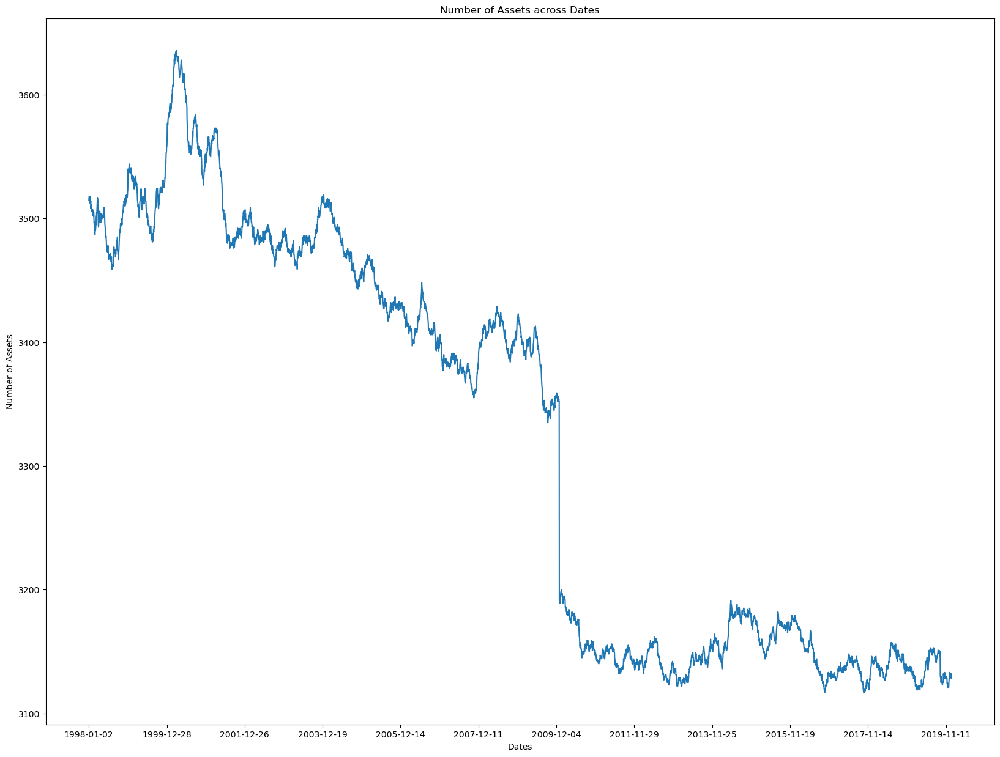

In [6]:
# Plot dates vs. number of assets
plt.figure(figsize=(20, 15))
plt.plot(dates, num_assets_per_date)
plt.xlabel('Dates')
plt.ylabel('Number of Assets')
plt.xticks(np.arange(0, len(dates), 500))
plt.title('Number of Assets across Dates')
plt.show()

In [206]:
# Use a volume criterion for universe selection
# (1) Aggregate volumes for each asset cumulatively 
# (2) Use a cutoff to select highest volume assets from (1) as our universe for the next day
# (3) Repeatedly select universes for each day, starting from day1 of the 2nd year

# Function to collect daily universe 
def collect_daily_universe(num_assets, lookback_days):
    i = 0
    
    daily_universe = {}
    
    # Collect
    for date, group in tqdm(dg):
        cur_nonzero_vol_assets = group[group['20-Day ADV'] != 0][['ID', '20-Day ADV']]
        
        if i == 0:
            asset_vols = cur_nonzero_vol_assets
            
        if i >= lookback_days:
            daily_universe[date] = asset_vols.sort_values(by='20-Day ADV').iloc[-num_assets:, :]['ID'].reset_index(drop=True)
        
        if i > 0:
            asset_vols = pd.merge(cur_nonzero_vol_assets, asset_vols, on='ID')
            vols = asset_vols.drop(columns=['ID'])
            asset_vols['20-Day ADV'] = vols.sum(axis=1)
            asset_vols = asset_vols[['20-Day ADV', 'ID']]

        i += 1
    
    # Get number of changes
    changes = []
    i = 0
    for u in daily_universe:
        if i != 0:
            changes.append(num_assets - len(set(daily_universe[u].tolist()).intersection(prev)))
        
        prev = set(daily_universe[u].tolist())
            
        i += 1
    
    return daily_universe, changes

In [231]:
daily_universe, changes = collect_daily_universe(700, 252)

100%|██████████████████████████████████████████████████████████████████████████████| 5535/5535 [01:33<00:00, 59.05it/s]


In [314]:
# Get returns of all assets in our selected universe for all dates first
pd.set_option('display.max_rows', 20)

universe_returns = []
for date, group in tqdm(dg):
    try:
        universe = daily_universe[date]
    except Exception as e:
        continue
        
    df = group[group['ID'].isin(universe)].reset_index(drop=True)
    
    universe_returns.append(df['Total Return'].tolist())
    
universe_returns = pd.DataFrame(universe_returns)
universe_returns

100%|█████████████████████████████████████████████████████████████████████████████| 5535/5535 [00:13<00:00, 405.72it/s]


,0,1,2,3,4,5,6,7,8,9,...,690,691,692,693,694,695,696,697,698,699
0,-0.032949,-0.021429,-0.038179,0.006667,0.007805,-0.055833,0.020501,0.001742,-0.012793,0.095164,...,-0.022923,0.006834,0.015873,-0.009524,0.003574,NaN,NaN,NaN,NaN,NaN
1,0.007666,0.012165,0.018321,0.034216,-0.003872,0.016770,-0.004464,-0.001739,0.008639,-0.065527,...,0.011121,-0.001818,0.033784,0.001300,0.025323,0.029326,-0.007919,0.010417,0.019231,0.000000
2,-0.010989,0.000601,0.014993,0.078975,0.005831,0.086806,-0.004484,-0.003484,0.027837,0.089939,...,0.014382,0.005464,0.058824,-0.015584,0.050447,0.054131,0.010262,0.038660,0.037736,0.012821
3,-0.010256,-0.005405,-0.013294,-0.000989,0.000000,-0.023163,-0.004505,-0.019231,0.006250,0.204196,...,-0.002235,-0.028986,0.080247,-0.002639,0.012006,-0.002703,-0.013544,0.002481,-0.006612,-0.009142
4,-0.016408,0.030193,0.002994,-0.030693,-0.010628,0.006541,-0.006787,0.014260,0.072464,-0.037166,...,0.018519,0.016791,0.017143,-0.007937,0.006920,-0.005420,0.016018,0.047030,-0.019135,0.010646
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5278,0.000409,-0.000295,0.006583,0.003129,0.001802,-0.001133,0.000887,-0.005853,-0.002194,0.009726,...,0.009148,0.001648,-0.004386,0.006876,-0.000161,0.000194,0.004143,-0.000666,-0.005371,0.003137
5279,0.004392,-0.002759,-0.002647,-0.002340,0.012738,0.016440,0.001773,0.000000,0.003664,0.010407,...,-0.005666,0.001175,0.003304,-0.003089,0.000000,0.005148,0.003257,0.003496,0.005646,0.005098
5280,-0.003559,0.001581,0.000312,0.006449,0.005327,-0.005577,0.006417,-0.021518,0.001704,-0.000548,...,-0.018234,-0.001409,-0.013172,-0.002284,0.004175,-0.004639,0.003030,0.004812,0.003173,-0.005478
5281,0.001531,0.005425,0.002497,-0.014175,-0.005299,-0.000561,-0.001979,0.003112,-0.000972,-0.017980,...,-0.002321,-0.002586,-0.007230,-0.003923,0.000799,-0.003495,-0.000216,0.002147,0.007786,0.003502


In [315]:
(universe_returns.isna().sum(axis=1) != 0).sum()

609

Since we will be working with daily timestamps to ensure integrity of the asset universe, we will remove the relatively small amount of dates (609) for which there are undefined returns due to the number of assets at times being greater than the intersecting assets universe across dates.

In [385]:
dates = list(daily_universe.keys())
dates

['1999-01-04',
 '1999-01-05',
 '1999-01-06',
 '1999-01-07',
 '1999-01-08',
 '1999-01-11',
 '1999-01-12',
 '1999-01-13',
 '1999-01-14',
 '1999-01-15',
 '1999-01-19',
 '1999-01-20',
 '1999-01-21',
 '1999-01-22',
 '1999-01-25',
 '1999-01-26',
 '1999-01-27',
 '1999-01-28',
 '1999-01-29',
 '1999-02-01',
 '1999-02-02',
 '1999-02-03',
 '1999-02-04',
 '1999-02-05',
 '1999-02-08',
 '1999-02-09',
 '1999-02-10',
 '1999-02-11',
 '1999-02-12',
 '1999-02-16',
 '1999-02-17',
 '1999-02-18',
 '1999-02-19',
 '1999-02-22',
 '1999-02-23',
 '1999-02-24',
 '1999-02-25',
 '1999-02-26',
 '1999-03-01',
 '1999-03-02',
 '1999-03-03',
 '1999-03-04',
 '1999-03-05',
 '1999-03-08',
 '1999-03-09',
 '1999-03-10',
 '1999-03-11',
 '1999-03-12',
 '1999-03-15',
 '1999-03-16',
 '1999-03-17',
 '1999-03-18',
 '1999-03-19',
 '1999-03-22',
 '1999-03-23',
 '1999-03-24',
 '1999-03-25',
 '1999-03-26',
 '1999-03-29',
 '1999-03-30',
 '1999-03-31',
 '1999-04-01',
 '1999-04-05',
 '1999-04-06',
 '1999-04-07',
 '1999-04-08',
 '1999-04-

In [317]:
# Reorganize data for ease of access
dates_assets_factors = universe_returns
dates_assets_factors['Date'] = dates
dates_assets_factors

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,Date
0,-0.032949,-0.021429,-0.038179,0.006667,0.007805,-0.055833,0.020501,0.001742,-0.012793,0.095164,...,0.006834,0.015873,-0.009524,0.003574,NaN,NaN,NaN,NaN,NaN,1999-01-04
1,0.007666,0.012165,0.018321,0.034216,-0.003872,0.016770,-0.004464,-0.001739,0.008639,-0.065527,...,-0.001818,0.033784,0.001300,0.025323,0.029326,-0.007919,0.010417,0.019231,0.000000,1999-01-05
2,-0.010989,0.000601,0.014993,0.078975,0.005831,0.086806,-0.004484,-0.003484,0.027837,0.089939,...,0.005464,0.058824,-0.015584,0.050447,0.054131,0.010262,0.038660,0.037736,0.012821,1999-01-06
3,-0.010256,-0.005405,-0.013294,-0.000989,0.000000,-0.023163,-0.004505,-0.019231,0.006250,0.204196,...,-0.028986,0.080247,-0.002639,0.012006,-0.002703,-0.013544,0.002481,-0.006612,-0.009142,1999-01-07
4,-0.016408,0.030193,0.002994,-0.030693,-0.010628,0.006541,-0.006787,0.014260,0.072464,-0.037166,...,0.016791,0.017143,-0.007937,0.006920,-0.005420,0.016018,0.047030,-0.019135,0.010646,1999-01-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5278,0.000409,-0.000295,0.006583,0.003129,0.001802,-0.001133,0.000887,-0.005853,-0.002194,0.009726,...,0.001648,-0.004386,0.006876,-0.000161,0.000194,0.004143,-0.000666,-0.005371,0.003137,2019-12-24
5279,0.004392,-0.002759,-0.002647,-0.002340,0.012738,0.016440,0.001773,0.000000,0.003664,0.010407,...,0.001175,0.003304,-0.003089,0.000000,0.005148,0.003257,0.003496,0.005646,0.005098,2019-12-26
5280,-0.003559,0.001581,0.000312,0.006449,0.005327,-0.005577,0.006417,-0.021518,0.001704,-0.000548,...,-0.001409,-0.013172,-0.002284,0.004175,-0.004639,0.003030,0.004812,0.003173,-0.005478,2019-12-27
5281,0.001531,0.005425,0.002497,-0.014175,-0.005299,-0.000561,-0.001979,0.003112,-0.000972,-0.017980,...,-0.002586,-0.007230,-0.003923,0.000799,-0.003495,-0.000216,0.002147,0.007786,0.003502,2019-12-30


In [318]:
# Dropna for universe returns
dates_assets_factors = dates_assets_factors.dropna(axis=0).reset_index(drop=True)
dates_assets_factors

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,Date
0,0.007666,0.012165,0.018321,0.034216,-0.003872,0.016770,-0.004464,-0.001739,0.008639,-0.065527,...,-0.001818,0.033784,0.001300,0.025323,0.029326,-0.007919,0.010417,0.019231,0.000000,1999-01-05
1,-0.010989,0.000601,0.014993,0.078975,0.005831,0.086806,-0.004484,-0.003484,0.027837,0.089939,...,0.005464,0.058824,-0.015584,0.050447,0.054131,0.010262,0.038660,0.037736,0.012821,1999-01-06
2,-0.010256,-0.005405,-0.013294,-0.000989,0.000000,-0.023163,-0.004505,-0.019231,0.006250,0.204196,...,-0.028986,0.080247,-0.002639,0.012006,-0.002703,-0.013544,0.002481,-0.006612,-0.009142,1999-01-07
3,-0.016408,0.030193,0.002994,-0.030693,-0.010628,0.006541,-0.006787,0.014260,0.072464,-0.037166,...,0.016791,0.017143,-0.007937,0.006920,-0.005420,0.016018,0.047030,-0.019135,0.010646,1999-01-08
4,-0.025461,-0.003517,0.007463,-0.026558,-0.013672,0.000000,-0.006834,0.014060,-0.038610,0.025332,...,-0.003670,0.022472,-0.024000,-0.006382,-0.008174,-0.019144,-0.023641,-0.016115,0.008427,1999-01-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4669,0.000409,-0.000295,0.006583,0.003129,0.001802,-0.001133,0.000887,-0.005853,-0.002194,0.009726,...,0.001648,-0.004386,0.006876,-0.000161,0.000194,0.004143,-0.000666,-0.005371,0.003137,2019-12-24
4670,0.004392,-0.002759,-0.002647,-0.002340,0.012738,0.016440,0.001773,0.000000,0.003664,0.010407,...,0.001175,0.003304,-0.003089,0.000000,0.005148,0.003257,0.003496,0.005646,0.005098,2019-12-26
4671,-0.003559,0.001581,0.000312,0.006449,0.005327,-0.005577,0.006417,-0.021518,0.001704,-0.000548,...,-0.001409,-0.013172,-0.002284,0.004175,-0.004639,0.003030,0.004812,0.003173,-0.005478,2019-12-27
4672,0.001531,0.005425,0.002497,-0.014175,-0.005299,-0.000561,-0.001979,0.003112,-0.000972,-0.017980,...,-0.002586,-0.007230,-0.003923,0.000799,-0.003495,-0.000216,0.002147,0.007786,0.003502,2019-12-30


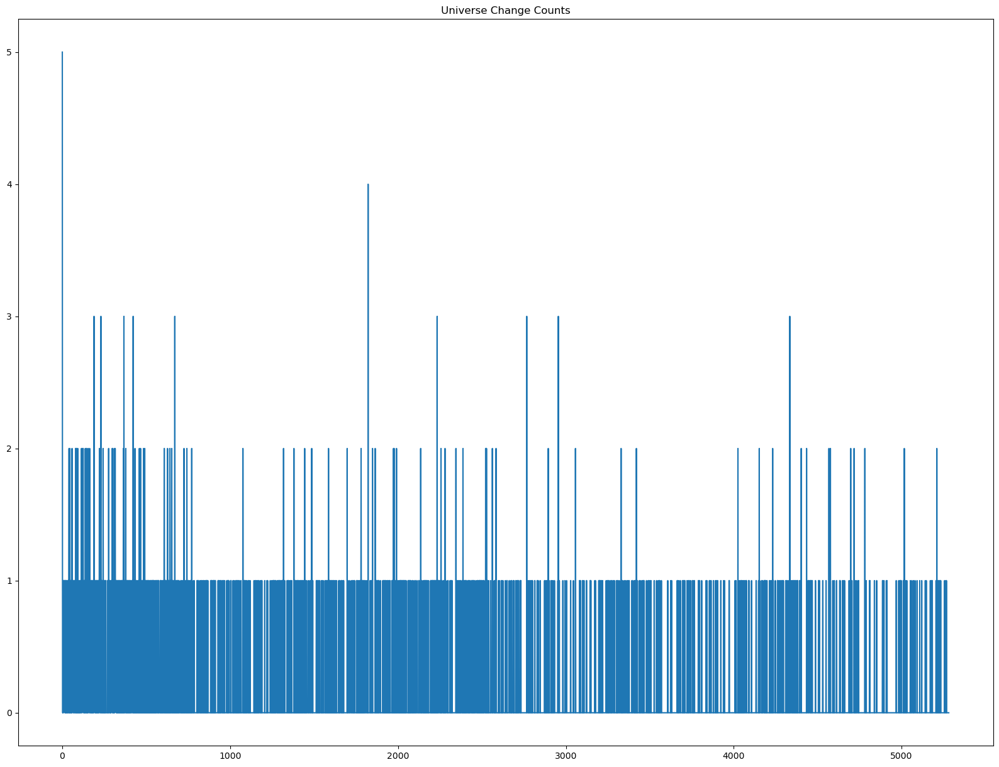

In [319]:
# Plot daily universe changes
plt.figure(figsize=(20,15))
plt.plot(changes)
plt.title('Universe Change Counts')
plt.show()

By construction our selected universes are on the more liquid side of all available assets in the given data. We choose not to winsorize our returns data of the selected estimation universe for correct evaluation of factor and idiosyncratic returns.

## b. Perform a fundamental factor model using the available factors.

In [339]:
# Perform cross-sectional regression for each date using
# returns as the dependent and factor loadings as the independent variables
factors = ['Growth', 'Volatility', 'Profitability', 'Dividend Yield', 'Value', 'Market Sensitivity', 'Medium-Term Momentum', 'Short-Term Momentum', 'Liquidity']

f_ts, e_ts = {}, {} # to store factor returns & idio returns for each date

i = 0
for date, df in tqdm(dg):
    
    if date not in dates_assets_factors.iloc[:, -1].tolist():
        continue
    
    try:
        universe = daily_universe[date]
    except Exception as e:
        continue

    cur_universe = df[df['ID'].isin(universe)].reset_index(drop=True)
    X = cur_universe[factors]
    y = cur_universe['Total Return']
    model = sm.OLS(y, X)
    results = model.fit()
    f_ts[date] = results.params
    e_ts[date] = results.resid
    
    i += 1

100%|█████████████████████████████████████████████████████████████████████████████| 5535/5535 [00:35<00:00, 155.17it/s]


In [340]:
# Plot factor returns over time
# and calculate Annual returns and Sharpe ratios of factors
factor_returns = pd.DataFrame(list(f_ts.values()))
factor_returns

,Growth,Volatility,Profitability,Dividend Yield,Value,Market Sensitivity,Medium-Term Momentum,Short-Term Momentum,Liquidity
0,-0.009873,0.002936,0.000487,-0.002211,0.001532,0.001698,-0.004573,0.008717,0.006469
1,-0.002225,0.005863,-0.003257,0.002760,0.017510,0.009117,0.000741,0.010582,0.012623
2,0.001256,0.008477,-0.005452,0.006893,-0.004276,0.002645,-0.000953,0.016334,0.005123
3,-0.003849,-0.000591,-0.007076,0.004510,0.004039,-0.001833,0.000957,0.013622,0.005765
4,-0.001018,0.011593,-0.007120,0.009331,0.002896,-0.000344,0.017337,0.023401,0.007517
...,...,...,...,...,...,...,...,...,...
4669,-0.001090,-0.000337,0.001971,-0.000391,0.001213,-0.000983,0.001324,-0.000424,0.002355
4670,-0.001741,-0.001532,-0.000456,-0.000222,0.001269,0.000062,-0.001190,0.004603,0.003099
4671,-0.000538,-0.004290,-0.003046,-0.000511,-0.002254,-0.003807,-0.001759,0.002280,0.000766
4672,-0.001803,-0.006463,0.002989,0.001944,-0.004497,-0.000529,-0.001164,0.006761,-0.002579


100%|████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:14<00:00,  1.61s/it]


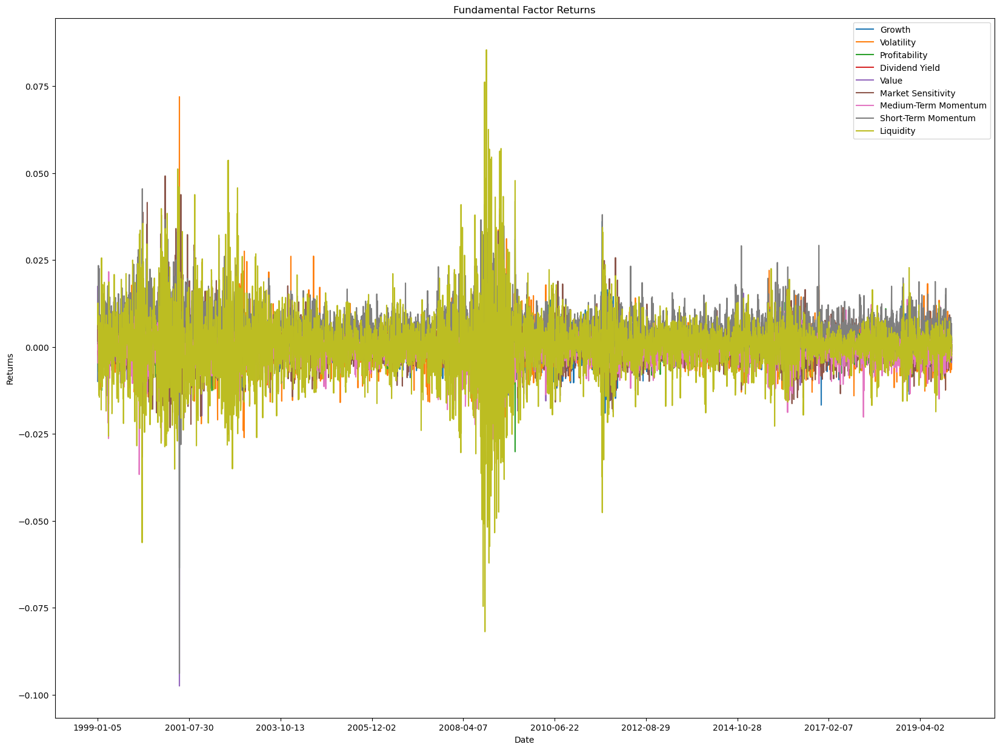

In [341]:
plt.figure(figsize=(20,15))
dates = list(f_ts.keys())
for f in tqdm(factor_returns.columns):
    plt.plot(dates, factor_returns[f], label=f)
plt.xticks(np.arange(0, len(factor_returns), 500))
plt.xlabel('Date')
plt.ylabel('Returns')
plt.legend()
plt.title('Fundamental Factor Returns')
plt.show()

In [342]:
for f in factor_returns.columns:
    print('Fundamental Factor', f, 'Annual Returns:', 252*factor_returns[f].mean())
    print('Fundamental Factor', f, 'Annual Sharpe:', np.sqrt(252)*factor_returns[f].mean()/factor_returns[f].std())

Fundamental Factor Growth Annual Returns: -0.007675289215751267
Fundamental Factor Growth Annual Sharpe: -0.12368507728705622
Fundamental Factor Volatility Annual Returns: 0.003787509648883883
Fundamental Factor Volatility Annual Sharpe: 0.0426674650583833
Fundamental Factor Profitability Annual Returns: 0.012199820173631882
Fundamental Factor Profitability Annual Sharpe: 0.23377803546585468
Fundamental Factor Dividend Yield Annual Returns: 0.018970200475822846
Fundamental Factor Dividend Yield Annual Sharpe: 0.47729187663241085
Fundamental Factor Value Annual Returns: 0.06659664538594848
Fundamental Factor Value Annual Sharpe: 1.1497419375274736
Fundamental Factor Market Sensitivity Annual Returns: 0.03405188683186641
Fundamental Factor Market Sensitivity Annual Sharpe: 0.3517913317363331
Fundamental Factor Medium-Term Momentum Annual Returns: -0.1367570627671421
Fundamental Factor Medium-Term Momentum Annual Sharpe: -1.9797896352491957
Fundamental Factor Short-Term Momentum Annual Re

## c. Plot daily turnover of each factor over time. Sort factors from lowest turnover to higher turnover and determine a cluster of lower-turnover and high-turnover factors.

In [324]:
# Compute turnover via sequence of factor loadings per factor
turnovers = []
prev_df = None
for date, group in tqdm(dg):
    if date not in dates_assets_factors.iloc[:, -1].tolist():
        continue
    
    try:
        universe = daily_universe[date]
    except Exception as e:
        continue
        
    df = group[group['ID'].isin(universe)].reset_index(drop=True)
    if prev_df is None:
        prev_df = df[factors].copy()
    else:
        turnovers.append(((df[factors].reset_index(drop=True) - prev_df)**2).sum(axis=0)/(prev_df**2).sum(axis=0))
        prev_df = df[factors].copy().reset_index(drop=True)
turnovers

100%|█████████████████████████████████████████████████████████████████████████████| 5535/5535 [00:37<00:00, 146.39it/s]


[Growth                  1.117866
 Volatility              1.024764
 Profitability           1.036778
 Dividend Yield          0.979866
 Value                   1.116148
 Market Sensitivity      1.035865
 Medium-Term Momentum    1.041954
 Short-Term Momentum     1.298998
 Liquidity               0.792545
 dtype: float64,
 Growth                  0.001226
 Volatility              0.001151
 Profitability           0.000007
 Dividend Yield          0.000110
 Value                   0.000235
 Market Sensitivity      0.000139
 Medium-Term Momentum    0.000640
 Short-Term Momentum     0.177171
 Liquidity               0.003423
 dtype: float64,
 Growth                  0.000002
 Volatility              0.001231
 Profitability           0.000005
 Dividend Yield          0.000038
 Value                   0.000238
 Market Sensitivity      0.000149
 Medium-Term Momentum    0.000844
 Short-Term Momentum     0.128340
 Liquidity               0.002413
 dtype: float64,
 Growth                  0.1439

In [325]:
turnovers = pd.DataFrame(turnovers)
turnovers

,Growth,Volatility,Profitability,Dividend Yield,Value,Market Sensitivity,Medium-Term Momentum,Short-Term Momentum,Liquidity
0,1.117866e+00,1.024764,1.036778e+00,0.979866,1.116148,1.035865,1.041954,1.298998,0.792545
1,1.225967e-03,0.001151,6.704624e-06,0.000110,0.000235,0.000139,0.000640,0.177171,0.003423
2,2.483102e-06,0.001231,5.271050e-06,0.000038,0.000238,0.000149,0.000844,0.128340,0.002413
3,1.439605e-01,0.125354,8.835551e-02,0.103850,0.087059,0.102613,0.100128,0.321265,0.104123
4,1.648068e-06,0.001637,8.736332e-07,0.000019,0.000082,0.000203,0.000547,0.084112,0.001116
...,...,...,...,...,...,...,...,...,...
4668,1.141919e-07,0.001034,3.013654e-08,0.000023,0.000043,0.000150,0.000552,0.055098,0.000173
4669,6.805306e-08,0.001054,2.409375e-06,0.000420,0.000152,0.000110,0.000531,0.064792,0.006513
4670,8.651980e-08,0.000964,3.123364e-06,0.000286,0.000094,0.000089,0.000509,0.072028,0.002362
4671,4.594178e-03,0.000884,4.618716e-07,0.000547,0.000064,0.000067,0.000554,0.119133,0.000701


100%|████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:06<00:00,  1.48it/s]


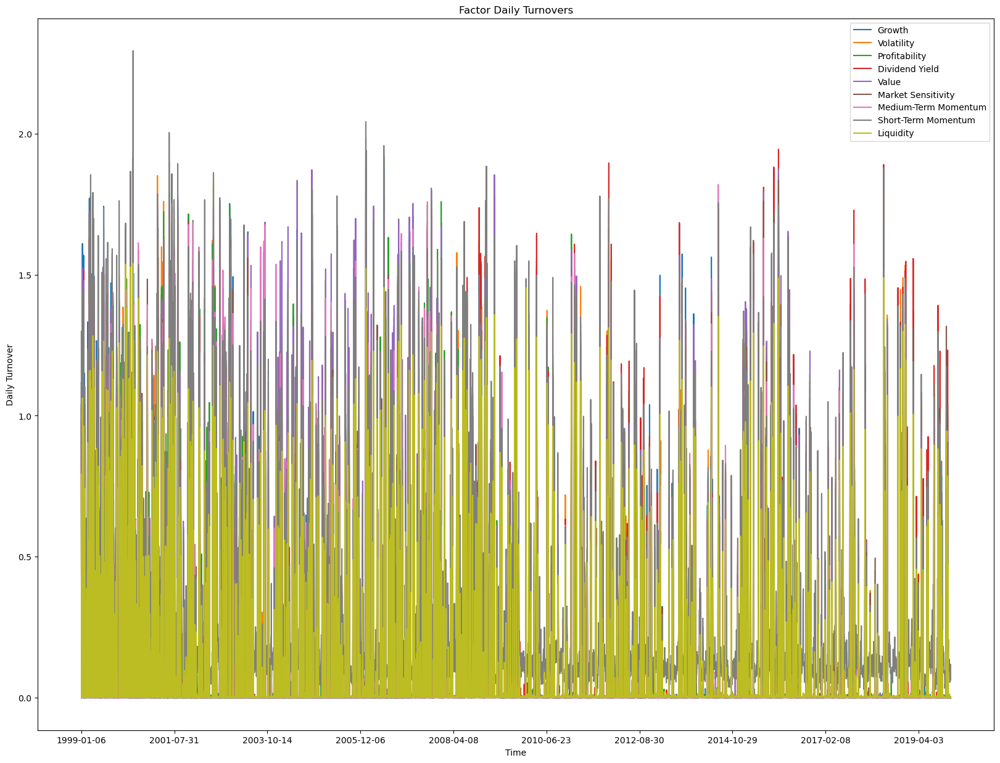

In [326]:
plt.figure(figsize=(20,15))
for f in tqdm(turnovers.columns):
    plt.plot(dates[1:], turnovers[f], label=f)
plt.xticks(np.arange(0, len(dates), 500))
plt.xlabel('Time')
plt.ylabel('Daily Turnover')
plt.title('Factor Daily Turnovers')
plt.legend()
plt.show()

In [327]:
from sklearn.cluster import KMeans # determine clusters of high and low turnover factors

kmeans = KMeans(n_clusters=2, random_state=42)
kmeans.fit(turnovers.T)

C:\Users\zeanv\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\zeanv\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


KMeans(n_clusters=2, random_state=42)

In [328]:
clusters = kmeans.labels_
clusters

array([0, 0, 0, 0, 0, 0, 0, 1, 0])

In [329]:
turnover_sums = turnovers.sum(axis=0) # See turnover sums for each factor
turnover_sums

Growth                   672.810006
Volatility               650.341797
Profitability            684.948388
Dividend Yield           630.211677
Value                    674.852456
Market Sensitivity       642.493737
Medium-Term Momentum     654.045259
Short-Term Momentum     1185.956426
Liquidity                534.444532
dtype: float64

In [330]:
high_turnover_factors = ['Short-Term Momentum']
low_turnover_factors = ['Growth', 'Volatility', 'Profitability', 'Dividend Yield', 'Value', 'Market Sensitivity', 'Medium-Term Momentum', 'Liquidity']

## d. Orthogonalize high-turnover factors to lower-turnover ones.

In [331]:
# For each date, we regress high turnover factors (dependent variable)
# to low turnover factors (independent variable) to obtain orthogonalized high turnover factor loadings

high_turnover_loadings = {} # new high turnover factor loadings
dot_prods = []

for date, group in tqdm(dg):
    
    if date not in dates_assets_factors.iloc[:, -1].tolist():
        continue
    try:
        universe = daily_universe[date]
    except Exception as e:
        continue
        
    df = group[group['ID'].isin(universe)].reset_index(drop=True)
    
    X = df[low_turnover_factors]
    y = df[high_turnover_factors[0]]
    dot_prods.append(X.T@y)
    model = sm.OLS(y, X)
    results = model.fit()
    high_turnover_loadings[date] = results.resid
dot_prods # Check original results for dot product of high turnover factor (single) with all other low turnover factors

100%|█████████████████████████████████████████████████████████████████████████████| 5535/5535 [00:42<00:00, 129.46it/s]


[Growth                  109.303078
 Volatility               56.901020
 Profitability            -1.831988
 Dividend Yield         -150.666112
 Value                   -48.797984
 Market Sensitivity      244.253877
 Medium-Term Momentum    134.529368
 Liquidity               175.855038
 dtype: float64,
 Growth                   96.325485
 Volatility               60.773543
 Profitability           -18.823903
 Dividend Yield         -147.850105
 Value                   -44.093756
 Market Sensitivity      259.998562
 Medium-Term Momentum    139.286253
 Liquidity               184.907302
 dtype: float64,
 Growth                  112.696226
 Volatility               79.451317
 Profitability           -47.333993
 Dividend Yield         -148.075430
 Value                   -37.364290
 Market Sensitivity      297.894577
 Medium-Term Momentum    111.710791
 Liquidity               213.588016
 dtype: float64,
 Growth                   93.056106
 Volatility               84.467034
 Profitabilit

In [332]:
new_dot_prods = []

for date, group in tqdm(dg): # check orthogonality
    if date not in dates_assets_factors.iloc[:, -1].tolist():
        continue
    try:
        universe = daily_universe[date]
    except Exception as e:
        continue
        
    df = group[group['ID'].isin(universe)].reset_index(drop=True)
    X = df[low_turnover_factors]
    new_dot_prods.append(X.T@high_turnover_loadings[date])

new_dot_prods

100%|█████████████████████████████████████████████████████████████████████████████| 5535/5535 [00:21<00:00, 257.23it/s]


[Growth                 -8.704149e-14
 Volatility              2.708944e-14
 Profitability           9.769963e-14
 Dividend Yield         -2.842171e-14
 Value                  -8.704149e-14
 Market Sensitivity     -7.283063e-14
 Medium-Term Momentum    9.503509e-14
 Liquidity              -2.486900e-14
 dtype: float64,
 Growth                 -6.750156e-14
 Volatility              6.927792e-14
 Profitability          -9.947598e-14
 Dividend Yield         -3.774758e-14
 Value                   3.108624e-14
 Market Sensitivity      9.592327e-14
 Medium-Term Momentum    5.595524e-14
 Liquidity               7.460699e-14
 dtype: float64,
 Growth                 -3.552714e-14
 Volatility             -1.048051e-13
 Profitability           1.421085e-14
 Dividend Yield          9.592327e-14
 Value                   4.973799e-14
 Market Sensitivity     -3.552714e-14
 Medium-Term Momentum   -8.526513e-14
 Liquidity              -7.460699e-14
 dtype: float64,
 Growth                  1.065814e-14

We see the orthogonalization effect as the high turnover factor's inner product results with all other lower turnover factors have been pushed to near zero values.

## e. Perform Cross-Sectional regression for the combined factor universe, plot their returns and compute Annual Returns and Sharpe Ratios. Use the specific risk in the dataset for the weights.

In [343]:
i = 0
factor_returns = []
residual_returns = []
for date, group in tqdm(dg): # Perform cross-sectional weighted least squares per date
    if date not in dates_assets_factors.iloc[:, -1].tolist():
        continue
    
    try:
        universe = daily_universe[date]
    except Exception as e:
        continue
        
    df = group[group['ID'].isin(universe)].reset_index(drop=True)
        
    W = np.diag(1/df['Specific Risk']) # Using specific risk as weights
    y = np.array(df['Total Return']).reshape(-1, 1)
    X = np.array(pd.concat([df[low_turnover_factors], high_turnover_loadings[date]], axis=1))
    f_t = np.linalg.inv(X.T@(W@X))@(X.T@(W@y))
    factor_returns.append(f_t.flatten())
    residual_returns.append((y - X@f_t).flatten())
    i += 1

100%|█████████████████████████████████████████████████████████████████████████████| 5535/5535 [00:52<00:00, 105.67it/s]


In [344]:
factor_returns = pd.DataFrame(factor_returns, columns=low_turnover_factors + high_turnover_factors)
factor_returns

,Growth,Volatility,Profitability,Dividend Yield,Value,Market Sensitivity,Medium-Term Momentum,Liquidity,Short-Term Momentum
0,-0.008566,0.003355,0.000005,-0.000524,0.002715,0.003984,-0.001580,0.008128,0.007714
1,-0.004023,0.006762,-0.002911,0.003364,0.013739,0.010127,-0.002578,0.014400,0.010528
2,0.000239,0.012232,-0.003838,0.005443,-0.002584,0.009041,0.001625,0.003072,0.016581
3,-0.006487,0.004278,-0.004291,0.004090,0.005010,0.005179,0.002297,0.003671,0.015785
4,-0.001929,0.019221,-0.006063,0.008487,0.002371,0.009303,0.018979,0.007054,0.021947
...,...,...,...,...,...,...,...,...,...
4669,-0.000124,0.001063,0.000841,-0.000073,0.001185,-0.001128,0.001691,0.001724,-0.000121
4670,-0.001440,-0.001896,0.000078,0.000538,0.000884,0.000372,0.000190,0.001739,0.002971
4671,-0.000073,-0.002641,-0.000466,0.000302,-0.001868,-0.002965,0.000232,-0.000742,0.000723
4672,0.000121,-0.000947,0.000657,-0.000061,0.000639,-0.000697,0.000011,-0.000436,0.003813


In [345]:
dates_assets_factors = pd.concat([dates_assets_factors, factor_returns], axis=1)
dates_assets_factors

,0,1,2,3,4,5,6,7,8,9,...,Date,Growth,Volatility,Profitability,Dividend Yield,Value,Market Sensitivity,Medium-Term Momentum,Liquidity,Short-Term Momentum
0,0.007666,0.012165,0.018321,0.034216,-0.003872,0.016770,-0.004464,-0.001739,0.008639,-0.065527,...,1999-01-05,-0.008566,0.003355,0.000005,-0.000524,0.002715,0.003984,-0.001580,0.008128,0.007714
1,-0.010989,0.000601,0.014993,0.078975,0.005831,0.086806,-0.004484,-0.003484,0.027837,0.089939,...,1999-01-06,-0.004023,0.006762,-0.002911,0.003364,0.013739,0.010127,-0.002578,0.014400,0.010528
2,-0.010256,-0.005405,-0.013294,-0.000989,0.000000,-0.023163,-0.004505,-0.019231,0.006250,0.204196,...,1999-01-07,0.000239,0.012232,-0.003838,0.005443,-0.002584,0.009041,0.001625,0.003072,0.016581
3,-0.016408,0.030193,0.002994,-0.030693,-0.010628,0.006541,-0.006787,0.014260,0.072464,-0.037166,...,1999-01-08,-0.006487,0.004278,-0.004291,0.004090,0.005010,0.005179,0.002297,0.003671,0.015785
4,-0.025461,-0.003517,0.007463,-0.026558,-0.013672,0.000000,-0.006834,0.014060,-0.038610,0.025332,...,1999-01-11,-0.001929,0.019221,-0.006063,0.008487,0.002371,0.009303,0.018979,0.007054,0.021947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4669,0.000409,-0.000295,0.006583,0.003129,0.001802,-0.001133,0.000887,-0.005853,-0.002194,0.009726,...,2019-12-24,-0.000124,0.001063,0.000841,-0.000073,0.001185,-0.001128,0.001691,0.001724,-0.000121
4670,0.004392,-0.002759,-0.002647,-0.002340,0.012738,0.016440,0.001773,0.000000,0.003664,0.010407,...,2019-12-26,-0.001440,-0.001896,0.000078,0.000538,0.000884,0.000372,0.000190,0.001739,0.002971
4671,-0.003559,0.001581,0.000312,0.006449,0.005327,-0.005577,0.006417,-0.021518,0.001704,-0.000548,...,2019-12-27,-0.000073,-0.002641,-0.000466,0.000302,-0.001868,-0.002965,0.000232,-0.000742,0.000723
4672,0.001531,0.005425,0.002497,-0.014175,-0.005299,-0.000561,-0.001979,0.003112,-0.000972,-0.017980,...,2019-12-30,0.000121,-0.000947,0.000657,-0.000061,0.000639,-0.000697,0.000011,-0.000436,0.003813


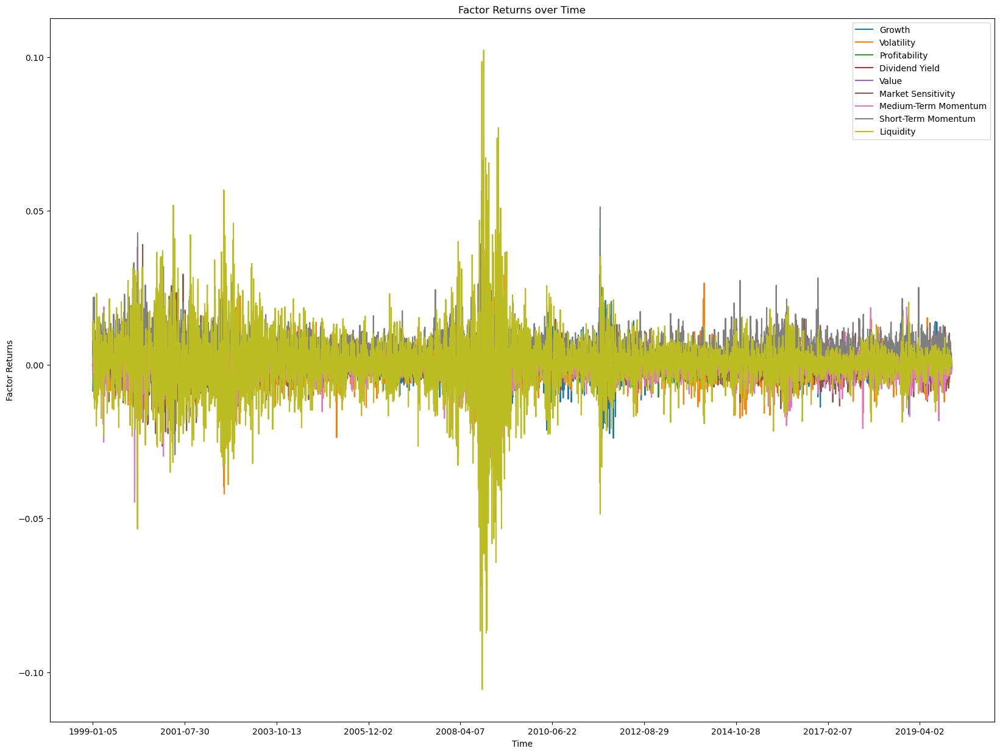

In [346]:
# Plot each factor return over time
plt.figure(figsize=(20,15))
for f in factors:
    plt.plot(dates, factor_returns[f], label=f)
plt.xticks(np.arange(0, len(dates), 500))
plt.xlabel('Time')
plt.ylabel('Factor Returns')
plt.title('Factor Returns over Time')
plt.legend()
plt.show()

In [347]:
# Compute Annual Returns and Sharpe of factors
for f in factors:
    print(f, 'Factor')
    print('Annual returns:', factor_returns[f].mean()*252)
    print('Sharpe ratio:', np.sqrt(252)*factor_returns[f].mean()/factor_returns[f].std())
    print('\n')

Growth Factor
Annual returns: -0.03005325808639452
Sharpe ratio: -0.421721667410895


Volatility Factor
Annual returns: -0.05747064105200104
Sharpe ratio: -0.7105617027365774


Profitability Factor
Annual returns: 0.017800862000675023
Sharpe ratio: 0.3662798206179271


Dividend Yield Factor
Annual returns: -0.00394680005128537
Sharpe ratio: -0.11071795410614313


Value Factor
Annual returns: 0.014726301086383458
Sharpe ratio: 0.2977489343620365


Market Sensitivity Factor
Annual returns: -0.04289507510519487
Sharpe ratio: -0.528132122019364


Medium-Term Momentum Factor
Annual returns: 0.010276368545793602
Sharpe ratio: 0.13325528457725638


Short-Term Momentum Factor
Annual returns: 1.6669346773698073
Sharpe ratio: 20.637389071129704


Liquidity Factor
Annual returns: 0.11336564196544432
Sharpe ratio: 0.6542398702171341




# Part 2.

## a. Implement a QLIKE Test statistic based on Random Portfolios.

In [349]:
# Using 1000 samples to calculate QLIKE statistic

np.random.seed(42)

def QLIKE(num_samples, num_assets, lookback):

    # Sample portfolio weights randomly from normal and normalize
    random_portfolio_weights = np.random.multivariate_normal(np.zeros(num_assets), np.eye(num_assets), num_samples)
    random_portfolio_weights /= np.linalg.norm(random_portfolio_weights, axis=1).reshape(-1, 1)

    # Choose timestep from uniform random
    # we calculate covariance matrices with a lookback
    timesteps = np.random.randint(lookback, len(dates_assets_factors), num_samples)

    selected_data = np.array(dates_assets_factors)[timesteps, :]

    qlike = 0
    for i in tqdm(range(num_samples)):
        s = timesteps[i]
        
        date = selected_data[i, -10]
        cur_df = dg.get_group(date)
        universe = daily_universe[date]
        cur_df = cur_df[cur_df['ID'].isin(universe)].reset_index(drop=True)
        
        rets = selected_data[i, :num_assets]
        
        date_idx = dates.index(date)
        
        covar_f = np.array(factor_returns.iloc[date_idx - lookback:date_idx, :].cov())
        idio_var = np.diag(cur_df['Specific Risk']*0.01)
        B_t = np.array(pd.concat([cur_df[low_turnover_factors], high_turnover_loadings[date]], axis=1))
        
        covar = B_t@covar_f@(B_t.T) + idio_var

        w = random_portfolio_weights[i, :]
        pf_var = w.T@covar@w
        
        pf_ret = rets@w

        qlike += (pf_ret**2)/(pf_var**2) - np.log((pf_ret**2)/(pf_var**2)) - 1
    
    return qlike/num_samples

for lb in [126*i for i in range(1, 7)]:
    print('LOOKBACK', lb, 'DAYS QLIKE:', QLIKE(1000, 700, lb))

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:17<00:00, 57.34it/s]


LOOKBACK 126 DAYS QLIKE: 5.117398804884949


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:17<00:00, 57.36it/s]


LOOKBACK 252 DAYS QLIKE: 4.948590895057706


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:18<00:00, 54.37it/s]


LOOKBACK 378 DAYS QLIKE: 4.955649114315327


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:18<00:00, 52.71it/s]


LOOKBACK 504 DAYS QLIKE: 5.043205032767883


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:18<00:00, 54.49it/s]


LOOKBACK 630 DAYS QLIKE: 5.03712776257709


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:18<00:00, 54.42it/s]

LOOKBACK 756 DAYS QLIKE: 4.94827363269557


## b. Implement Minimum Variance Portfolios tests.

In [350]:
from scipy.optimize import minimize

def minvar(weights, covar):
    return weights.T@covar@weights

# Function for retrieving covariance of asset returns for a specified period of time
def get_covar(lookback, date_end):
    date = np.array(dates_assets_factors)[date_end, -10]
    
    cur_df = dg.get_group(date)
    universe = daily_universe[date]
    cur_df = cur_df[cur_df['ID'].isin(universe)].reset_index(drop=True)

    date_idx = dates.index(date)

    covar_f = np.array(factor_returns.iloc[date_idx - lookback:date_idx, :].cov())
    idio_var = np.diag(cur_df['Specific Risk']*0.01)
    B_t = np.array(pd.concat([cur_df[low_turnover_factors], high_turnover_loadings[date]], axis=1))

    covar = B_t@covar_f@(B_t.T) + idio_var
    
    return covar

# Function for conducting minimum variance portfolio test
def minvartest(candidate_covar, test_period_returns, b, num_assets):
    init_guess = np.array([1/num_assets for _ in range(num_assets)])
    constraints = ({'type': 'eq', 'fun': lambda x: b.T@x-1}) # b^T @ w = 1
    
    # Get minimum variance weights of covar
    res_candidate = minimize(minvar, init_guess, args=(candidate_covar), constraints=constraints) # Candidate covariance minvar
    
    # Calculate Sharpe ratio on test period
    candidate_rets = test_period_returns@res_candidate.x
    candidate_Sharpe = candidate_rets.mean()/candidate_rets.std()
    
    return candidate_Sharpe

In [351]:
# Test with some candidate covariance and last 2 years out-of-sample returns data 
num_assets = 700
date_end = len(dates_assets_factors)-252*2
for lb in tqdm([126*i for i in range(1, 7)]):
    b = dates_assets_factors.iloc[:date_end, :num_assets].mean(axis=0) # set to alpha vector to evaluate with OOS Sharpes
    test_period_returns = dates_assets_factors.iloc[date_end+1:, :num_assets]
    sharpe = minvartest(get_covar(lb, date_end), test_period_returns, b, num_assets)
    print('LOOKBACK', lb, 'DAYS ANNUALIZED SHARPE:', sharpe*np.sqrt(252))

 17%|██████████████                                                                      | 1/6 [00:16<01:20, 16.14s/it]

LOOKBACK 126 DAYS ANNUALIZED SHARPE: 0.5790006071479791


 33%|████████████████████████████                                                        | 2/6 [00:32<01:04, 16.11s/it]

LOOKBACK 252 DAYS ANNUALIZED SHARPE: 0.5795937862167656


 50%|██████████████████████████████████████████                                          | 3/6 [00:48<00:48, 16.12s/it]

LOOKBACK 378 DAYS ANNUALIZED SHARPE: 0.5807340652202315


 67%|████████████████████████████████████████████████████████                            | 4/6 [01:05<00:32, 16.34s/it]

LOOKBACK 504 DAYS ANNUALIZED SHARPE: 0.5812670264979717


 83%|██████████████████████████████████████████████████████████████████████              | 5/6 [01:21<00:16, 16.41s/it]

LOOKBACK 630 DAYS ANNUALIZED SHARPE: 0.5807839409265099


100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [01:38<00:00, 16.40s/it]

LOOKBACK 756 DAYS ANNUALIZED SHARPE: 0.5806485351439324


## c. Estimate factor covariance matrix and idio vols.Try different half-lives.

Halflife: 63


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [04:17<00:00, 12.26s/it]


Halflife: 126


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [04:25<00:00, 12.63s/it]


Halflife: 189


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [04:20<00:00, 12.40s/it]


Halflife: 252


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [04:07<00:00, 11.80s/it]


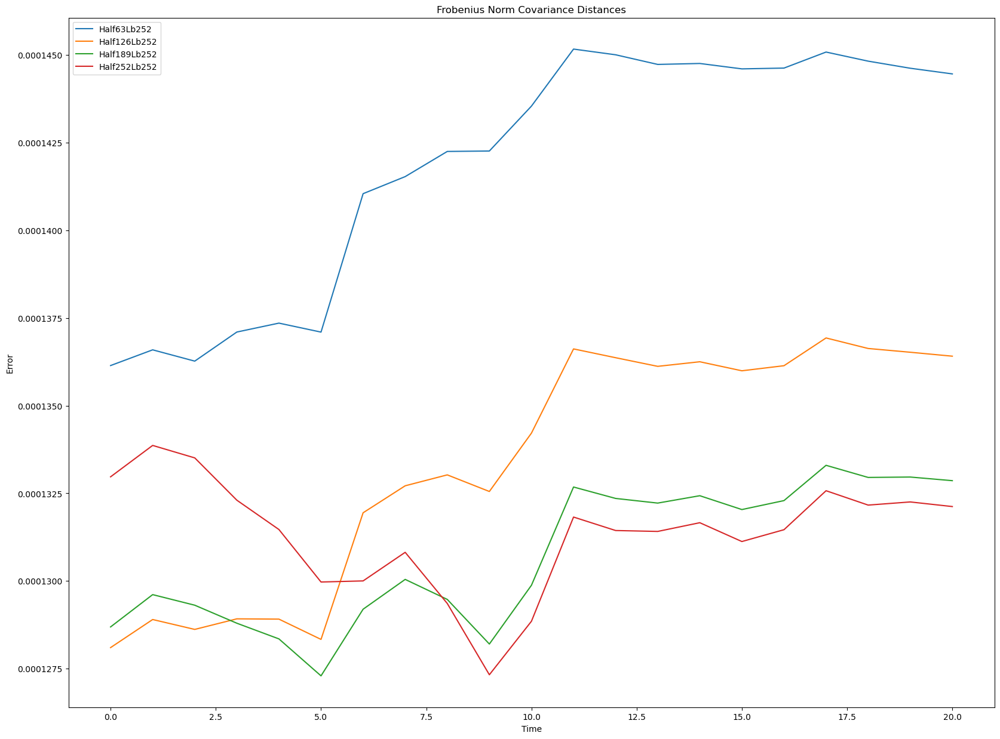

In [377]:
# Half lives: 3months ~ 1yr
half_lives = [63*i for i in range(1, 5)]

# Dynamic Conditional Correlation modeling for factor covariance matrix estimation
# test with Frobenius norm difference with true empirical factor covariance matrix from whole period

true_covar = dates_assets_factors[low_turnover_factors + high_turnover_factors].cov()

plt.figure(figsize=(20,15))

for halflife in half_lives:
    print('Halflife:', halflife)
    
    lb = 252
    Frb_norms_errs = []
    factor_covars = []
    
    # Estimate and compare with true covar for one month going forward
    for date_idx in tqdm(range(len(dates_assets_factors)-22, len(dates_assets_factors)-1)):
        factors = dates_assets_factors[low_turnover_factors + high_turnover_factors] #.iloc[date_idx - 2*lb:date_idx, :]

        V_ts = []
        for l in range(lb, -1, -1): # start from furthest away to current
            exp_weighting = np.array([np.exp(-s/halflife) for s in range(lb, -1, -1)])

            V2 = 0
            for t in range(lb, -1, -1): # get past V_t's
                V2 += exp_weighting[t]*np.outer(factors.iloc[date_idx-l-t, :], factors.iloc[date_idx-l-t, :])
            V_inv = np.diag(np.sqrt(np.diagonal(1/V2)))
            V_ts.append(V_inv)

        exp_weighting = np.array([np.exp(-s/halflife) for s in range(lb, -1, -1)])
        C = 0

        for t in range(lb, -1, -1):
            temp = V_ts[t]@np.array(factors.iloc[date_idx-t, :]).reshape(-1, 1)
            C += exp_weighting[t]*(temp@temp.T)

        V_t = np.diag((1/np.diagonal(V_ts[-1]))**2)
        factor_covars.append(V_t@C@V_t)

        Frb_norms_errs.append(np.linalg.norm(true_covar - factor_covars[-1]))
    plt.plot(Frb_norms_errs, label='Half' + str(halflife) + 'Lb' + str(lb))

plt.xlabel('Time')
plt.ylabel('Error')
plt.legend()
plt.title('Frobenius Norm Covariance Distances')
plt.show()

Halflife: 63


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [00:22<00:00,  1.06s/it]


Halflife: 126


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [00:19<00:00,  1.05it/s]


Halflife: 189


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [00:21<00:00,  1.01s/it]


Halflife: 252


100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [00:20<00:00,  1.04it/s]


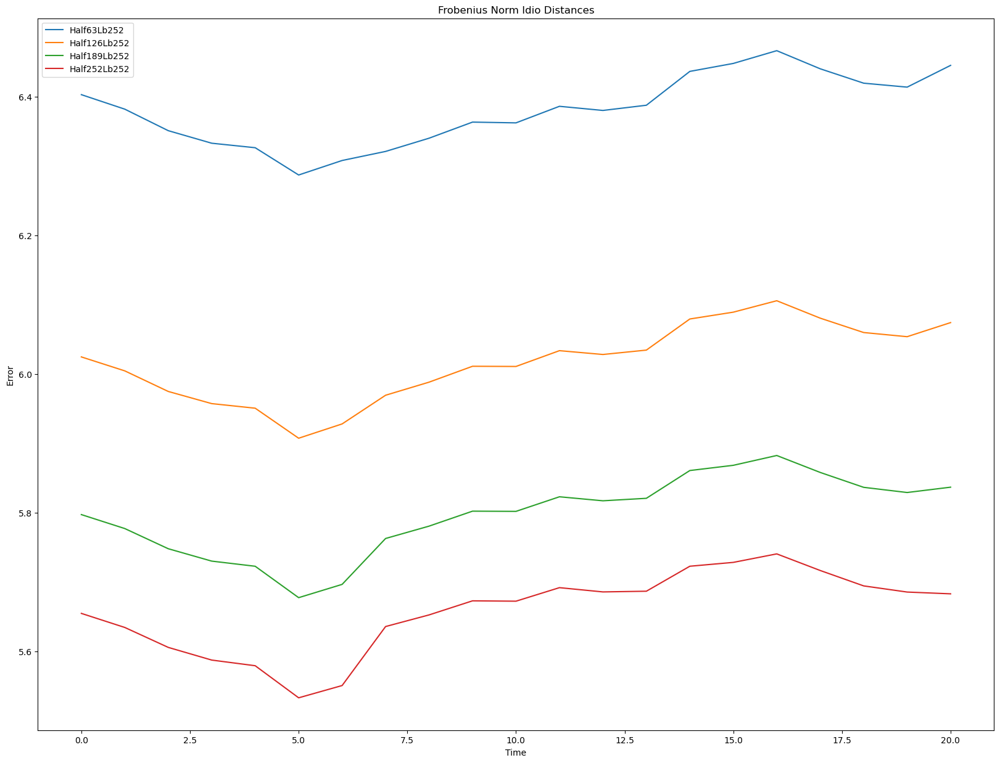

In [379]:
# Idio vol estimation

# Half lives: 3months ~ 1yr
half_lives = [63*i for i in range(1, 5)]

# test with Frobenius norm difference with true empirical idio vol matrix at associated timestep

plt.figure(figsize=(20,15))

for halflife in half_lives:
    print('Halflife:', halflife)
    
    lb = 252
    Frb_norms_errs = []
    idio_vols = []
    
    # Estimate and compare with true covar for one month going forward
    for date_idx in tqdm(range(len(dates_assets_factors)-22, len(dates_assets_factors)-1)):
        returns = dates_assets_factors.iloc[:, :num_assets]
        
        date = dates_assets_factors.iloc[date_idx, num_assets]
        df = dg.get_group(date)
        universe = daily_universe[date]
        df = df[df['ID'].isin(universe)].reset_index(drop=True)
        true_idio_vol = np.diag(df['Specific Risk']*0.01)

        exp_weighting = np.array([np.exp(-s/halflife) for s in range(lb, -1, -1)])

        V2 = 0
        for t in range(lb, -1, -1): # get past V_t's
            res_rets = residual_returns[date_idx-t]
            V2 += exp_weighting[t]*np.outer(res_rets, res_rets)

        idio_vols.append(np.diag(np.diagonal(V2)))

        Frb_norms_errs.append(np.linalg.norm(true_idio_vol - idio_vols[-1]))
    plt.plot(Frb_norms_errs, label='Half' + str(halflife) + 'Lb' + str(lb))

plt.xlabel('Time')
plt.ylabel('Error')
plt.legend()
plt.title('Frobenius Norm Idio Distances')
plt.show()

## d. Test the performance of the model under the QLIKE, MSE and Min Variance Portfolios for the first cluster, and then the second cluster.

In [380]:
# Function for getting min var weights of factor clusters
def minvarweights(candidate_covar, B, target_vector, num_assets):
    init_guess = np.array([1/num_assets for _ in range(num_assets)])
    constraints = ({'type': 'eq', 'fun': lambda x: B.T@x-target_vector})
    
    # Get minimum variance weights of covar
    res_candidate = minimize(minvar, init_guess, args=(candidate_covar), constraints=constraints) # Candidate covariance minvar
    return res_candidate.x

In [383]:
# QLIKE & MSE for low and high turnover factors

# Choose timestep from uniform random
# we calculate covariance matrices with a lookback
num_samples = 100
lookback = 252

timesteps = np.random.randint(lookback, len(dates_assets_factors), num_samples)

selected_data = np.array(dates_assets_factors)[timesteps, :]

high_qlike = 0
low_qlike = 0
high_mse = 0
low_mse = 0
for i in tqdm(range(num_samples)):
    s = timesteps[i]

    date = selected_data[i, -10]
    cur_df = dg.get_group(date)
    universe = daily_universe[date]
    cur_df = cur_df[cur_df['ID'].isin(universe)].reset_index(drop=True)

    rets = selected_data[i, :num_assets]

    date_idx = dates.index(date)

    covar_f = np.array(factor_returns.iloc[date_idx - lookback:date_idx, :].cov())
    idio_var = np.diag(cur_df['Specific Risk']*0.01)
    B_t = np.array(pd.concat([cur_df[low_turnover_factors], high_turnover_loadings[date]], axis=1))

    covar = B_t@covar_f@(B_t.T) + idio_var
    
    # High 
    target_vector = np.array([0]*8 + [1])
    w = minvarweights(candidate_covar=covar, B=B_t, target_vector=target_vector, num_assets=700)
    pf_var = w.T@covar@w
    pf_ret = rets@w
    high_qlike += (pf_ret**2)/(pf_var**2) - np.log((pf_ret**2)/(pf_var**2)) - 1
    high_mse += (pf_var**2)*(((pf_ret**2)/(pf_var**2)-1)**2)

    # Low
    target_vector = np.array([1]*8 + [0])
    w = minvarweights(candidate_covar=covar, B=B_t, target_vector=target_vector, num_assets=700)
    pf_var = w.T@covar@w
    pf_ret = rets@w
    low_qlike += (pf_ret**2)/(pf_var**2) - np.log((pf_ret**2)/(pf_var**2)) - 1
    low_mse += (pf_var**2)*(((pf_ret**2)/(pf_var**2)-1)**2)
    

print('LOOKBACK', lb, 'DAYS LOW QLIKE:', low_qlike/num_samples)
print('LOOKBACK', lb, 'DAYS HIGH QLIKE:', high_qlike/num_samples)
print('LOOKBACK', lb, 'DAYS LOW MSE:', low_mse/num_samples)
print('LOOKBACK', lb, 'DAYS HIGH MSE:', high_mse/num_samples)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [15:23<00:00,  9.24s/it]

LOOKBACK 126 DAYS LOW QLIKE: 1.385782873833354
LOOKBACK 126 DAYS HIGH QLIKE: 47.1872936264685
LOOKBACK 126 DAYS LOW MSE: 0.0006320224973178124
LOOKBACK 126 DAYS HIGH MSE: 0.004604233808046058


## e. Optional: apply shrinkage to covariance matrix, dynamic vol adjustment, and Newey-West correction.

100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 88.88it/s]


[]

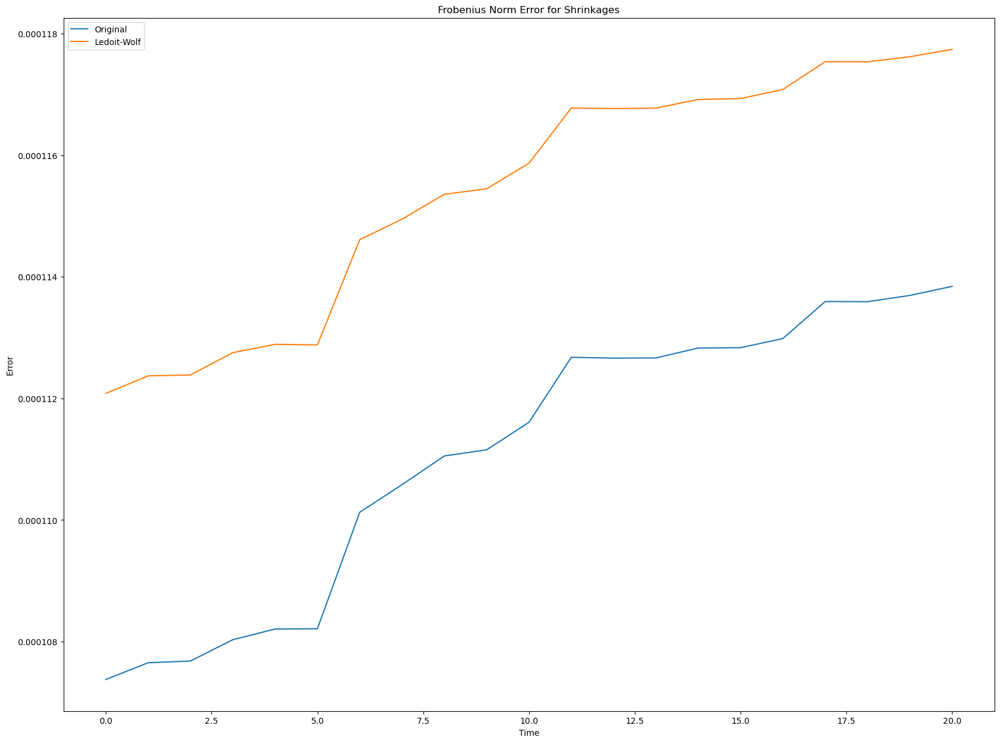

In [396]:
# Factor Covariance Shrinkage
true_covar = dates_assets_factors[low_turnover_factors + high_turnover_factors].cov()

lb = 252
simple_errs, lw_errs = [], []
for date_idx in tqdm(range(len(dates_assets_factors)-22, len(dates_assets_factors)-1)):
    date = dates_assets_factors.iloc[date_idx-1, num_assets]
    df = dg.get_group(date)
    universe = daily_universe[date]
    df = df[df['ID'].isin(universe)].reset_index(drop=True)
    
    factor_covar = dates_assets_factors.iloc[date_idx-lb:date_idx, :][low_turnover_factors + high_turnover_factors].cov()
    idio_var = np.diag(np.stack(residual_returns[date_idx-lb:date_idx], axis=1).var(axis=1))
    loadings =  df[low_turnover_factors + high_turnover_factors]
    
    # Original Shrinkage
    idio_var_inv = np.diag(1/np.diagonal(idio_var))
    var_shrink = factor_covar - (1/lb)*np.linalg.inv(loadings.T@(idio_var_inv)@loadings)

    # Ledoit-Wolf Shrinkage
    lw_shrink = 0.7*factor_covar + 0.3*np.diagonal(factor_covar).sum()*np.eye(9)/9
    
    simple_errs.append(np.linalg.norm(true_covar - var_shrink))
    lw_errs.append(np.linalg.norm(true_covar - lw_shrink))
    
plt.figure(figsize=(20,15))
plt.plot(simple_errs, label='Original')
plt.plot(lw_errs, label='Ledoit-Wolf')
plt.xlabel('Time')
plt.ylabel('Error')
plt.legend()
plt.title('Frobenius Norm Error for Shrinkages')
plt.plot()

We observe that the factor covariance matrix estimation performance improves by using shrinkage.

100%|██████████████████████████████████████████████████████████████████████████████████| 21/21 [00:39<00:00,  1.86s/it]


[]

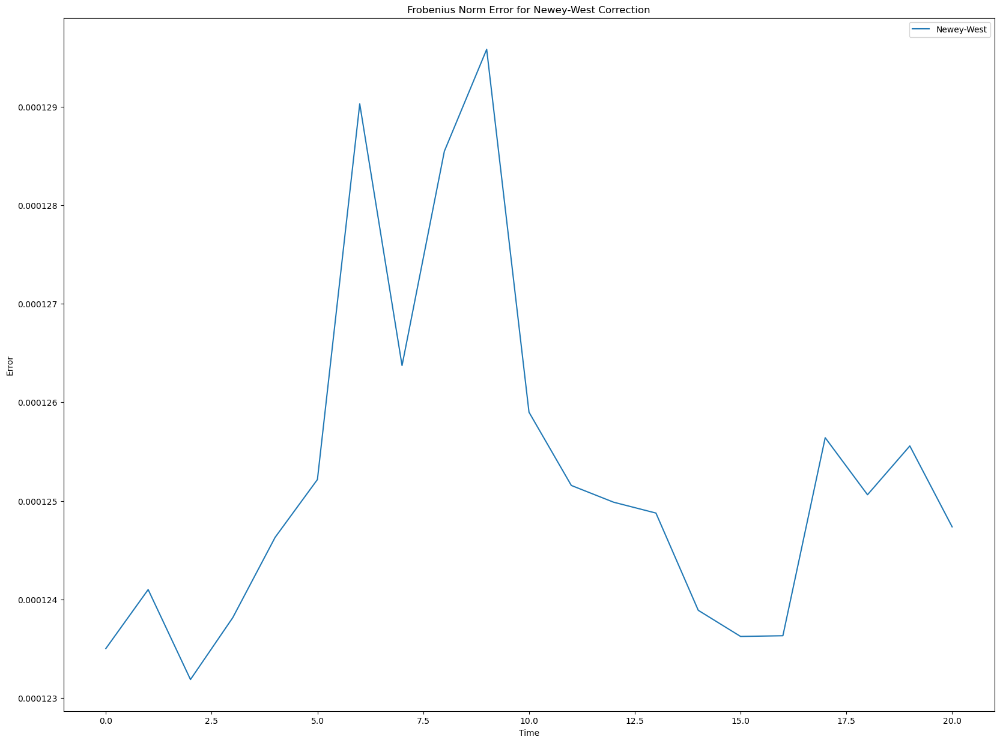

In [408]:
# Newey-West Correction
lmax = lb
newey_west_errs = []
factors = dates_assets_factors[low_turnover_factors + high_turnover_factors]
for date_idx in tqdm(range(len(dates_assets_factors)-22, len(dates_assets_factors)-1)):
    
    lagged_rets = []
    for lag in range(1, lmax+1):
        lagged_rets.append(np.array(factors.iloc[date_idx-lb-lag:date_idx-lag, :]))
    
    cur_factor_rets = factors.iloc[date_idx-lb:date_idx, :]
    new_cov = cur_factor_rets.cov()
    cur_factor_rets = np.array(cur_factor_rets)
    for lag in range(1, lmax+1):
        C_I = np.zeros((9, 9))
        for i in range(9):
            for j in range(9):
                C_I[i, j] = np.cov(np.stack([cur_factor_rets[:, i], lagged_rets[lag-1][:, j]], axis=0))[0, 1]
        new_cov += 0.5*(1-lag/lmax)*(C_I + C_I.T)
        
    newey_west_errs.append(np.linalg.norm(true_covar - new_cov))
    
plt.figure(figsize=(20,15))
plt.plot(newey_west_errs, label='Newey-West')
plt.xlabel('Time')
plt.ylabel('Error')
plt.legend()
plt.title('Frobenius Norm Error for Newey-West Correction')
plt.plot()  

We see that Newey-West correction performs slightly worse than shrinkage methods and slightly better than using raw covariance estimates from our factor model.